In [1]:
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os.path
from os import path
import glob
import math
%run ona_utils.ipynb

# Data Loading

In [2]:
records = pd.read_csv('./Ona KEMRI/kemri_rdt.csv')

In [3]:
DATA_PATH = './Ona KEMRI/patient_images'
img_files = []
for i, x in records[['baseEntityId', 'rdt_capture']].iterrows():
    file = '%s/%s/%s.jpg'%(DATA_PATH, x['baseEntityId'], x['rdt_capture'])
    if not path.exists(file):
        file = '%s/%s/%s.JPEG'%(DATA_PATH, x['baseEntityId'], x['rdt_capture'])
        
    #print(file)
    img_files.append(file)
        
records['full_img_file_path'] = img_files

# Load Configs 

In [ ]:
cs_proc = ImageProcessor('carestart')
exp_proc = ImageProcessor('experimental')

# Define evaluation function

In [ ]:
black_list = [
    'ab1b5da2-59f2-4e39-b0ee-3721423228b3.JPEG',
    '0453193c-6d68-4907-8c04-03af7454f71c.JPEG',
    '100a1da6-5538-4427-ae80-57431aeed8d4.JPEG',
    'b5f3316b-c8d3-4c0a-86a2-dc6af25e9398.JPEG',
    'af238f83-8fca-4760-9fec-3ce8bf3e1551.JPEG',
    'c8b31936-8e14-4de8-944a-cb54ae66b766.JPEG',
    '92ace07d-bc1d-41b9-8906-1af4b85c84dd.JPEG',
    '2e2b0aa9-80e8-4e1c-8202-6f919ae3d465.JPEG',
    '9f09a099-81ca-42e6-891a-d75de7d50de0.JPEG',
    'fa621d36-ed7a-4eb7-bd35-087af01946a2.JPEG',
    '691f2304-80b2-4817-b8fd-f94fee750f5d.JPEG',
    '5c34b83a-080d-4496-8279-1798ce253bb9.JPEG',
    '4103446f-344d-4c1a-9cf6-aea2f2a0c4f9.JPEG',
    '518a2418-a4c7-4f24-9a6e-8325c52fec39.JPEG',
    'b8cf33ba-4132-44d8-86f8-3dfc0a76a29d.JPEG',
    '26200e68-1501-43c1-836c-6f7a81ee4816.jpg',
    'e6b07912-c1d4-431d-9a69-a1eff78a155a.jpg',
    'af54328d-790b-46ec-9ce5-75f9f3694a86.JPEG',
    '39aeb9a7-269f-4898-ac46-27e89bff7158.JPEG',
    '6cea4615-a836-4c7f-baf0-90011471cf78.JPEG', #defect
    '04bfd0a0-b908-4203-a7ca-e9d3535074f5.JPEG',
    '0ebaec25-285c-4430-ad2e-7a97105de967.JPEG',
    'a0b52d23-353a-45cf-b600-94e9a57facb0.JPEG',
    '50f804f3-ee06-4c62-a291-4a9808b7dc4d.JPEG',
    '3d1473db-1d25-4cbb-825e-5a392ed7e989.JPEG',
    '8c785101-87a8-4e1d-b0ff-b1b835165cc5.JPEG',
    '4c11dbf7-966e-46f3-bf79-2b7525288989.JPEG',
    '776fa568-9566-46b5-a033-11a25752fd12.JPEG',
    'babbc5c6-0e23-432a-8859-06d2cc77d0ba.JPEG',
    ]

def eval(thres):
    pv_results = []
    pf_results = []
    blood_ratio_results = []
    clip_count_results = []
    
    no_imgs = {'carestart':[], 'experimental':[], 'none':[]}
    
    cs_proc.config['CONTROL_INTENSITY_PEAK_THRESHOLD'] = thres
    exp_proc.config['CONTROL_INTENSITY_PEAK_THRESHOLD'] = thres
    
    for index, r in records.iterrows():
        print('path', index, r['full_img_file_path'], r['rdt_type'])
        
        # if file doesn't exist, skip this image
        # if images are included in the black_list, skip this image
        if r['rdt_capture_duration'] == 0 or \
        not path.exists(r['full_img_file_path']) or not '.' in r['full_img_file_path'] \
        or r['full_img_file_path'].split('/')[-1] in black_list:
            if pd.isna(r['rdt_type']):
                r['rdt_type'] = 'none'
            no_imgs[r['rdt_type']].append([r['full_img_file_path']])
            pv_results.append(None)
            pf_results.append(None)
            blood_ratio_results.append(None)
            clip_count_results.append(None)
            print('Image does not exist')
            continue
    
        # read image
        img = cv2.imread(r['full_img_file_path'])
        img = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)
        
        proc = cs_proc if r['rdt_type'] == 'carestart' else exp_proc
        
        # detect RDT and get boundary of the RDT
        boundary = proc.detectRDT(img)
        
        # use the boundary to intepret RDT
        results, blood_percentage, clip_count, _, _, _, _ = proc.interpretResult(img, boundary)
        
        print(results , [True, r['parasite_type']], blood_percentage, clip_count[0])
        
        # aggregate all the results
        blood_ratio_results.append(blood_percentage)
        clip_count_results.append(clip_count[0])
        pv_results.append(results[1])
        pf_results.append(results[2])
    
    # append results to the csv columns
    records['clip_count'] = clip_count_results
    records['glare'] = records['clip_count'].apply(lambda x: x > 100)
    records['blood_percentage'] = blood_ratio_results
    records['blood'] = records['blood_percentage'].apply(lambda x: x> 0.25)
    records['algo_pv'] = pv_results
    records['algo_pf'] = pf_results
    
    records['is_pos'] = records.apply(lambda x: True if r['chw_result'] == 'TRUE' else False, axis=1)
    records['algo_pos'] = records.apply(lambda x: x['algo_pv'] or x['algo_pf'], axis=1)
    
    return records

# Run evaluation

path 0 ./Ona KEMRI/patient_images/0f370ae5-e9d3-4c58-bb2c-9aebfdcc823b/cb62faa9-adee-4060-951a-1e3413b9de9b.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


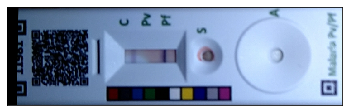

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


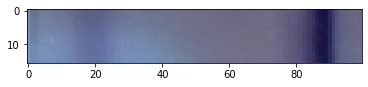

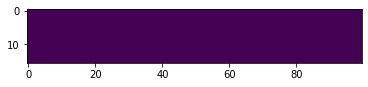

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [12.]


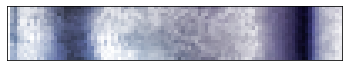

(16, 100, 3)


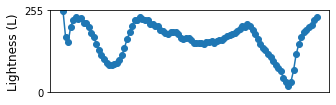

Max [[  2.     100.       4.    ]
 [ 18.     172.4375  18.    ]
 [ 55.     104.1875   1.    ]
 [ 88.     235.375   26.    ]]
[True, True, True] [True, 'pf'] 0.0 12.0
path 1 ./Ona KEMRI/patient_images/15830300-ea62-4e30-8c80-a757d5684f1e/6b4bbd97-4cec-4a8e-ad5c-197f2f613974.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


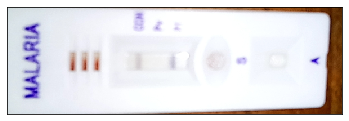

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


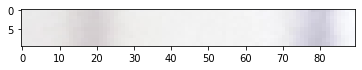

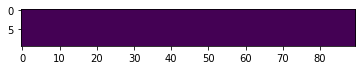

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [9.]


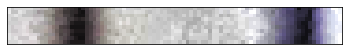

(10, 90, 3)


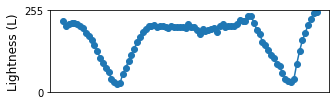

Max [[ 19.  231.9  27. ]
 [ 80.  225.4  22. ]]
[True, False, True] [True, 'pf'] 0.0 9.0
path 2 ./Ona KEMRI/patient_images/0f370ae5-e9d3-4c58-bb2c-9aebfdcc823b/274adb15-297e-4b13-95e7-e1530bb5bbe2.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


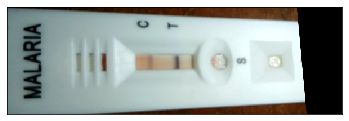

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


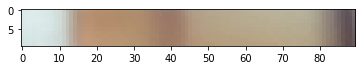

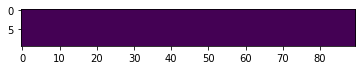

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [5.]


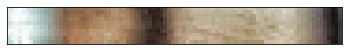

(10, 90, 3)


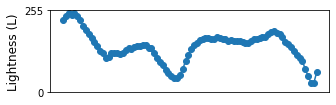

Max [[ 39.  213.2  22. ]]
[False, True, False] [True, 'pf'] 0.0 5.0
path 3 ./Ona KEMRI/patient_images/c75a64ed-eefc-4653-bf3d-75f4b00e2f5f/398194a0-4dbb-4270-a959-ab5dcd344402.JPEG carestart
Image does not exist
path 4 ./Ona KEMRI/patient_images/2f40f3d2-dd43-4943-8c48-d4ea1ba00392/c96882b9-4fa3-4c17-a41a-726a219a57f3.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


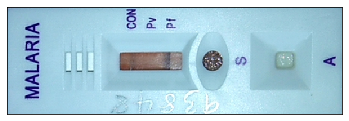

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


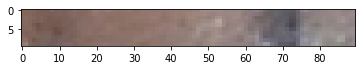

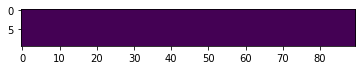

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [4.]


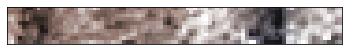

(10, 90, 3)


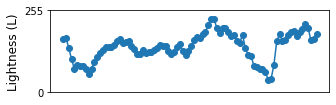

Max [[  9.  197.9   9. ]
 [ 72.  216.9  12. ]]
[True, False, True] [True, 'pf'] 0.0 4.0
path 5 ./Ona KEMRI/patient_images/91a2072b-46d3-4de0-b4c4-428e5a65e3f3/5ae64df0-7004-4da9-9ef4-662fe6ce133b.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


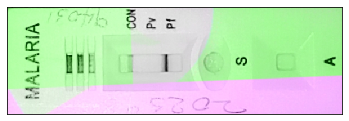

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


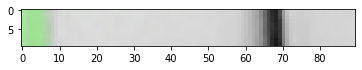

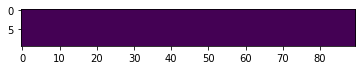

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


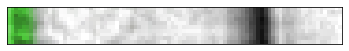

(10, 90, 3)


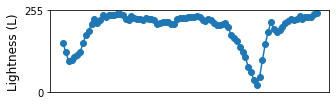

Max [[  2.  159.7  10. ]
 [ 68.  234.4  15. ]]
[True, False, True] [True, 'pf'] 0.0 20.0
path 6 ./Ona KEMRI/patient_images/91a2072b-46d3-4de0-b4c4-428e5a65e3f3/738a9115-920c-48a8-a1db-38821f72a5d9.jpg experimental
Image does not exist
path 7 ./Ona KEMRI/patient_images/d9e792e6-b629-44b4-9b18-3a2291bd9cf8/d30fde8c-a354-4277-864d-428c6cc81ad4.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


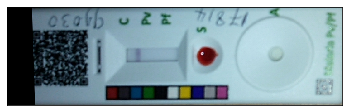

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


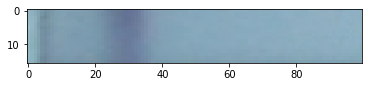

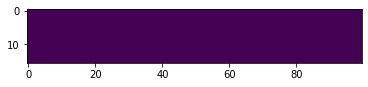

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [6.]


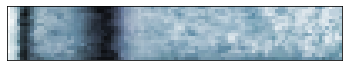

(16, 100, 3)


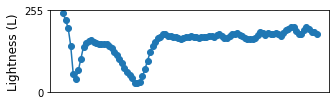

Max [[  5.     214.125   10.    ]
 [ 29.     228.3125  21.    ]]
[True, False, False] [True, nan] 0.0 6.0
path 8 ./Ona KEMRI/patient_images/d9e792e6-b629-44b4-9b18-3a2291bd9cf8/cd1c4ec6-a9ca-4de4-867a-684df710c994.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


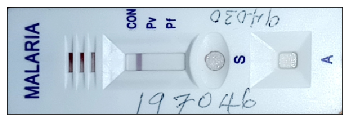

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


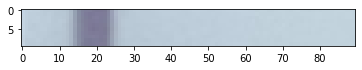

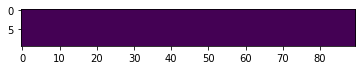

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [47.]


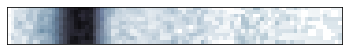

(10, 90, 3)


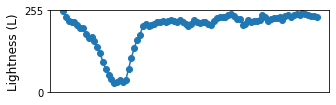

Max [[ 18.  227.7   9. ]]
[True, False, False] [True, nan] 0.0 47.0
path 9 ./Ona KEMRI/patient_images/65d74fac-f58b-4a32-a06f-8278cf5ceabe/nan.JPEG nan
Image does not exist
path 10 ./Ona KEMRI/patient_images/65d74fac-f58b-4a32-a06f-8278cf5ceabe/bb94dbc6-5e56-471f-b464-bae8021e5cba.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


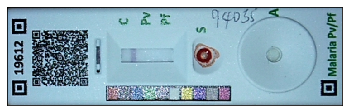

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


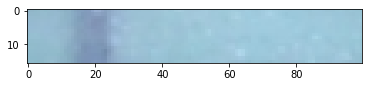

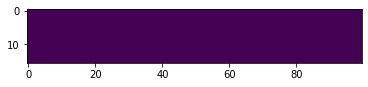

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [3.]


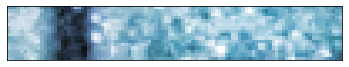

(16, 100, 3)


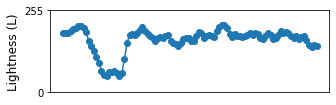

Max [[ 17.     204.5625  12.    ]
 [ 45.     112.6875   7.    ]]
[True, True, False] [True, nan] 0.0 3.0
path 11 ./Ona KEMRI/patient_images/65d74fac-f58b-4a32-a06f-8278cf5ceabe/853df978-e440-44fa-ba17-b0342e1532c0.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


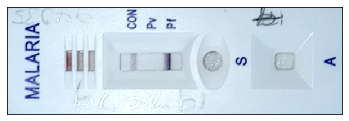

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


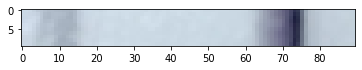

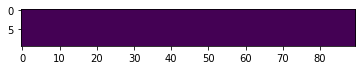

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [31.]


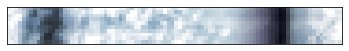

(10, 90, 3)


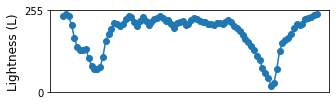

Max [[ 11.  184.5   9. ]
 [ 73.  235.9  23. ]]
[True, False, True] [True, 'pf'] 0.0 31.0
path 12 ./Ona KEMRI/patient_images/2ab814ca-75f5-4191-ba77-312ac2beb97e/7be5396a-99e1-45aa-8aeb-2cd861577fa7.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


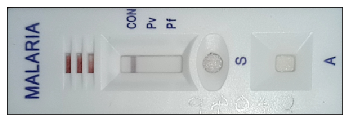

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


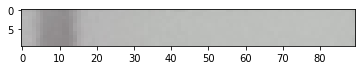

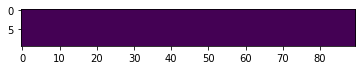

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


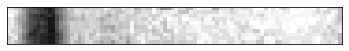

(10, 90, 3)


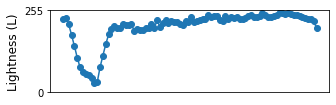

Max [[ 11.  228.6  16. ]]
[True, False, False] [True, nan] 0.0 46.0
path 13 ./Ona KEMRI/patient_images/2ab814ca-75f5-4191-ba77-312ac2beb97e/b3d523f2-280c-4416-a458-2a7c72173f3a.jpg experimental
Image does not exist
path 14 ./Ona KEMRI/patient_images/5f75d8c7-d0ca-4821-aa76-01cd7da411ec/a10c3d42-d6ab-4532-aacb-c55850ff31d5.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


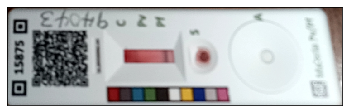

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


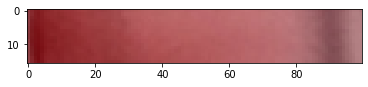

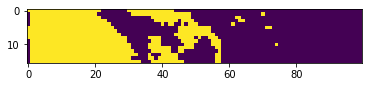

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [21.]


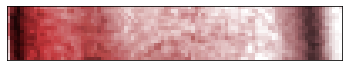

(16, 100, 3)


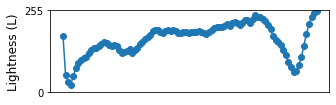

Max [[  3.   232.5   11.  ]
 [ 90.   193.25  23.  ]]
[True, False, True] [True, 'pf'] 0.39125 21.0
path 15 ./Ona KEMRI/patient_images/5eec303b-5fad-4736-a4df-286dd51359bd/a4e4e75a-50ba-44aa-9b6c-b3d8f9ebf7c0.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


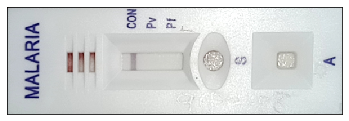

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


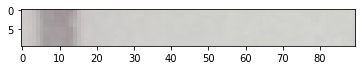

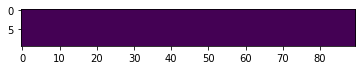

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [19.]


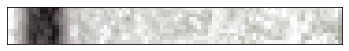

(10, 90, 3)


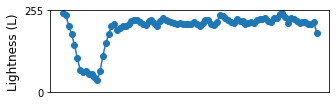

Max [[ 12.  219.4   7. ]]
[True, False, False] [True, nan] 0.0 19.0
path 16 ./Ona KEMRI/patient_images/5eec303b-5fad-4736-a4df-286dd51359bd/1b3fbadd-c858-4655-8616-566e25b06ceb.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


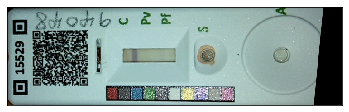

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


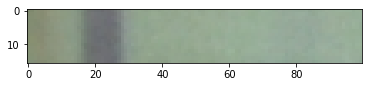

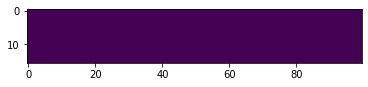

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [37.]


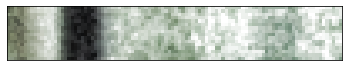

(16, 100, 3)


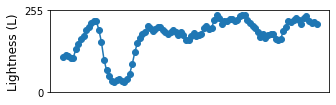

Max [[  3.    150.375  10.   ]
 [ 24.    225.5    10.   ]
 [ 84.     93.625   6.   ]]
[True, False, True] [True, nan] 0.0 37.0
path 17 ./Ona KEMRI/patient_images/36b7ad54-80a2-4663-ad0f-349623e50e62/769ae571-8190-4103-a104-31249923757b.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


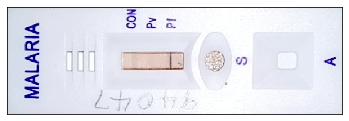

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


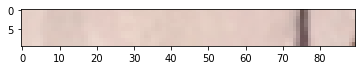

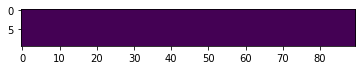

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [38.]


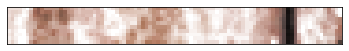

(10, 90, 3)


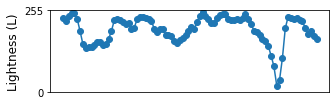

Max [[  8.  118.1   4. ]
 [ 40.  101.5  10. ]
 [ 75.  235.6  14. ]]
[True, True, True] [True, 'pf'] 0.0 38.0
path 18 ./Ona KEMRI/patient_images/36b7ad54-80a2-4663-ad0f-349623e50e62/9a4e9312-49c9-4fbe-bb88-69339577e9d3.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


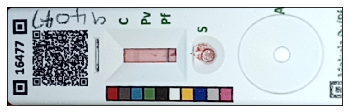

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


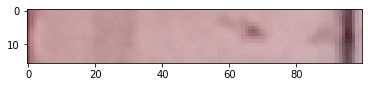

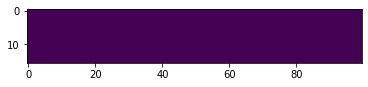

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [38.]


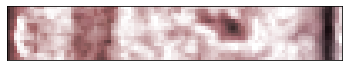

(16, 100, 3)


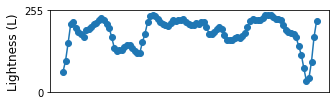

Max [[ 29.     133.125    9.    ]
 [ 65.      94.5625   6.    ]
 [ 95.     221.1875  14.    ]]
[False, False, True] [True, 'pf'] 0.0 38.0
path 19 ./Ona KEMRI/patient_images/270f5ff8-ed94-466a-99b2-046a04defe0b/c3458fd9-3a51-4141-8261-5e1649e28e8d.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


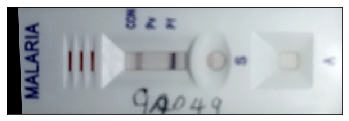

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


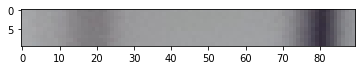

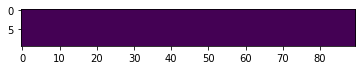

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [39.]


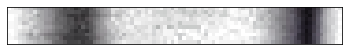

(10, 90, 3)


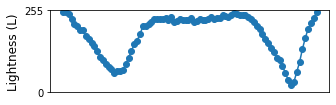

Max [[ 18.  194.9  18. ]
 [ 80.  232.5  24. ]]
[True, False, True] [True, 'pf'] 0.0 39.0
path 20 ./Ona KEMRI/patient_images/270f5ff8-ed94-466a-99b2-046a04defe0b/9c9a1878-93f5-4da4-ab80-ffa3bd49ad0c.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


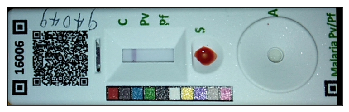

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


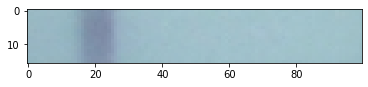

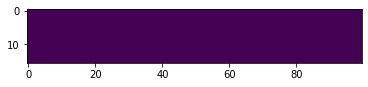

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [5.]


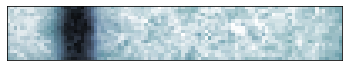

(16, 100, 3)


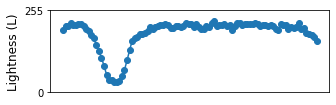

Max [[ 21.     225.8125  27.    ]]
[True, False, False] [True, nan] 0.0 5.0
path 21 ./Ona KEMRI/patient_images/f4b80c03-9d59-44f6-906b-517c19bcb7b5/b8c2387a-29c2-4dd9-8db4-0af8fa450e57.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


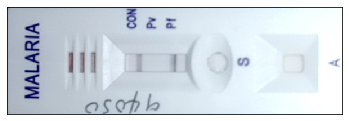

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


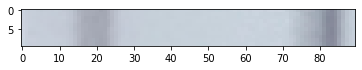

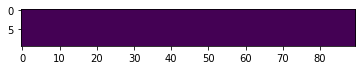

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [29.]


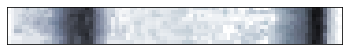

(10, 90, 3)


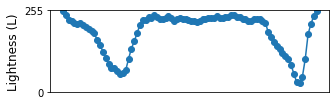

Max [[ 20.  198.6   9. ]
 [ 83.  227.2  19. ]]
[True, False, True] [True, 'pf'] 0.0 29.0
path 22 ./Ona KEMRI/patient_images/f4b80c03-9d59-44f6-906b-517c19bcb7b5/e6b07912-c1d4-431d-9a69-a1eff78a155a.jpg experimental
Image does not exist
path 23 ./Ona KEMRI/patient_images/0a2dcf2f-1c9f-450c-ab02-670ff407b535/abbbacb7-be01-45cc-b3b8-1d92c3a308ac.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


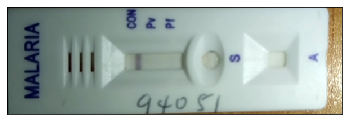

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


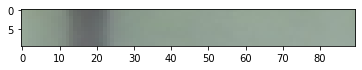

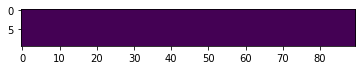

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [68.]


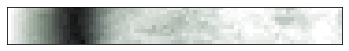

(10, 90, 3)


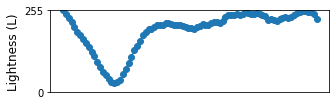

Max [[ 18.  227.9  32. ]]
[True, False, False] [True, 'pf'] 0.0 68.0
path 24 ./Ona KEMRI/patient_images/db97ffe0-5e2a-4d0f-a2e3-17c0240d15bd/nan.JPEG nan
Image does not exist
path 25 ./Ona KEMRI/patient_images/db97ffe0-5e2a-4d0f-a2e3-17c0240d15bd/76a5fc1d-1e51-4871-8f51-91928b7398c0.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


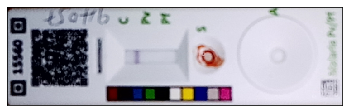

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


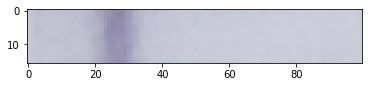

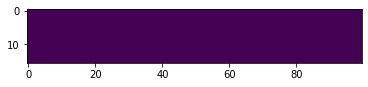

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [89.]


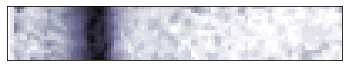

(16, 100, 3)


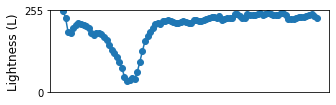

Max [[ 25.     221.3125  12.    ]]
[True, False, False] [True, nan] 0.0 89.0
path 26 ./Ona KEMRI/patient_images/db97ffe0-5e2a-4d0f-a2e3-17c0240d15bd/026cc1f8-e696-4fc8-9f18-0fbec00a248a.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


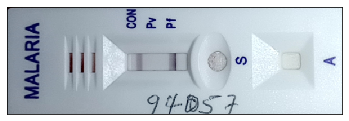

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


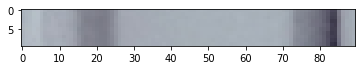

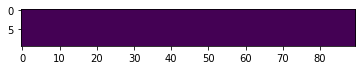

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [14.]


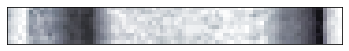

(10, 90, 3)


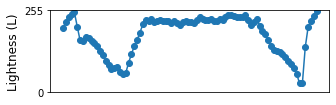

Max [[ 21.  200.2   9. ]
 [ 83.  228.2  20. ]]
[True, False, True] [True, 'pf'] 0.0 14.0
path 27 ./Ona KEMRI/patient_images/0a2dcf2f-1c9f-450c-ab02-670ff407b535/d5a4095b-4a8d-48f6-97fd-6bca02e088ed.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


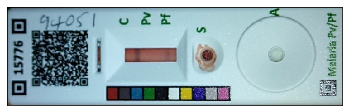

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


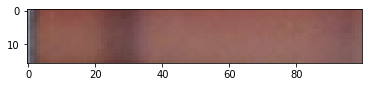

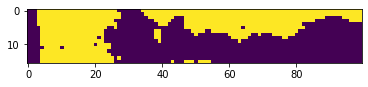

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [1.]


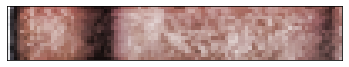

(16, 100, 3)


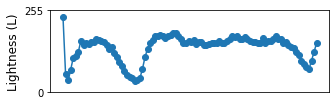

Max [[  2.     219.5625   6.    ]
 [ 28.     222.5625  18.    ]
 [ 96.     184.25    11.    ]]
[True, False, True] [True, 'pf'] 0.449375 1.0
path 28 ./Ona KEMRI/patient_images/0351921d-5fcf-477a-aabc-1f3b0a752dde/825cb03c-5a3d-4e8f-a9c5-6a29b202653a.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


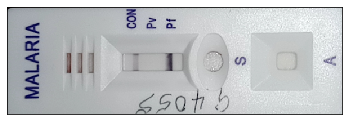

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


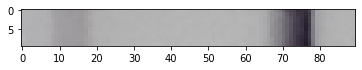

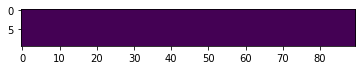

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [40.]


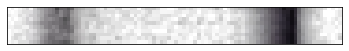

(10, 90, 3)


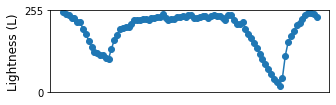

Max [[ 16.  151.4   7. ]
 [ 76.  236.4  23. ]]
[True, False, True] [True, 'pf'] 0.0 40.0
path 29 ./Ona KEMRI/patient_images/0351921d-5fcf-477a-aabc-1f3b0a752dde/bee4a6d3-eef2-4a3f-b508-b065064a9887.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


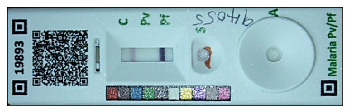

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


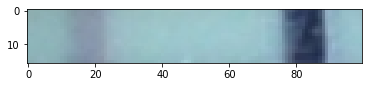

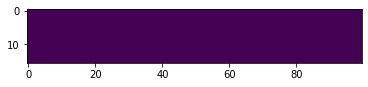

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [22.]


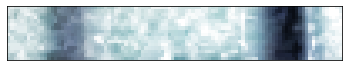

(16, 100, 3)


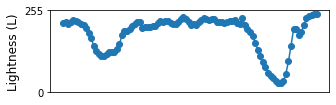

Max [[ 15.    142.625  25.   ]
 [ 85.    227.25   20.   ]]
[True, False, True] [True, 'pf'] 0.0 22.0
path 30 ./Ona KEMRI/patient_images/88c37c61-c4bf-4e53-a2c3-7aa4440b8b36/d3d1aeee-1662-412f-b1ff-9b66ece3a358.jpg experimental
Image does not exist
path 31 ./Ona KEMRI/patient_images/0d2edfcf-d8e9-4782-9109-4831ee057ebf/028508b0-7b22-43ca-89f6-87a0728a258f.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


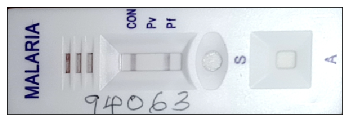

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


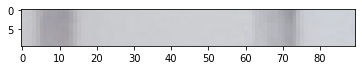

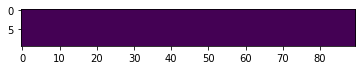

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [18.]


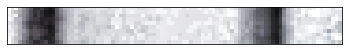

(10, 90, 3)


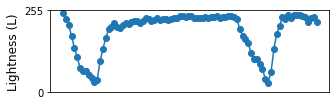

Max [[ 11.  225.1  17. ]
 [ 72.  226.6   8. ]]
[True, False, True] [True, 'pf'] 0.0 18.0
path 32 ./Ona KEMRI/patient_images/504962c1-379c-4182-ba63-117897488528/58886804-95c2-4810-8541-30da23cad408.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


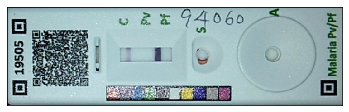

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


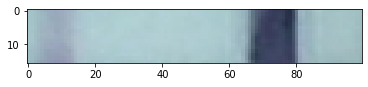

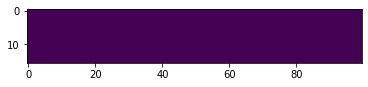

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


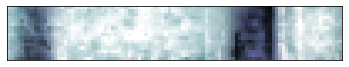

(16, 100, 3)


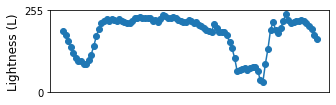

Max [[  8.    167.375   9.   ]
 [ 78.    225.125   6.   ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 33 ./Ona KEMRI/patient_images/d1441e23-88a7-478d-81f2-3d38dc0e1cbb/26200e68-1501-43c1-836c-6f7a81ee4816.jpg carestart
Image does not exist
path 34 ./Ona KEMRI/patient_images/0d2edfcf-d8e9-4782-9109-4831ee057ebf/4ce5eef6-4999-4595-af37-8b4a971b307b.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


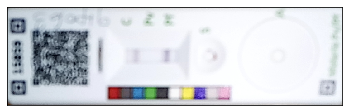

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


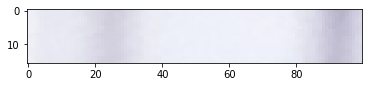

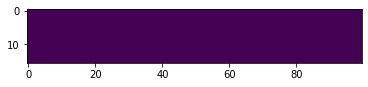

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [51.]


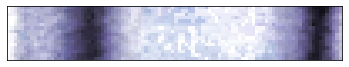

(16, 100, 3)


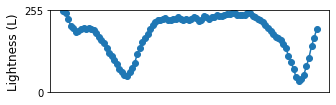

Max [[ 25.     204.3125  26.    ]
 [ 92.     220.3125  25.    ]]
[True, False, True] [True, 'pf'] 0.0 51.0
path 35 ./Ona KEMRI/patient_images/9d71527e-debe-473e-9907-161f1e1537b7/94d38286-e73a-4e77-a42b-e38e82cb3f82.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


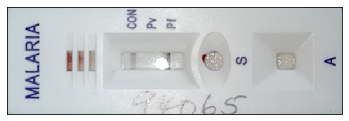

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


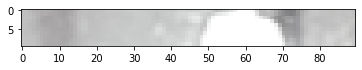

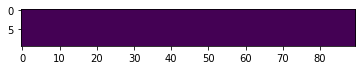

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [138.]


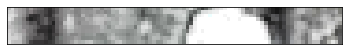

(10, 90, 3)


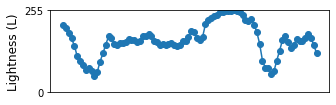

Max [[ 11.  207.1   6. ]
 [ 73.  198.3  11. ]]
[True, False, True] [True, 'pf'] 0.0 138.0
path 36 ./Ona KEMRI/patient_images/9d71527e-debe-473e-9907-161f1e1537b7/57075e93-206e-440d-843b-c0c1a7e99ba0.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


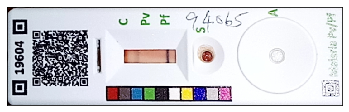

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


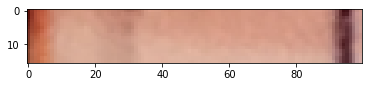

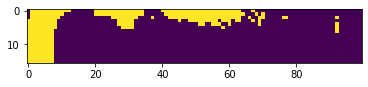

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [32.]


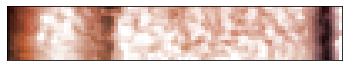

(16, 100, 3)


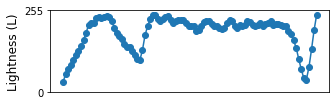

Max [[ 30.     155.625   17.    ]
 [ 95.     216.5625  14.    ]]
[False, False, True] [True, 'pf'] 0.18625 32.0
path 37 ./Ona KEMRI/patient_images/2ec64a3e-141f-464f-b085-74e30da3643f/04b668b2-98e6-4da8-b24e-91c4879226a4.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


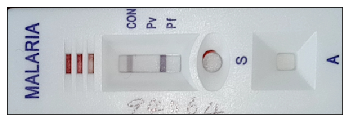

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


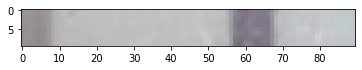

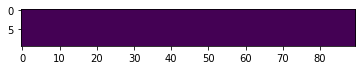

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [5.]


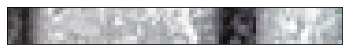

(10, 90, 3)


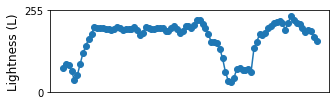

Max [[  4.  217.3   9. ]
 [ 59.  225.4   8. ]]
[True, True, False] [True, 'pf'] 0.0 5.0
path 38 ./Ona KEMRI/patient_images/2ec64a3e-141f-464f-b085-74e30da3643f/a882b901-0af6-42c6-8afc-8c04379bcee7.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


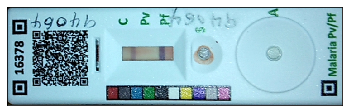

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


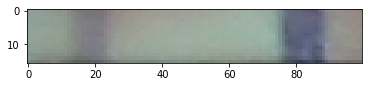

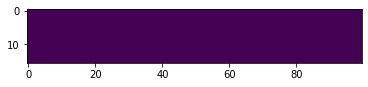

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [19.]


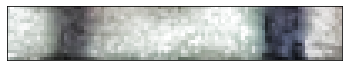

(16, 100, 3)


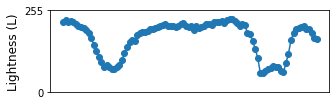

Max [[ 20.    183.625   9.   ]
 [ 78.    196.25   11.   ]]
[True, False, True] [True, 'pf'] 0.0 19.0
path 39 ./Ona KEMRI/patient_images/b283fc45-ac76-4958-bcbf-ae6a4403474b/d04dc4df-722a-42e2-b861-271044832fff.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


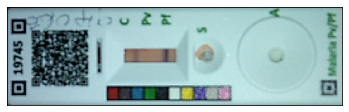

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


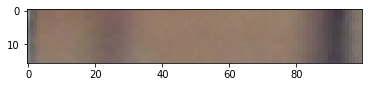

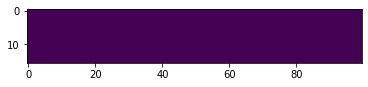

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [2.]


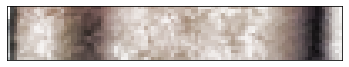

(16, 100, 3)


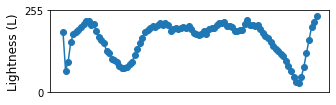

Max [[  1.     188.75     9.    ]
 [ 23.     180.875   22.    ]
 [ 92.     228.9375  22.    ]]
[True, False, True] [True, 'pf'] 0.0 2.0
path 40 ./Ona KEMRI/patient_images/b283fc45-ac76-4958-bcbf-ae6a4403474b/5b1d67db-b6b0-463c-8ad7-b98022b0cd5b.jpg carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


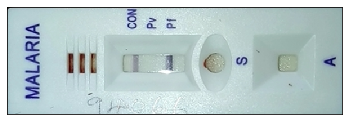

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


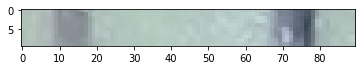

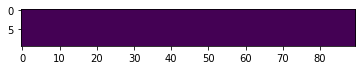

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [16.]


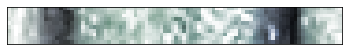

(10, 90, 3)


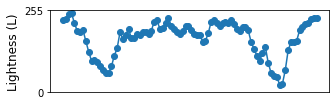

Max [[ 15.  195.7   8. ]
 [ 49.   98.3   8. ]
 [ 76.  232.3   8. ]]
[True, True, True] [True, 'pf'] 0.0 16.0
path 41 ./Ona KEMRI/patient_images/9104cea5-91af-4179-8c7f-6db212b6592c/8237f7b4-0fea-478e-ad00-2c299bf629b8.jpg experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


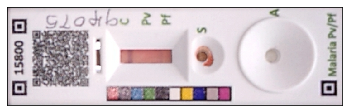

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


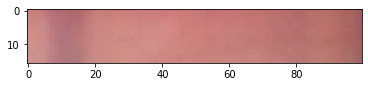

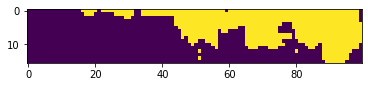

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


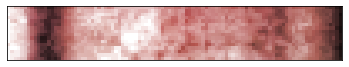

(16, 100, 3)


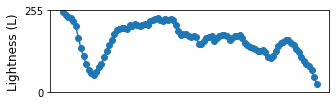

Max [[ 12.  203.5  23. ]]
[True, False, False] [True, 'pf'] 0.3875 28.0
path 42 ./Ona KEMRI/patient_images/9104cea5-91af-4179-8c7f-6db212b6592c/fb30c3e4-08c3-4794-957d-704fe5cadc0b.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


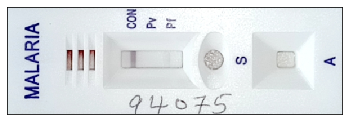

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


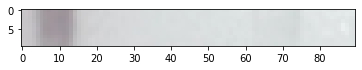

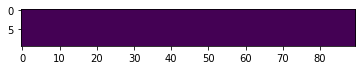

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [3.]


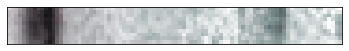

(10, 90, 3)


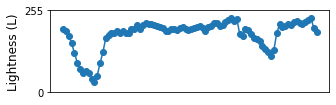

Max [[ 11.  225.9  10. ]
 [ 73.  141.7  11. ]]
[True, False, True] [True, 'pf'] 0.0 3.0
path 43 ./Ona KEMRI/patient_images/71fb4c28-ba53-4032-a150-50deae38e57a/158799de-da31-44c2-b1da-43dafc46eae3.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


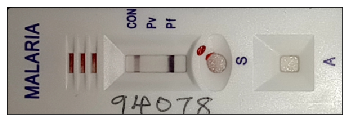

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


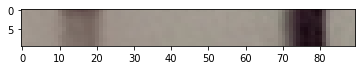

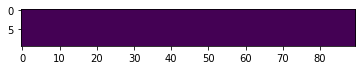

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [26.]


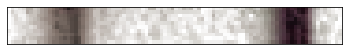

(10, 90, 3)


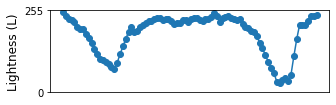

Max [[ 18.  184.5  23. ]
 [ 76.  228.1  15. ]]
[True, False, True] [True, 'pf'] 0.0 26.0
path 44 ./Ona KEMRI/patient_images/71fb4c28-ba53-4032-a150-50deae38e57a/9cc54b6d-34be-4e2c-855f-7c4353bcf066.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


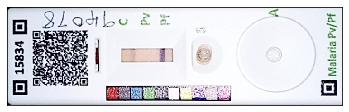

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


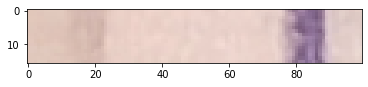

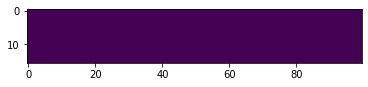

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [37.]


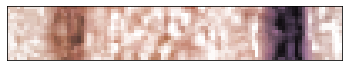

(16, 100, 3)


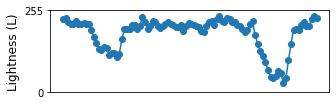

Max [[ 21.     144.875    4.    ]
 [ 86.     227.6875   6.    ]]
[True, False, True] [True, 'pf'] 0.0 37.0
path 45 ./Ona KEMRI/patient_images/9dc78930-530a-4076-a97b-97e444bd752e/9f2b9305-7bed-42fc-a418-5a3b409cd50c.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


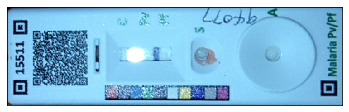

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


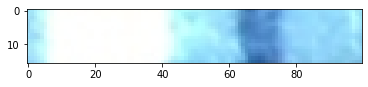

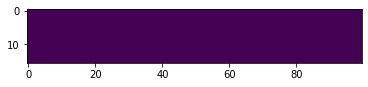

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [122.]


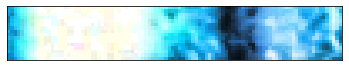

(16, 100, 3)


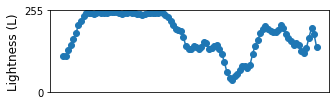

Max [[  1.     142.375    8.    ]
 [ 66.     219.4375   9.    ]
 [ 94.     134.25     5.    ]]
[False, False, True] [True, 'pf'] 0.0 122.0
path 46 ./Ona KEMRI/patient_images/9dc78930-530a-4076-a97b-97e444bd752e/74a01b32-b0fb-4d62-81a5-c3edf5e941ff.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


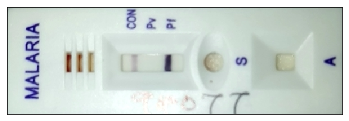

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


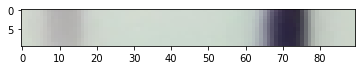

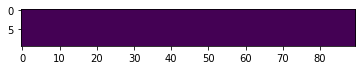

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [59.]


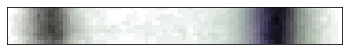

(10, 90, 3)


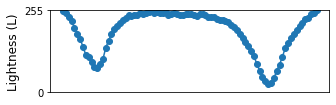

Max [[ 12.  180.5  22. ]
 [ 72.  230.2  36. ]]
[True, False, True] [True, 'pf'] 0.0 59.0
path 47 ./Ona KEMRI/patient_images/828d74fe-8c51-47a9-8664-d1892537113e/7294037f-3cfd-4c93-aef0-cef7f392b64d.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


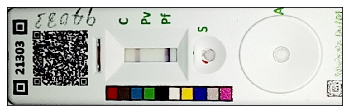

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


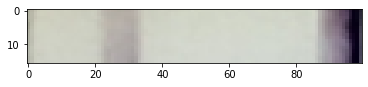

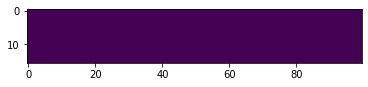

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [76.]


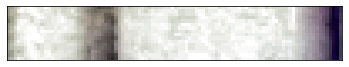

(16, 100, 3)


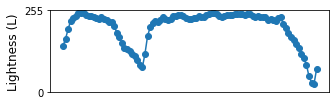

Max [[ 31.     177.8125  20.    ]]
[False, False, False] [True, 'pf'] 0.0 76.0
path 48 ./Ona KEMRI/patient_images/828d74fe-8c51-47a9-8664-d1892537113e/6da2684d-c963-4aa0-93c9-14b19a7da97d.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


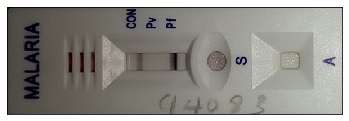

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


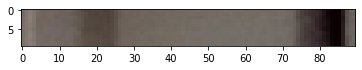

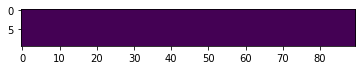

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [7.]


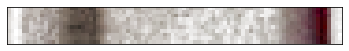

(10, 90, 3)


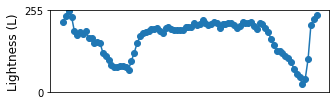

Max [[ 23.  185.3  11. ]
 [ 84.  230.5  19. ]]
[True, False, True] [True, 'pf'] 0.0 7.0
path 49 ./Ona KEMRI/patient_images/607a68b6-00f8-4c72-b1aa-ee103983d92b/67e55e9e-2d8f-45aa-83b6-356397f512b1.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


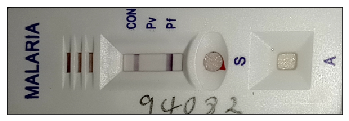

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


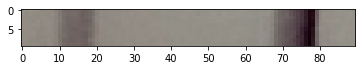

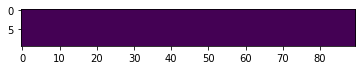

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [32.]


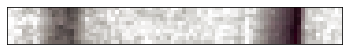

(10, 90, 3)


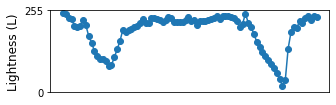

Max [[ 16.  172.8  13. ]
 [ 77.  235.6  16. ]]
[True, False, True] [True, 'pf'] 0.0 32.0
path 50 ./Ona KEMRI/patient_images/607a68b6-00f8-4c72-b1aa-ee103983d92b/198483d4-af9f-42e1-bae9-1c26a9500899.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


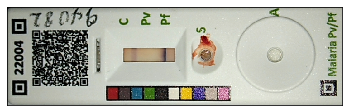

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


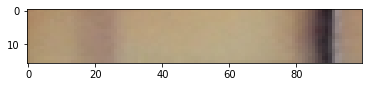

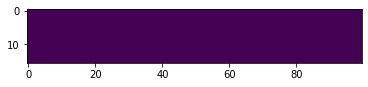

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


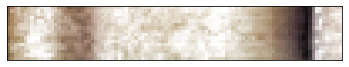

(16, 100, 3)


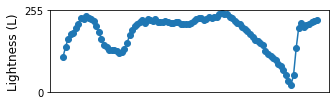

Max [[ 22.     135.      21.    ]
 [ 89.     234.1875  30.    ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 51 ./Ona KEMRI/patient_images/7a10efcc-457e-4dbc-a1a7-f42c1fe2d36d/cc037806-feb0-46f9-9007-4a8e20e030e6.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


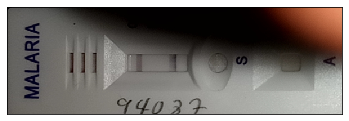

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


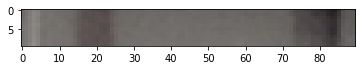

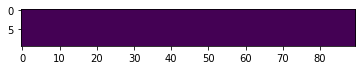

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [9.]


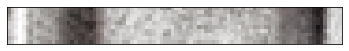

(10, 90, 3)


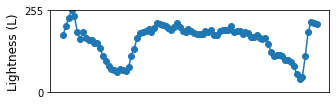

Max [[ 19.  193.4   7. ]
 [ 83.  216.    7. ]]
[True, False, True] [True, 'pf'] 0.0 9.0
path 52 ./Ona KEMRI/patient_images/7a10efcc-457e-4dbc-a1a7-f42c1fe2d36d/8a7e803f-6411-4710-b8c0-c057e9370492.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


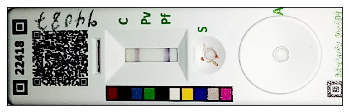

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


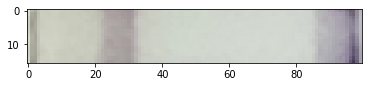

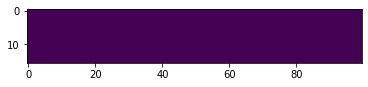

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [51.]


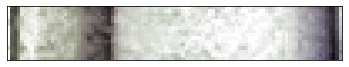

(16, 100, 3)


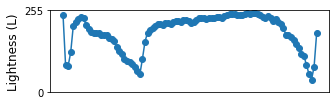

Max [[  2.     174.125    6.    ]
 [ 30.     200.625   21.    ]
 [ 97.     217.1875  15.    ]]
[True, False, True] [True, 'pf'] 0.0 51.0
path 53 ./Ona KEMRI/patient_images/b666eadb-d62c-4c23-ae00-9855299722d9/aa94d90c-0b06-455f-a0ce-6c792188dbd1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


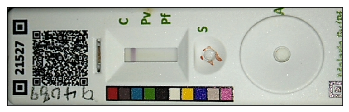

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


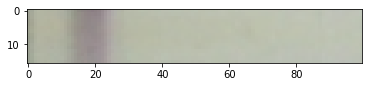

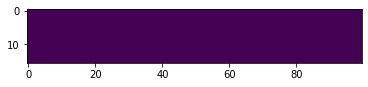

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [17.]


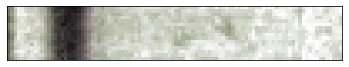

(16, 100, 3)


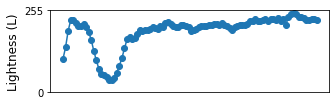

Max [[ 18.     216.8125  17.    ]]
[True, False, False] [True, nan] 0.0 17.0
path 54 ./Ona KEMRI/patient_images/ed50ea6a-99d8-4735-857a-345bbb9039fe/a296adaa-bbe6-4319-ad66-d081a4f760c6.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


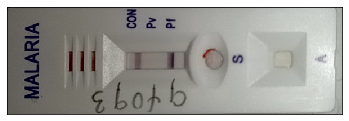

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


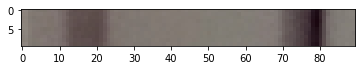

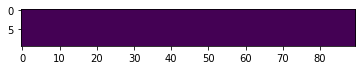

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [26.]


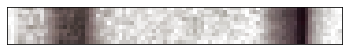

(10, 90, 3)


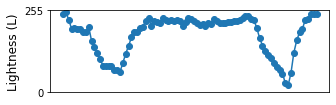

Max [[ 20.  192.7  12. ]
 [ 79.  235.   23. ]]
[True, False, True] [True, 'pf'] 0.0 26.0
path 55 ./Ona KEMRI/patient_images/ed50ea6a-99d8-4735-857a-345bbb9039fe/5ff36d44-a93f-4b8b-8818-6a7d166b7061.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


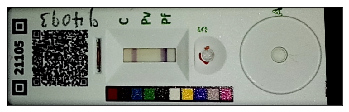

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


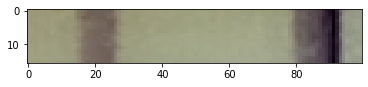

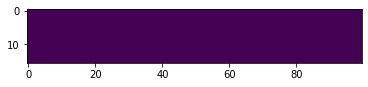

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [60.]


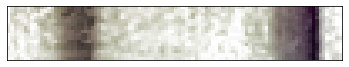

(16, 100, 3)


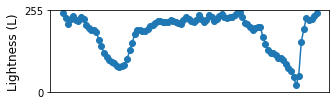

Max [[ 22.     178.75    17.    ]
 [ 91.     235.1875  12.    ]]
[True, False, True] [True, 'pf'] 0.0 60.0
path 56 ./Ona KEMRI/patient_images/e908ce1d-4228-4a78-84cb-cf00ddd36aa9/99ac5a8c-1b6c-48b1-a8a7-60d5e4baba23.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


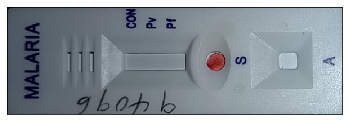

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


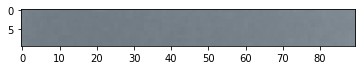

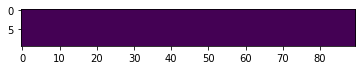

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [7.]


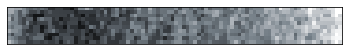

(10, 90, 3)


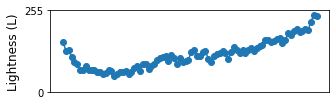

Max [[ 18. 205.   3.]]
[True, False, False] [True, nan] 0.0 7.0
path 57 ./Ona KEMRI/patient_images/26a3366e-59f4-4cac-9808-b748b3000576/3ac900fc-e175-4fb6-b4c2-e89497d8216f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


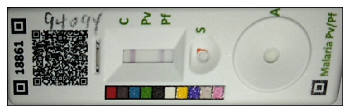

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


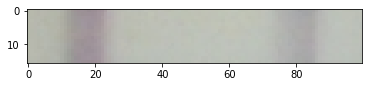

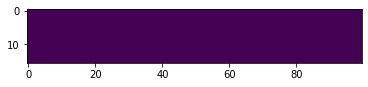

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [40.]


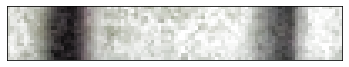

(16, 100, 3)


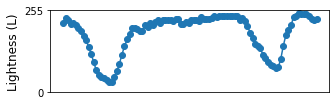

Max [[ 18.     225.375   23.    ]
 [ 83.     180.0625  21.    ]]
[True, False, True] [True, 'pf'] 0.0 40.0
path 58 ./Ona KEMRI/patient_images/26a3366e-59f4-4cac-9808-b748b3000576/012638bd-a01c-43c0-a5ab-0dc18ed5fde8.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


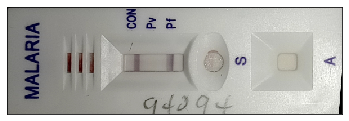

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


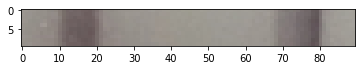

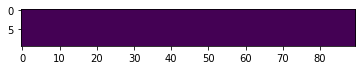

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [24.]


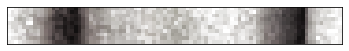

(10, 90, 3)


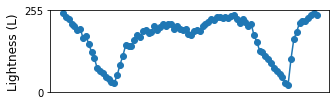

Max [[ 18.  226.8  13. ]
 [ 79.  232.4  21. ]]
[True, False, True] [True, 'pf'] 0.0 24.0
path 59 ./Ona KEMRI/patient_images/e908ce1d-4228-4a78-84cb-cf00ddd36aa9/ac373893-8f2f-4f2c-b8e1-593879937bff.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


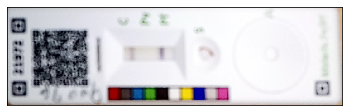

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


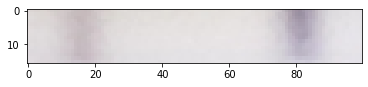

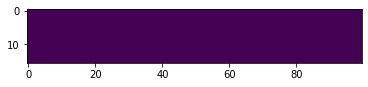

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [73.]


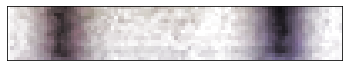

(16, 100, 3)


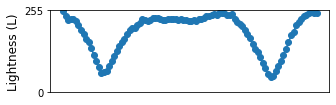

Max [[ 15.    195.5    26.   ]
 [ 81.    208.375  30.   ]]
[True, False, True] [True, 'pf'] 0.0 73.0
path 60 ./Ona KEMRI/patient_images/2ca3e9bc-8232-4ee0-9c0c-1d58afd23007/99cfdc47-5af3-4004-bc83-25d97d97a95b.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


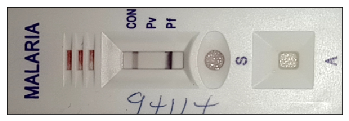

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


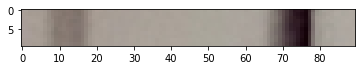

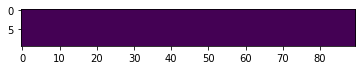

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


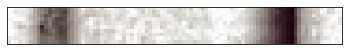

(10, 90, 3)


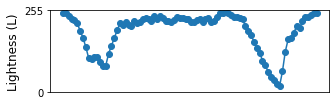

Max [[ 14.  175.7   7. ]
 [ 76.  237.   24. ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 61 ./Ona KEMRI/patient_images/2ca3e9bc-8232-4ee0-9c0c-1d58afd23007/d0a0484a-c25b-4a7b-92a8-1383863096d0.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


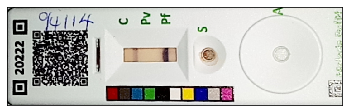

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


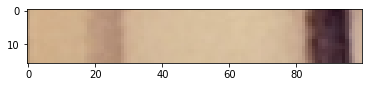

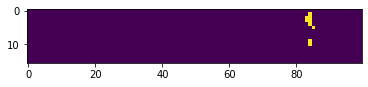

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [44.]


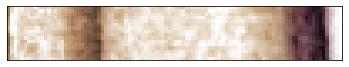

(16, 100, 3)


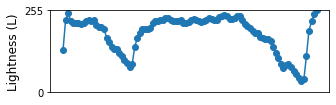

Max [[ 26.     176.0625  15.    ]
 [ 93.     221.1875  10.    ]]
[True, False, True] [True, 'pf'] 0.005625 44.0
path 62 ./Ona KEMRI/patient_images/6f301319-390a-4f95-9e11-ae9ed48f6a17/e92242a3-4668-4408-a299-517de9a4cfd4.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


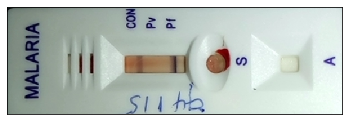

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


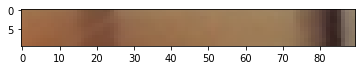

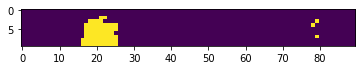

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [29.]


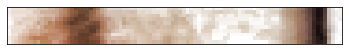

(10, 90, 3)


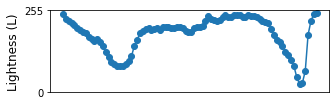

Max [[ 19.  175.3   6. ]
 [ 83.  231.   23. ]]
[True, False, True] [True, 'pf'] 0.07111111111111111 29.0
path 63 ./Ona KEMRI/patient_images/6f301319-390a-4f95-9e11-ae9ed48f6a17/b8cf33ba-4132-44d8-86f8-3dfc0a76a29d.JPEG experimental
Image does not exist
path 64 ./Ona KEMRI/patient_images/90b56902-fb2c-4060-9d00-cfe3eb989004/d9680312-cfe3-408f-9fb8-ea11360c5d89.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


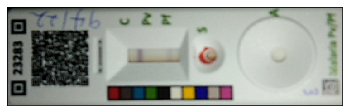

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


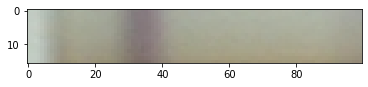

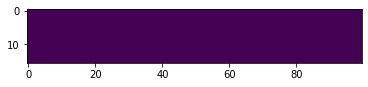

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


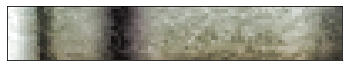

(16, 100, 3)


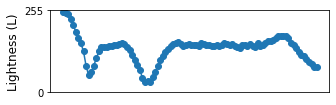

Max [[ 10.    204.     17.   ]
 [ 34.    225.125  11.   ]]
[True, False, False] [True, 'pf'] 0.0 15.0
path 65 ./Ona KEMRI/patient_images/90b56902-fb2c-4060-9d00-cfe3eb989004/518a2418-a4c7-4f24-9a6e-8325c52fec39.JPEG carestart
Image does not exist
path 66 ./Ona KEMRI/patient_images/df791664-4ebe-4506-9aa7-7cf24fa97b55/0453193c-6d68-4907-8c04-03af7454f71c.JPEG experimental
Image does not exist
path 67 ./Ona KEMRI/patient_images/df791664-4ebe-4506-9aa7-7cf24fa97b55/792776c5-a5c4-4266-86bf-d94810068958.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


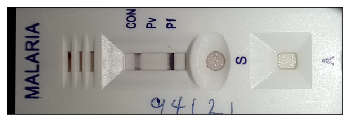

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


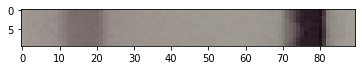

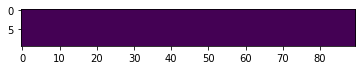

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [31.]


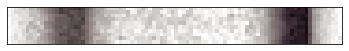

(10, 90, 3)


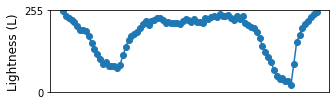

Max [[ 19.  179.1  10. ]
 [ 80.  232.6  11. ]]
[True, False, True] [True, 'pf'] 0.0 31.0
path 68 ./Ona KEMRI/patient_images/f08fc734-bfa4-4df3-89d4-7d576464790d/3bb1dbb0-ac47-4785-abfc-87d99bc4f4d1.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


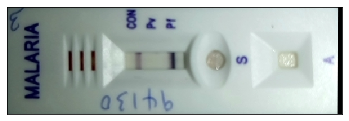

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


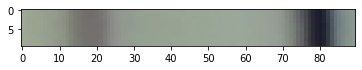

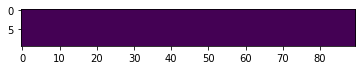

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [42.]


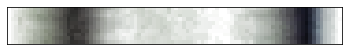

(10, 90, 3)


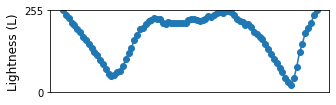

Max [[ 17.  204.3  31. ]
 [ 80.  233.5  23. ]]
[True, False, True] [True, 'pf'] 0.0 42.0
path 69 ./Ona KEMRI/patient_images/f08fc734-bfa4-4df3-89d4-7d576464790d/6d150da6-0328-482a-8be7-d27c124cee11.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


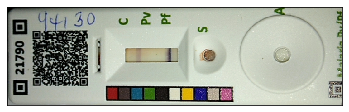

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


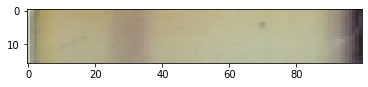

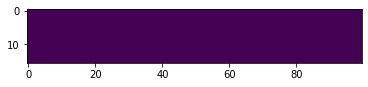

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [8.]


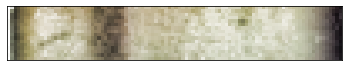

(16, 100, 3)


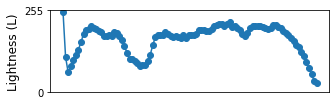

Max [[  2.     194.0625  10.    ]
 [ 30.     172.875   16.    ]]
[True, False, False] [True, 'pf'] 0.0 8.0
path 70 ./Ona KEMRI/patient_images/529684c4-af1c-45f7-876f-fe5610e3fc04/72c9dfa8-21aa-4d92-a8cb-31b92e0e5f0f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


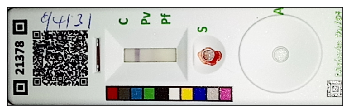

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


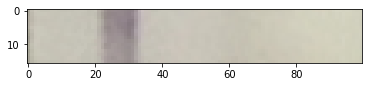

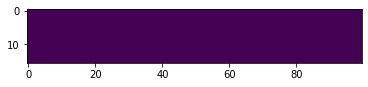

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [7.]


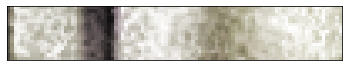

(16, 100, 3)


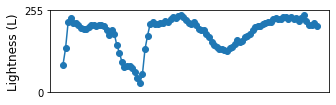

Max [[ 30.     227.0625   8.    ]
 [ 64.     126.       5.    ]]
[False, False, False] [True, nan] 0.0 7.0
path 71 ./Ona KEMRI/patient_images/529684c4-af1c-45f7-876f-fe5610e3fc04/eccf445d-6948-4d1c-90e4-8b481c662b38.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


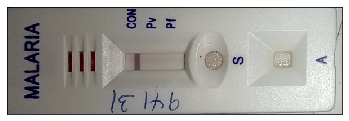

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


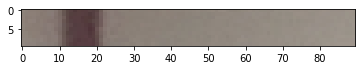

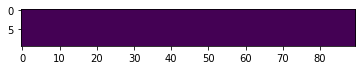

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [19.]


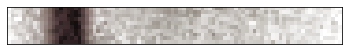

(10, 90, 3)


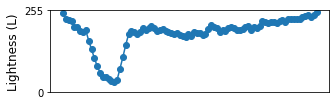

Max [[ 18.  225.3   8. ]]
[True, False, False] [True, nan] 0.0 19.0
path 72 ./Ona KEMRI/patient_images/e5656334-06e8-4c23-90dd-341b82c17024/ffc433ba-505d-4590-825e-1586bf425965.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


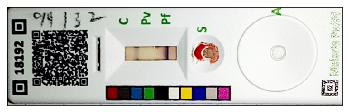

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


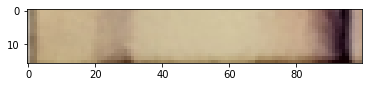

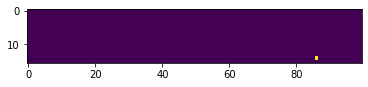

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [33.]


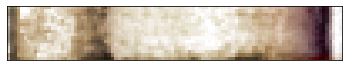

(16, 100, 3)


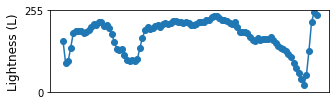

Max [[  1.    164.      5.   ]
 [ 28.    160.125   5.   ]
 [ 94.    232.875  16.   ]]
[True, False, True] [True, 'pf'] 0.000625 33.0
path 73 ./Ona KEMRI/patient_images/e5656334-06e8-4c23-90dd-341b82c17024/8c34c8d3-3ef6-4b36-946d-6539422c1652.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


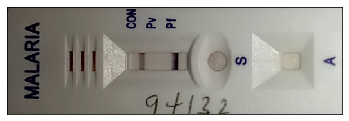

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


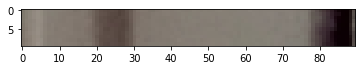

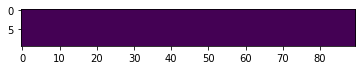

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [6.]


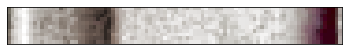

(10, 90, 3)


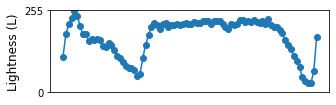

Max [[ 26. 207.   7.]
 [ 86. 228.  10.]]
[True, False, True] [True, 'pf'] 0.0 6.0
path 74 ./Ona KEMRI/patient_images/84da7d51-bb31-4338-bb10-871ff7eb8e9a/168df784-71a6-4ab8-8897-09a6cff370fa.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


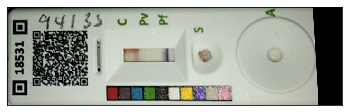

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


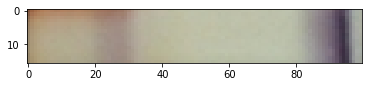

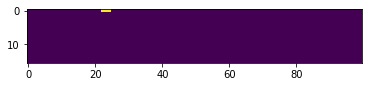

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [36.]


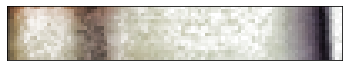

(16, 100, 3)


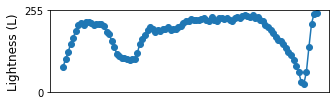

Max [[ 26.     154.0625  12.    ]
 [ 94.     230.5625  22.    ]]
[True, False, True] [True, 'pf'] 0.001875 36.0
path 75 ./Ona KEMRI/patient_images/84da7d51-bb31-4338-bb10-871ff7eb8e9a/2daa17b0-3b3a-4c86-b5b5-41846768a47f.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


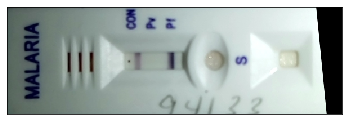

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


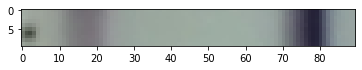

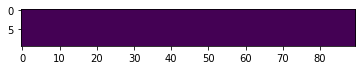

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [41.]


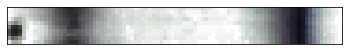

(10, 90, 3)


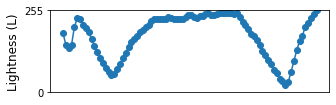

Max [[  2.  119.4   4. ]
 [ 17.  201.2  26. ]
 [ 78.  234.8  27. ]]
[True, False, True] [True, 'pf'] 0.0 41.0
path 76 ./Ona KEMRI/patient_images/584f3526-67e1-4333-8f0e-54f74926d7df/20a78c67-b44d-4064-987b-c6c39b89c202.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


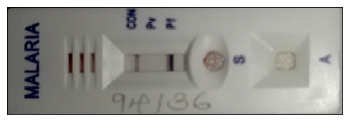

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


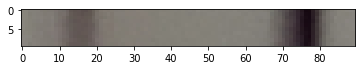

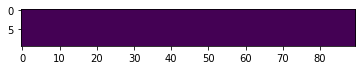

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


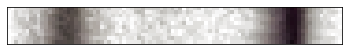

(10, 90, 3)


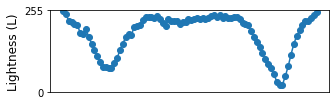

Max [[ 16. 182.  14.]
 [ 76. 233.  28.]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 77 ./Ona KEMRI/patient_images/584f3526-67e1-4333-8f0e-54f74926d7df/68b37bab-ac7c-4875-a994-2bb1ecebde79.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


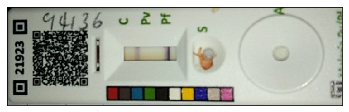

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


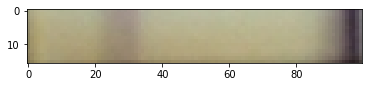

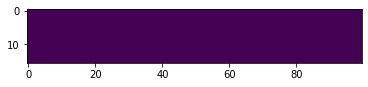

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [6.]


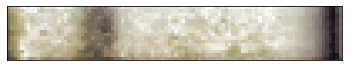

(16, 100, 3)


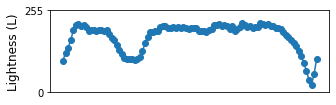

Max [[ 28.    154.625   6.   ]
 [ 97.    232.875  16.   ]]
[True, False, True] [True, 'pf'] 0.0 6.0
path 78 ./Ona KEMRI/patient_images/b1ef7ef1-b42d-40e8-890d-8de9a7691353/98ca9d0c-33bf-42e3-b3d6-aed39680be4b.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


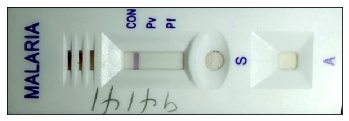

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


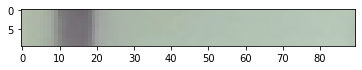

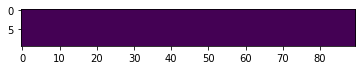

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [27.]


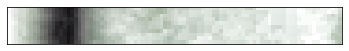

(10, 90, 3)


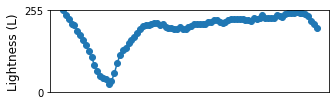

Max [[ 16.  230.4  31. ]]
[True, False, False] [True, nan] 0.0 27.0
path 79 ./Ona KEMRI/patient_images/725771de-fc11-41a2-b4d5-d9593d31f722/4491ccff-8711-465f-a9f2-07bc54c328b7.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


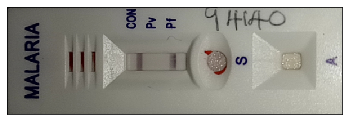

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


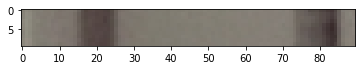

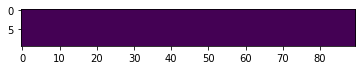

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [13.]


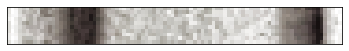

(10, 90, 3)


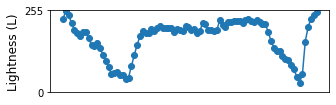

Max [[ 22.  215.5   8. ]
 [ 83.  227.1  17. ]]
[True, False, True] [True, 'pf'] 0.0 13.0
path 80 ./Ona KEMRI/patient_images/725771de-fc11-41a2-b4d5-d9593d31f722/e7ef5b7f-1dfd-441f-becf-90e1fa3e9a08.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


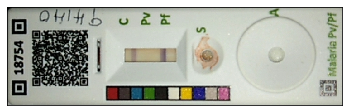

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


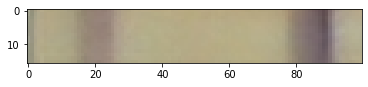

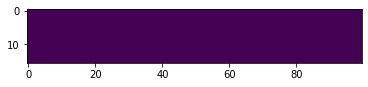

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [47.]


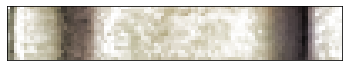

(16, 100, 3)


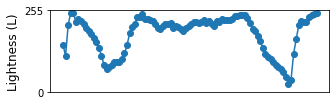

Max [[  1.     142.4375   2.    ]
 [ 17.     182.625   14.    ]
 [ 88.     230.875   22.    ]]
[True, False, True] [True, 'pf'] 0.0 47.0
path 81 ./Ona KEMRI/patient_images/b1ef7ef1-b42d-40e8-890d-8de9a7691353/fe0bee33-4da6-4e98-bf94-5fa7e329507a.JPEG experimental
Image does not exist
path 82 ./Ona KEMRI/patient_images/c99b50f2-fe32-4417-86a1-7e91d7be2dfb/9598fd07-b1e1-405c-b8b3-950f7e2f3907.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


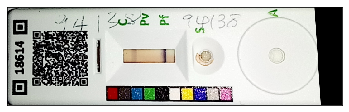

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


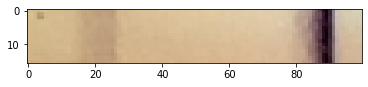

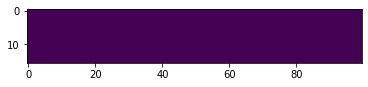

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [32.]


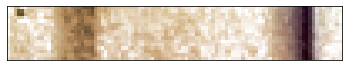

(16, 100, 3)


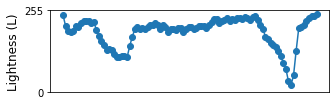

Max [[ 25.    147.625   5.   ]
 [ 89.    234.625  21.   ]]
[True, False, True] [True, 'pf'] 0.0 32.0
path 83 ./Ona KEMRI/patient_images/c99b50f2-fe32-4417-86a1-7e91d7be2dfb/5ad78558-7563-4937-8157-c388fedcfc19.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


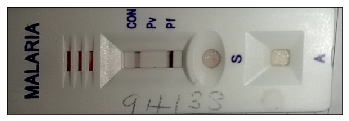

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


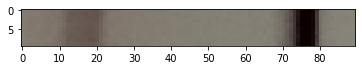

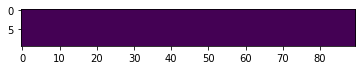

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [39.]


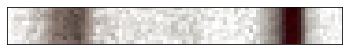

(10, 90, 3)


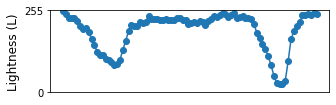

Max [[ 18.  170.1   9. ]
 [ 76.  230.3  18. ]]
[True, False, True] [True, 'pf'] 0.0 39.0
path 84 ./Ona KEMRI/patient_images/5407b2d8-5dc0-4cad-8d57-18cfc9419b5d/8a4757a1-f87f-4e4e-8b1f-6c8758f85348.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


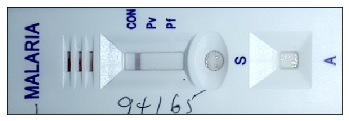

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


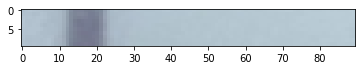

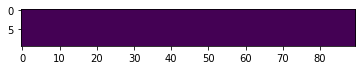

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [22.]


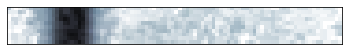

(10, 90, 3)


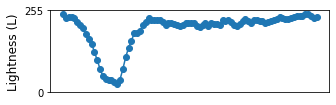

Max [[ 19. 230.  27.]]
[True, False, False] [True, nan] 0.0 22.0
path 85 ./Ona KEMRI/patient_images/f24b9683-9a8f-46d0-96c8-ed7a1d31a144/d6e1b777-d6c5-4146-82e0-78b005fc155f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


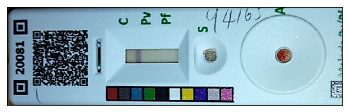

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


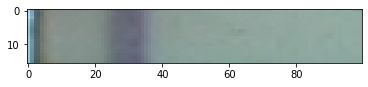

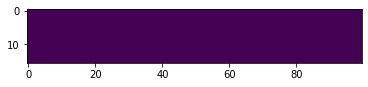

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [3.]


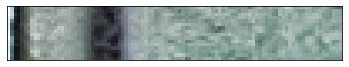

(16, 100, 3)


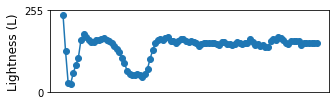

Max [[  3.     229.5      7.    ]
 [ 31.     207.5625   8.    ]]
[True, False, False] [True, nan] 0.0 3.0
path 86 ./Ona KEMRI/patient_images/180fc5ac-3dc0-4e80-879d-27beae0196ef/b828f547-7c2a-46fc-a567-014564b0fbe1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


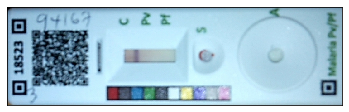

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


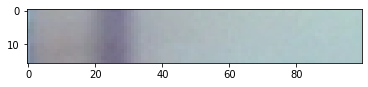

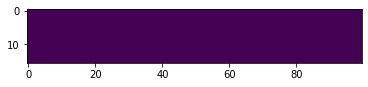

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


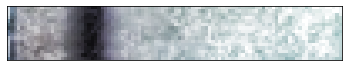

(16, 100, 3)


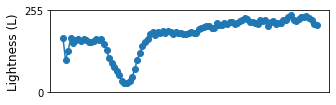

Max [[  1.     156.625    2.    ]
 [ 25.     226.8125  19.    ]]
[True, False, False] [True, nan] 0.0 20.0
path 87 ./Ona KEMRI/patient_images/180fc5ac-3dc0-4e80-879d-27beae0196ef/16d16e93-009d-4c6f-ab17-c0260f13125c.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


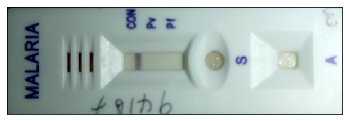

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


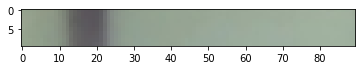

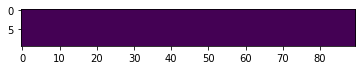

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


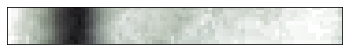

(10, 90, 3)


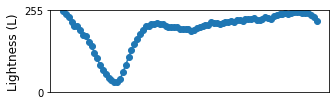

Max [[ 19. 224.  28.]]
[True, False, False] [True, nan] 0.0 28.0
path 88 ./Ona KEMRI/patient_images/1d41c592-7c73-4530-8f15-a6f1ccbaef1e/22af0967-f2a1-4f0a-8edb-e05ce35c1293.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


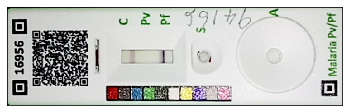

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


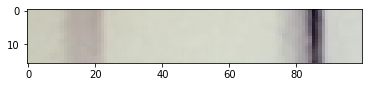

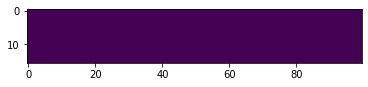

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [75.]


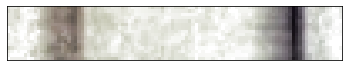

(16, 100, 3)


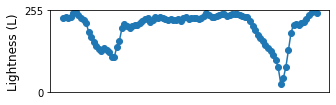

Max [[ 20.    146.375   7.   ]
 [ 85.    230.375  22.   ]]
[True, False, True] [True, 'pf'] 0.0 75.0
path 89 ./Ona KEMRI/patient_images/abffa418-29bc-4eaa-8214-48b1a5686c81/accd176c-73e4-4423-a113-70b3239c3f80.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


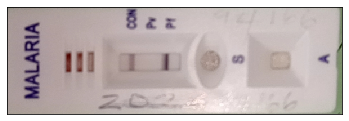

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


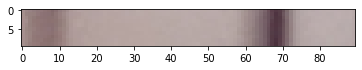

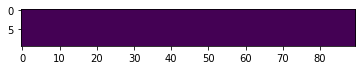

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


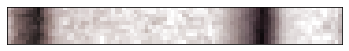

(10, 90, 3)


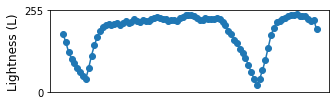

Max [[  8.  215.2  15. ]
 [ 68.  234.2  27. ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 90 ./Ona KEMRI/patient_images/50f14070-8150-45d7-b4e8-9221abd0fc8c/2a763609-b4e1-47dc-a857-1f31c22593d2.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


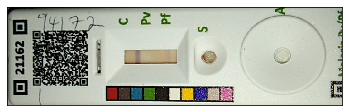

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


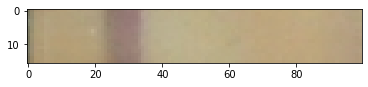

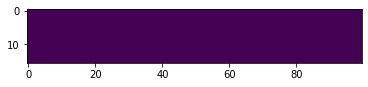

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [22.]


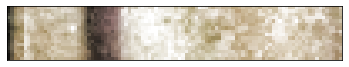

(16, 100, 3)


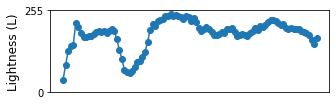

Max [[ 26.     196.9375  15.    ]]
[True, False, False] [True, 'pf'] 0.0 22.0
path 91 ./Ona KEMRI/patient_images/50f14070-8150-45d7-b4e8-9221abd0fc8c/a22e222f-9bcc-4fa6-9c2c-ee15d863b13b.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


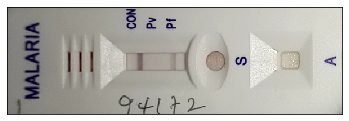

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


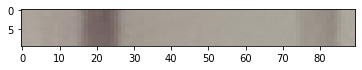

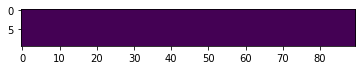

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [29.]


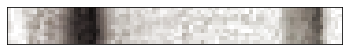

(10, 90, 3)


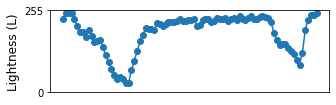

Max [[ 22.  227.7   8. ]
 [ 83.  169.7   8. ]]
[True, False, True] [True, 'pf'] 0.0 29.0
path 92 ./Ona KEMRI/patient_images/7080b0ec-9766-4157-9261-cc62c34d42fe/f6f29ea2-cb75-4a8b-89a0-f4575f7bf580.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


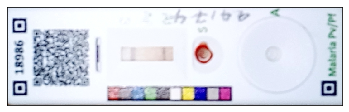

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


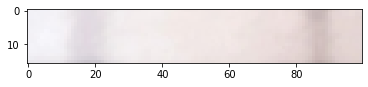

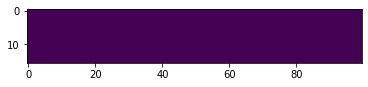

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [14.]


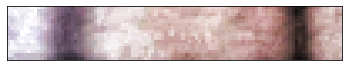

(16, 100, 3)


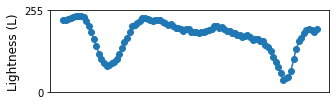

Max [[ 17.  175.   24. ]
 [ 86.  218.5  19. ]]
[True, False, True] [True, 'pf'] 0.0 14.0
path 93 ./Ona KEMRI/patient_images/2e3625fa-5d1d-46da-8f31-dd78faee8d57/6c0b67bc-d209-4cd0-a3e0-81c60ac00149.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


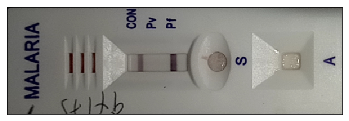

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


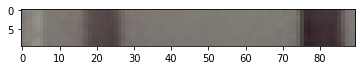

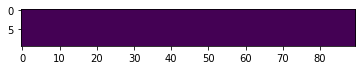

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [7.]


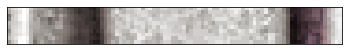

(10, 90, 3)


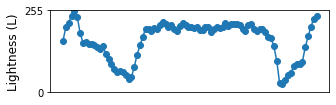

Max [[ 23.  214.7   8. ]
 [ 77.  232.   11. ]]
[True, False, True] [True, 'pf'] 0.0 7.0
path 94 ./Ona KEMRI/patient_images/7080b0ec-9766-4157-9261-cc62c34d42fe/e537b65c-1948-469a-8d2a-6b48d52953e9.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


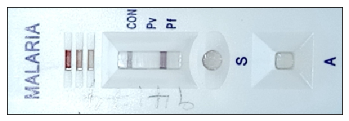

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


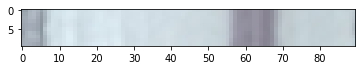

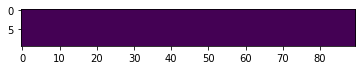

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [16.]


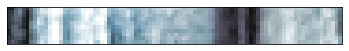

(10, 90, 3)


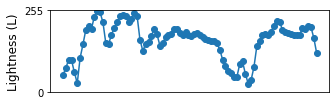

Max [[  5.  228.1   6. ]
 [ 16.  106.2   8. ]
 [ 28.  126.8   6. ]
 [ 65.  229.8   7. ]]
[True, False, False] [True, 'pf'] 0.0 16.0
path 95 ./Ona KEMRI/patient_images/bae782c1-ba74-409e-8b39-8a2dd57ce086/4103446f-344d-4c1a-9cf6-aea2f2a0c4f9.JPEG experimental
Image does not exist
path 96 ./Ona KEMRI/patient_images/bae782c1-ba74-409e-8b39-8a2dd57ce086/5c34b83a-080d-4496-8279-1798ce253bb9.JPEG carestart
Image does not exist
path 97 ./Ona KEMRI/patient_images/b6e71023-fbeb-4219-9ae8-236c614fd9af/7309c798-0699-45b2-aede-eeb6cae7055b.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


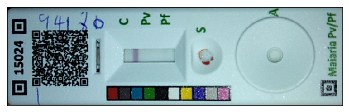

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


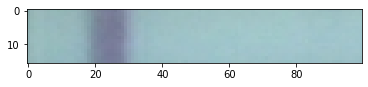

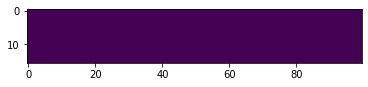

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [16.]


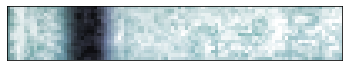

(16, 100, 3)


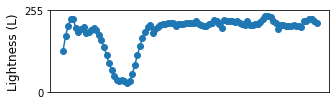

Max [[ 25.     227.6875  10.    ]]
[True, False, False] [True, 'pf'] 0.0 16.0
path 98 ./Ona KEMRI/patient_images/b6e71023-fbeb-4219-9ae8-236c614fd9af/a46c6b7d-d4a3-4df8-be42-99f5dd5c51f7.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


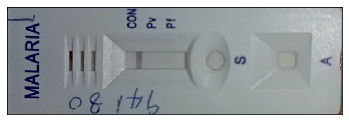

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


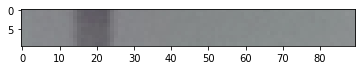

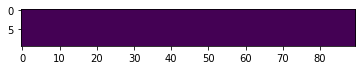

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [24.]


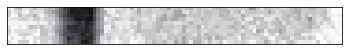

(10, 90, 3)


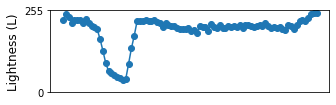

Max [[ 21.  218.9  17. ]]
[True, False, False] [True, 'pf'] 0.0 24.0
path 99 ./Ona KEMRI/patient_images/f2c4a4f9-2f96-46df-be66-ab3424ba852e/c09b749b-1ff9-4dc6-abda-654a620cd9da.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


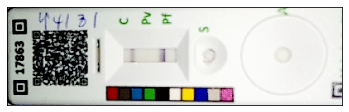

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


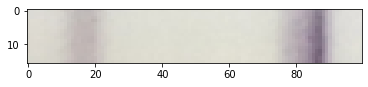

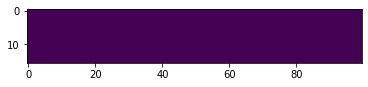

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [45.]


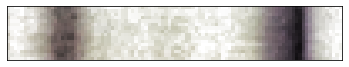

(16, 100, 3)


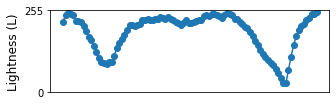

Max [[ 17.     166.625   23.    ]
 [ 87.     228.9375  30.    ]]
[True, False, True] [True, 'pf'] 0.0 45.0
path 100 ./Ona KEMRI/patient_images/f2c4a4f9-2f96-46df-be66-ab3424ba852e/f29500f1-429b-473b-9f9e-9badd14595a6.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


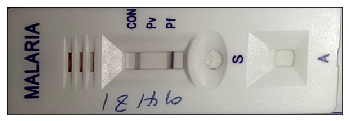

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


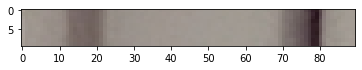

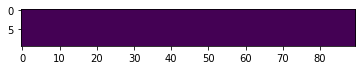

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [42.]


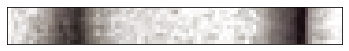

(10, 90, 3)


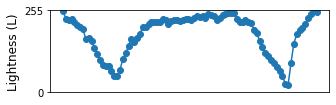

Max [[ 18.  205.8  14. ]
 [ 79.  232.5  23. ]]
[True, False, True] [True, 'pf'] 0.0 42.0
path 101 ./Ona KEMRI/patient_images/96706d8e-7a96-471c-8dd9-e1423f12fb7d/8b087299-6491-444a-acbf-05aec461e5f5.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


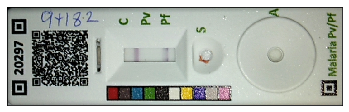

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


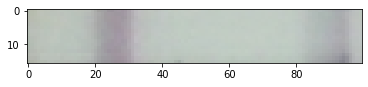

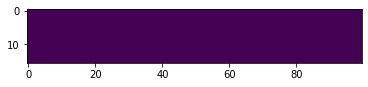

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


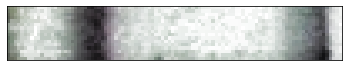

(16, 100, 3)


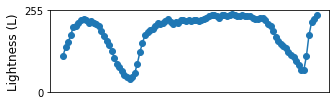

Max [[ 26.     215.8125  25.    ]
 [ 94.     186.625   21.    ]]
[True, False, True] [True, 'pf'] 0.0 20.0
path 102 ./Ona KEMRI/patient_images/96706d8e-7a96-471c-8dd9-e1423f12fb7d/74c0668b-be29-4f61-91a1-c89fd4771197.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


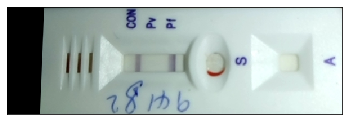

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


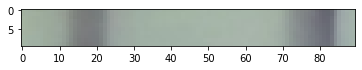

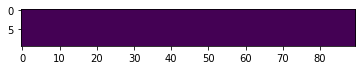

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [44.]


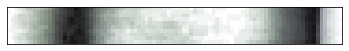

(10, 90, 3)


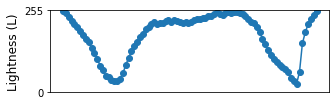

Max [[ 18.  222.4  31. ]
 [ 82.  229.2  28. ]]
[True, False, True] [True, 'pf'] 0.0 44.0
path 103 ./Ona KEMRI/patient_images/0f07af5d-c0e2-4a32-92aa-0569d698234e/c4386410-a245-431f-b40c-a082d2a100f3.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


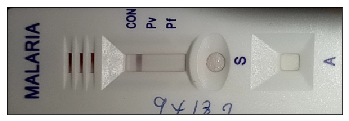

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


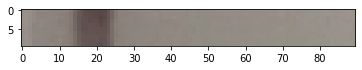

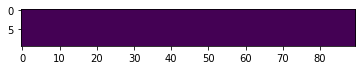

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [23.]


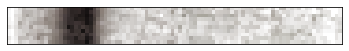

(10, 90, 3)


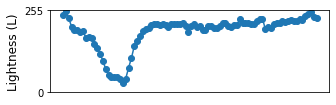

Max [[ 21.  226.3  22. ]]
[True, False, False] [True, nan] 0.0 23.0
path 104 ./Ona KEMRI/patient_images/ef358a26-085c-4c52-b2b4-4eed8a272533/3f37e13b-5451-4fcf-a49a-950065758e09.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


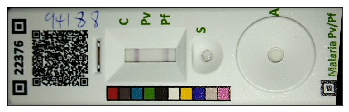

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


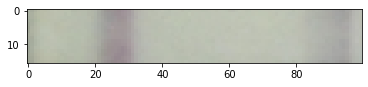

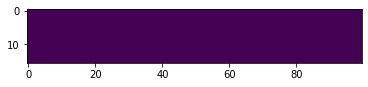

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [22.]


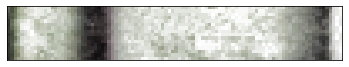

(16, 100, 3)


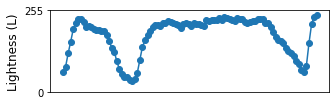

Max [[ 27.    220.375  20.   ]
 [ 94.    192.     21.   ]]
[True, False, True] [True, 'pf'] 0.0 22.0
path 105 ./Ona KEMRI/patient_images/ef358a26-085c-4c52-b2b4-4eed8a272533/9c89d25d-9bf1-4c0f-9f4f-ea765815d5a7.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


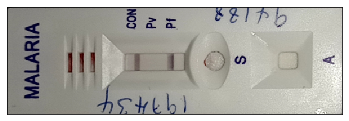

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


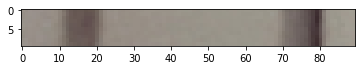

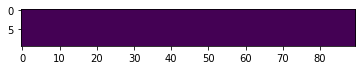

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


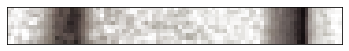

(10, 90, 3)


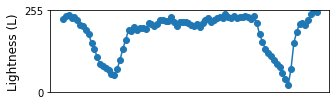

Max [[ 18.  201.1  18. ]
 [ 79.  235.   16. ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 106 ./Ona KEMRI/patient_images/0f07af5d-c0e2-4a32-92aa-0569d698234e/0f526f51-f4e3-4623-92d1-4369f62af935.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


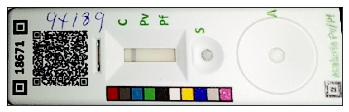

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


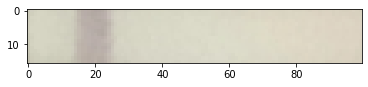

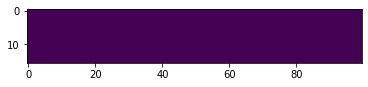

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [50.]


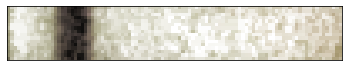

(16, 100, 3)


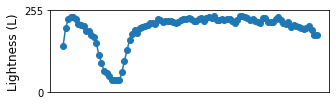

Max [[ 19.     218.5625  10.    ]]
[True, False, False] [True, nan] 0.0 50.0
path 107 ./Ona KEMRI/patient_images/26cba53d-4f63-474f-93ce-bcbcdf4646c8/3414bc4e-d8b2-4de8-8dbb-98f6101d329d.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


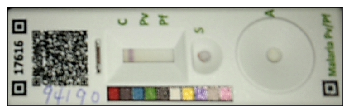

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


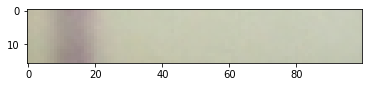

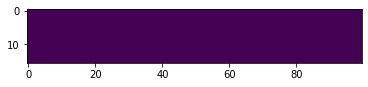

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [13.]


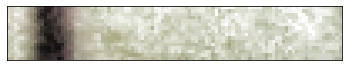

(16, 100, 3)


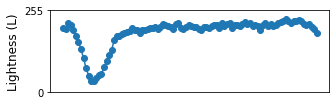

Max [[ 11. 222.  24.]]
[True, False, False] [True, nan] 0.0 13.0
path 108 ./Ona KEMRI/patient_images/26cba53d-4f63-474f-93ce-bcbcdf4646c8/a7b9ac08-e6eb-4f8f-9bf1-930877b4facd.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


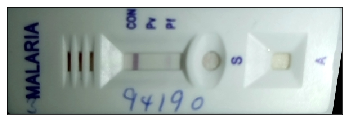

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


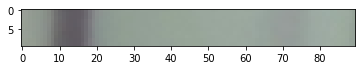

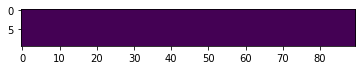

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [43.]


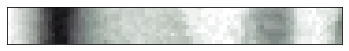

(10, 90, 3)


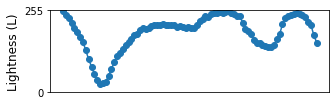

Max [[ 13.  231.3  27. ]
 [ 72.  115.1  19. ]]
[True, False, True] [True, 'pf'] 0.0 43.0
path 109 ./Ona KEMRI/patient_images/1525da02-dade-4659-bbe8-211d7f7f4af0/0dc1c18f-3e81-4417-ae4d-1bbf227a7d8f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


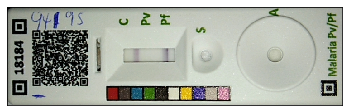

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


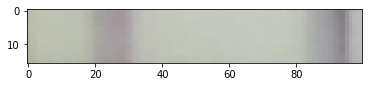

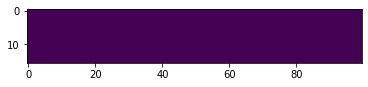

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [27.]


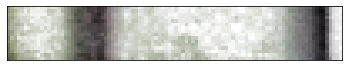

(16, 100, 3)


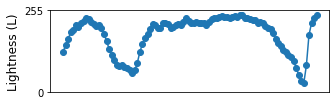

Max [[ 27.    195.625  11.   ]
 [ 94.    227.25   21.   ]]
[True, False, True] [True, 'pf'] 0.0 27.0
path 110 ./Ona KEMRI/patient_images/1525da02-dade-4659-bbe8-211d7f7f4af0/c482ac25-2a5e-49c0-bef9-d841e2e1c1e5.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


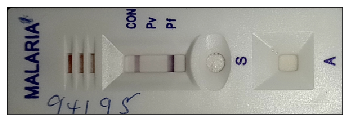

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


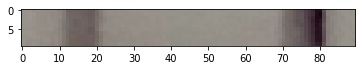

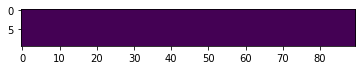

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [37.]


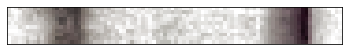

(10, 90, 3)


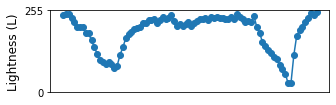

Max [[ 18.  180.2  15. ]
 [ 79.  228.1  19. ]]
[True, False, True] [True, 'pf'] 0.0 37.0
path 111 ./Ona KEMRI/patient_images/6913565e-d5bd-41f7-aaa5-b7fadeb6df4a/d01af300-93b5-487a-a87a-073155918ae5.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


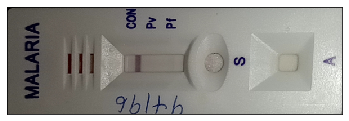

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


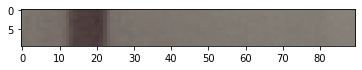

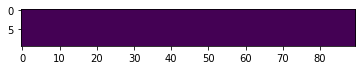

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


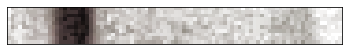

(10, 90, 3)


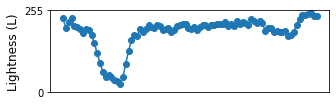

Max [[ 20.  230.7   8. ]]
[True, False, False] [True, 'pf'] 0.0 20.0
path 112 ./Ona KEMRI/patient_images/6913565e-d5bd-41f7-aaa5-b7fadeb6df4a/b3183b57-9d2b-474a-ae2c-cfc8a137bdce.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


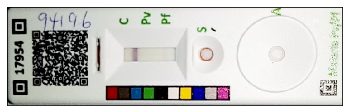

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


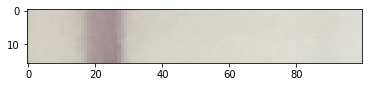

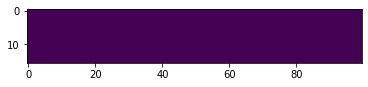

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


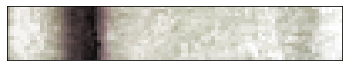

(16, 100, 3)


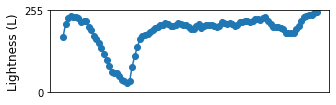

Max [[ 25. 228.  31.]]
[True, False, False] [True, 'pf'] 0.0 20.0
path 113 ./Ona KEMRI/patient_images/f173c56c-a31c-4cc3-bd8c-84905525eece/e9f077b1-8726-4955-9c3d-6ceb31e41f33.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


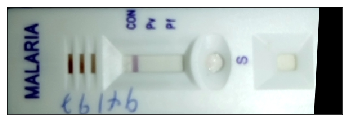

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


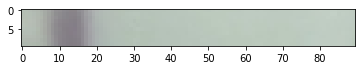

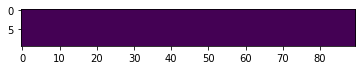

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [31.]


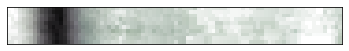

(10, 90, 3)


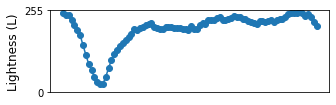

Max [[ 13. 231.  22.]]
[True, False, False] [True, nan] 0.0 31.0
path 114 ./Ona KEMRI/patient_images/f173c56c-a31c-4cc3-bd8c-84905525eece/27964180-2ad2-4958-bf42-b48631e79717.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


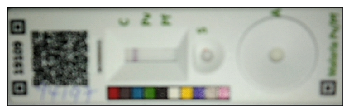

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


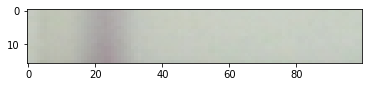

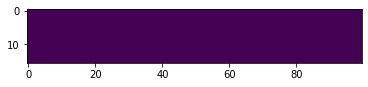

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [39.]


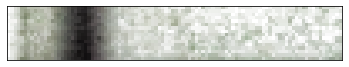

(16, 100, 3)


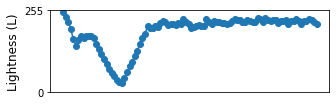

Max [[ 23.  227.5  21. ]]
[True, False, False] [True, nan] 0.0 39.0
path 115 ./Ona KEMRI/patient_images/a059f8ed-099d-4a57-b06e-56d773c4e335/322f771c-f4b2-45dc-9db8-df1e4b5c3201.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


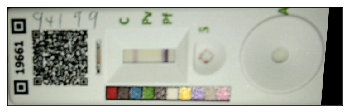

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


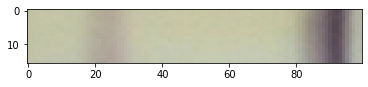

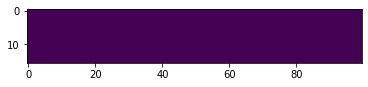

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


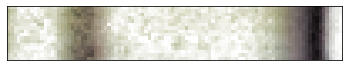

(16, 100, 3)


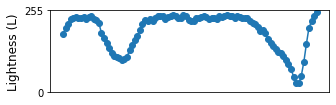

Max [[ 23.     155.3125  20.    ]
 [ 92.     228.75    20.    ]]
[True, False, True] [True, 'pf'] 0.0 46.0
path 116 ./Ona KEMRI/patient_images/a059f8ed-099d-4a57-b06e-56d773c4e335/5c7f603c-6ab8-4c5a-9d46-0125f4714438.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


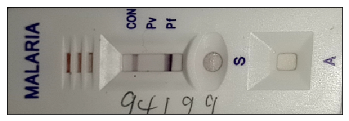

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


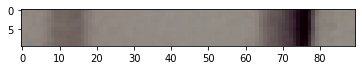

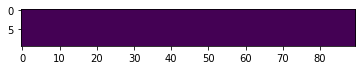

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


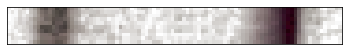

(10, 90, 3)


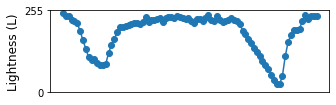

Max [[ 13.  171.7  14. ]
 [ 76.  231.9  25. ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 117 ./Ona KEMRI/patient_images/59d86e74-9555-40a1-becf-0ec0315b4650/3ac46e03-8f57-4ebf-b9d0-36f654a78cb2.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


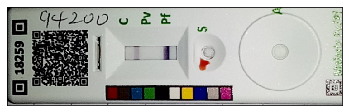

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


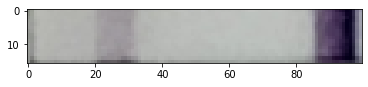

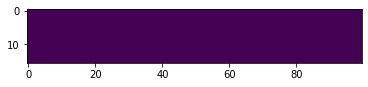

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [25.]


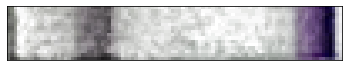

(16, 100, 3)


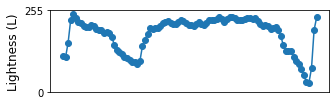

Max [[  1.     146.8125   3.    ]
 [ 29.     168.75     5.    ]
 [ 96.     226.5      9.    ]]
[False, False, True] [True, 'pf'] 0.0 25.0
path 118 ./Ona KEMRI/patient_images/59d86e74-9555-40a1-becf-0ec0315b4650/4964620c-1360-4d03-81bb-a5f0ffa7b555.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


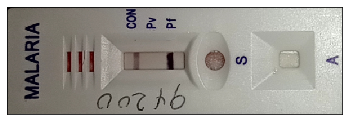

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


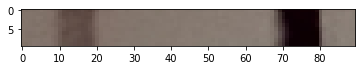

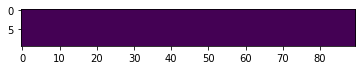

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [31.]


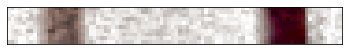

(10, 90, 3)


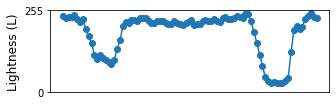

Max [[ 17.  168.7   8. ]
 [ 77.  228.2   5. ]]
[True, False, True] [True, 'pf'] 0.0 31.0
path 119 ./Ona KEMRI/patient_images/829606d4-3982-4ab3-a834-c79596424c78/433b29b4-8a0a-40b2-adbb-77696ca634f8.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


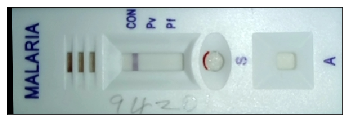

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


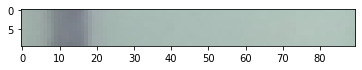

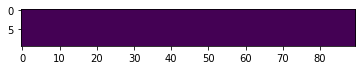

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [34.]


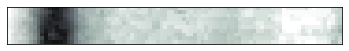

(10, 90, 3)


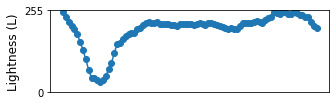

Max [[ 13.  222.8  23. ]]
[True, False, False] [True, nan] 0.0 34.0
path 120 ./Ona KEMRI/patient_images/6456b6ff-0098-411a-a309-82dbf4feb466/e19c6c34-04f5-4423-9ee4-2487da633cca.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


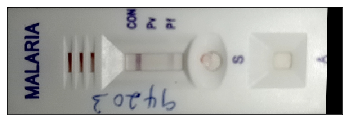

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


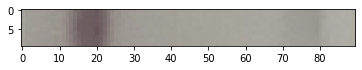

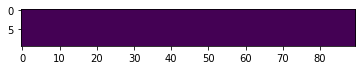

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


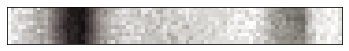

(10, 90, 3)


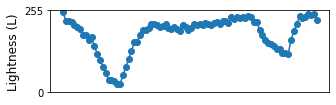

Max [[ 19.  230.8  17. ]
 [ 79.  136.7   4. ]]
[True, False, True] [True, 'pf'] 0.0 20.0
path 121 ./Ona KEMRI/patient_images/6456b6ff-0098-411a-a309-82dbf4feb466/d62a7eea-8e87-4781-a65a-d95a5c4a36b1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


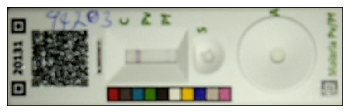

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


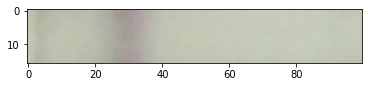

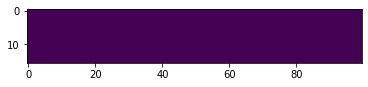

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [10.]


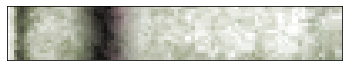

(16, 100, 3)


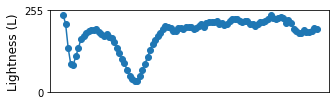

Max [[  4.     171.125   10.    ]
 [ 29.     221.9375  22.    ]]
[True, False, False] [True, 'pf'] 0.0 10.0
path 122 ./Ona KEMRI/patient_images/829606d4-3982-4ab3-a834-c79596424c78/437597cc-17f6-4b97-ad05-5be4a39515ed.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


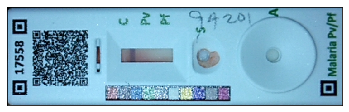

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


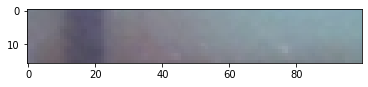

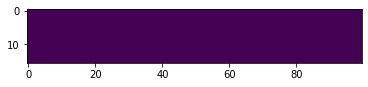

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [8.]


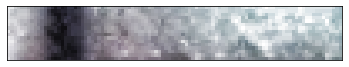

(16, 100, 3)


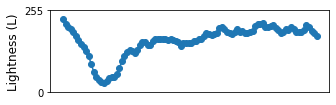

Max [[ 16.    228.125  25.   ]]
[True, False, False] [True, nan] 0.0 8.0
path 123 ./Ona KEMRI/patient_images/51fcc482-9d2b-4ed5-942d-5dcc4f5f3db2/fec10769-28d2-4006-a4c5-250d8c1163ac.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


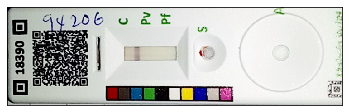

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


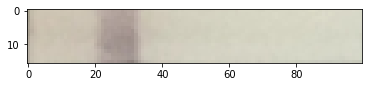

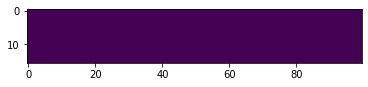

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


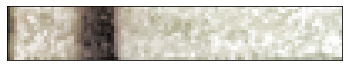

(16, 100, 3)


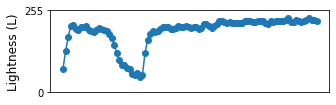

Max [[ 30.     209.6875   5.    ]]
[False, False, False] [True, nan] 0.0 15.0
path 124 ./Ona KEMRI/patient_images/51fcc482-9d2b-4ed5-942d-5dcc4f5f3db2/af49fdd5-b196-4296-ad5b-ca22e1870864.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


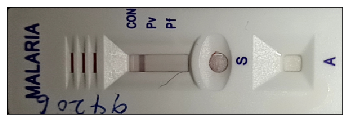

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


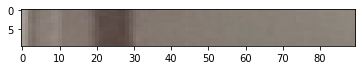

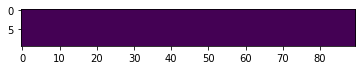

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [6.]


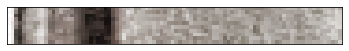

(10, 90, 3)


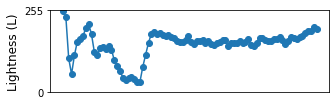

Max [[  3.  199.8   8. ]
 [ 26.  223.8   7. ]]
[True, False, False] [True, nan] 0.0 6.0
path 125 ./Ona KEMRI/patient_images/ac55d999-a1ef-4663-a4b8-5842afdadbe0/nan.JPEG nan
Image does not exist
path 126 ./Ona KEMRI/patient_images/6a3ecb17-1ccd-4562-8e99-b984175cfdc8/f418d343-dac1-415c-ae63-2d2f98e379c1.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


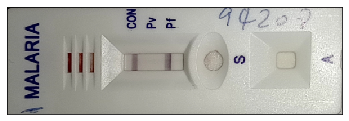

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


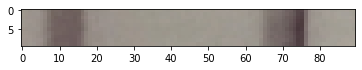

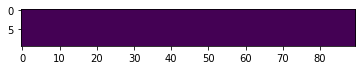

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [33.]


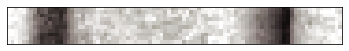

(10, 90, 3)


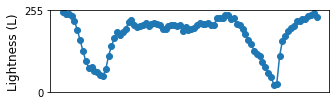

Max [[ 14.  205.8   8. ]
 [ 74.  232.4  21. ]]
[True, False, True] [True, 'pf'] 0.0 33.0
path 127 ./Ona KEMRI/patient_images/6a3ecb17-1ccd-4562-8e99-b984175cfdc8/ae003bba-b358-4335-b4c7-e6bce6dbc7b1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


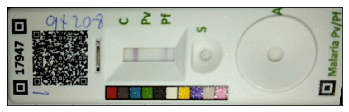

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


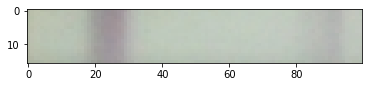

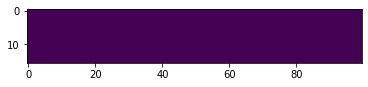

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [26.]


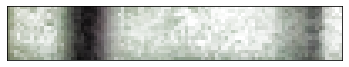

(16, 100, 3)


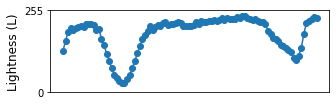

Max [[ 24.    227.     19.   ]
 [ 91.    154.125  19.   ]]
[True, False, True] [True, 'pf'] 0.0 26.0
path 128 ./Ona KEMRI/patient_images/ac55d999-a1ef-4663-a4b8-5842afdadbe0/5c2a3b99-3c5b-4fdd-af24-efec172471de.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


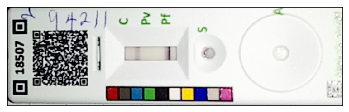

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


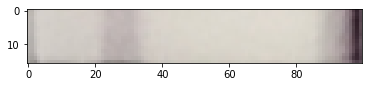

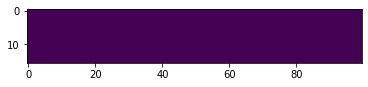

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [41.]


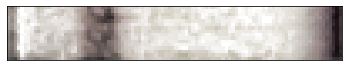

(16, 100, 3)


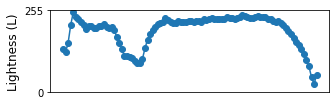

Max [[  1.     131.75     3.    ]
 [ 30.     165.1875  20.    ]]
[False, False, False] [True, 'pf'] 0.0 41.0
path 129 ./Ona KEMRI/patient_images/ac55d999-a1ef-4663-a4b8-5842afdadbe0/0747259c-8ede-49f2-af4a-8f4d59020f3f.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


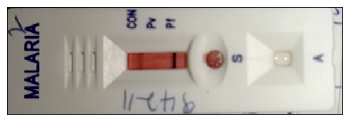

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


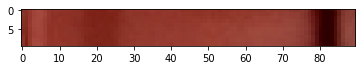

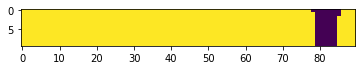

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [26.]


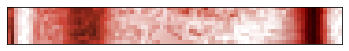

(10, 90, 3)


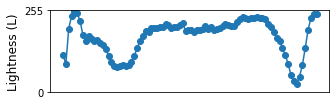

Max [[  1.  168.9   3. ]
 [ 19.  179.    8. ]
 [ 82.  230.9  18. ]]
[True, False, True] [True, 'pf'] 0.93 26.0
path 130 ./Ona KEMRI/patient_images/49893e3d-9b2f-427d-81e9-997fb9826226/47215365-ee26-4cba-b9b3-18d49b2ae654.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


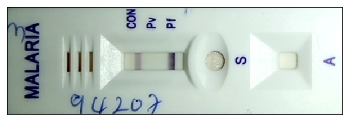

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


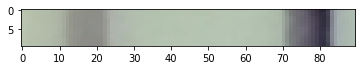

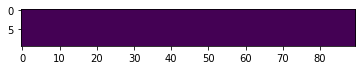

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [65.]


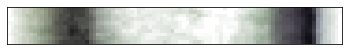

(10, 90, 3)


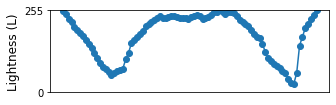

Max [[ 17.  201.8  33. ]
 [ 81.  229.8  29. ]]
[True, False, True] [True, 'pf'] 0.0 65.0
path 131 ./Ona KEMRI/patient_images/2669445e-ee64-4c81-9255-73988e494764/f4445f56-5319-4d6b-9dc7-df569b41a695.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


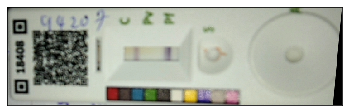

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


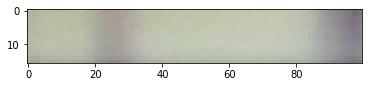

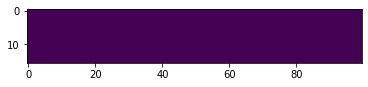

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [36.]


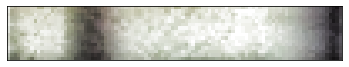

(16, 100, 3)


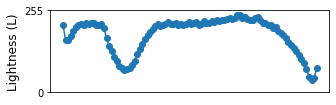

Max [[ 24.     186.8125  21.    ]]
[True, False, False] [True, 'pf'] 0.0 36.0
path 132 ./Ona KEMRI/patient_images/b5bd14b6-cb8d-47bb-bdee-a7c0698a9347/082ca03e-8cc8-4af5-a52e-4d39002e27b8.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


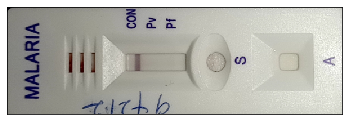

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


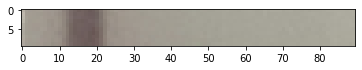

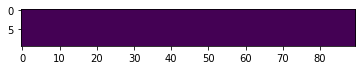

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [4.]


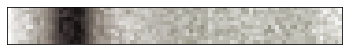

(10, 90, 3)


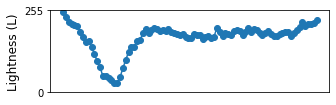

Max [[ 18. 228.   8.]]
[True, False, False] [True, 'pf'] 0.0 4.0
path 133 ./Ona KEMRI/patient_images/b5bd14b6-cb8d-47bb-bdee-a7c0698a9347/17f3f1b2-37c3-4a1e-9b90-96b9d44ad848.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


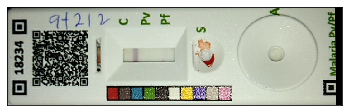

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


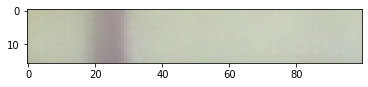

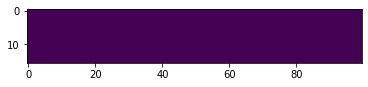

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


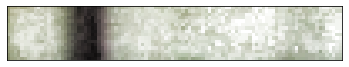

(16, 100, 3)


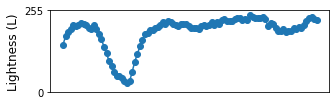

Max [[ 25.    228.875  26.   ]]
[True, False, False] [True, 'pf'] 0.0 28.0
path 134 ./Ona KEMRI/patient_images/b4411369-19fb-4e9f-b1d2-6659bb396d53/da0b95fe-83a3-4ab7-9162-64ff21330010.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


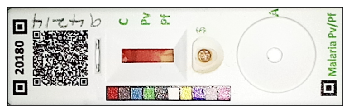

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


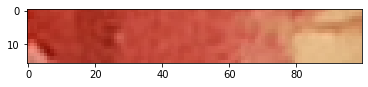

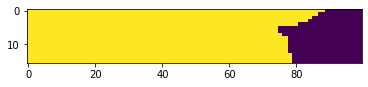

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [13.]


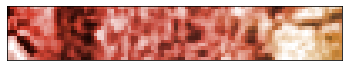

(16, 100, 3)


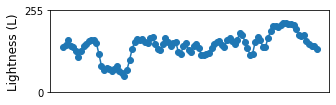

Max [[ 24.    204.125   7.   ]
 [ 73.    138.375   6.   ]]
[True, False, True] [True, nan] 0.799375 13.0
path 135 ./Ona KEMRI/patient_images/b4411369-19fb-4e9f-b1d2-6659bb396d53/f2cbb53c-aa39-4772-bbe6-71dd0d1fe8d9.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


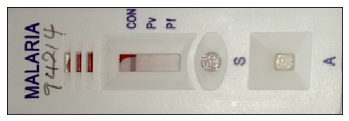

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


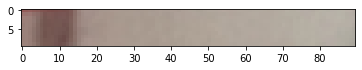

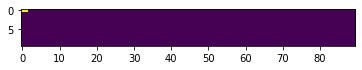

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [21.]


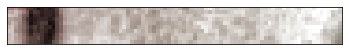

(10, 90, 3)


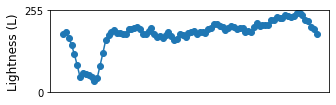

Max [[ 11.  221.5  10. ]]
[True, False, False] [True, nan] 0.0022222222222222222 21.0
path 136 ./Ona KEMRI/patient_images/8d327e4f-9153-448e-afd9-6f37b0f56bdb/05bba831-d981-4104-9463-a85cd5cf6da5.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


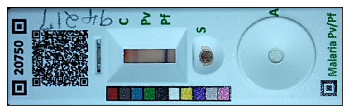

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


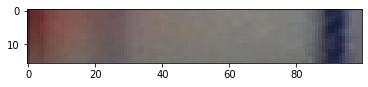

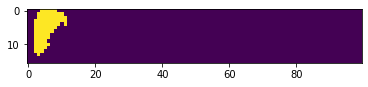

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [12.]


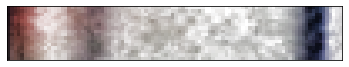

(16, 100, 3)


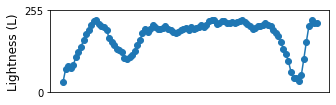

Max [[ 25.     153.5     18.    ]
 [ 92.     220.8125   5.    ]]
[True, False, True] [True, 'pf'] 0.050625 12.0
path 137 ./Ona KEMRI/patient_images/8d327e4f-9153-448e-afd9-6f37b0f56bdb/21da6645-2567-4c1d-8a18-531c8044bb68.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


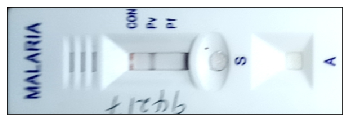

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


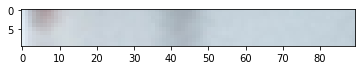

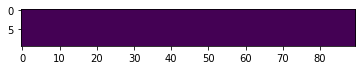

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [9.]


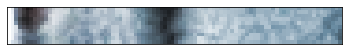

(10, 90, 3)


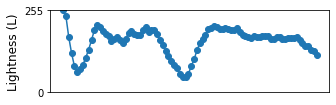

Max [[  5.  192.7  11. ]
 [ 42.  207.8  20. ]]
[True, True, False] [True, 'pf'] 0.0 9.0
path 138 ./Ona KEMRI/patient_images/f3190f0b-4ea9-4cc0-8872-1a8d6e91a57a/fd94c8be-2cd5-4885-a71c-11228788fd59.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


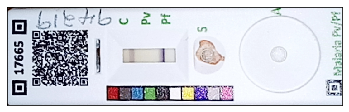

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


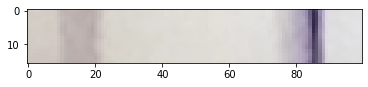

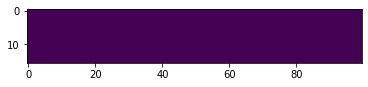

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [32.]


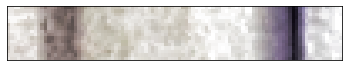

(16, 100, 3)


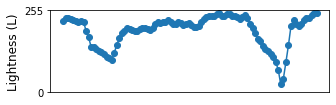

Max [[ 19.     154.4375  12.    ]
 [ 85.     232.125   18.    ]]
[True, False, True] [True, 'pf'] 0.0 32.0
path 139 ./Ona KEMRI/patient_images/f3190f0b-4ea9-4cc0-8872-1a8d6e91a57a/0f64f353-7a26-43ff-b123-36592dcd52a3.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


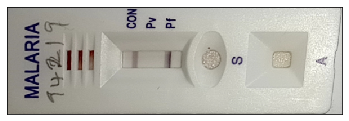

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


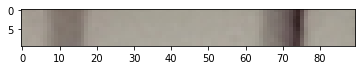

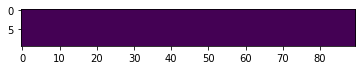

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [33.]


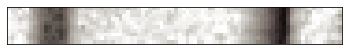

(10, 90, 3)


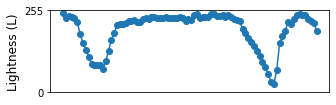

Max [[ 14.  183.8  10. ]
 [ 74.  231.8  20. ]]
[True, False, True] [True, 'pf'] 0.0 33.0
path 140 ./Ona KEMRI/patient_images/4804da73-84b2-475c-8884-8c0b25a412af/64ebf50e-e793-4d09-b22e-bd844526750b.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


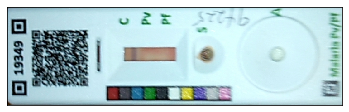

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


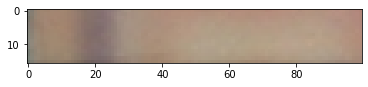

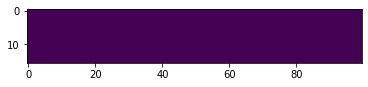

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [6.]


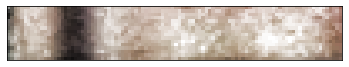

(16, 100, 3)


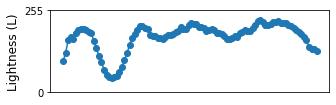

Max [[ 19.     212.3125  22.    ]]
[True, False, False] [True, nan] 0.0 6.0
path 141 ./Ona KEMRI/patient_images/4804da73-84b2-475c-8884-8c0b25a412af/3a65eae0-f22c-459e-b1a4-235843df858e.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


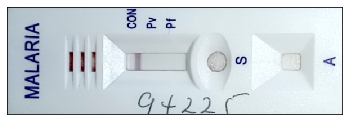

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


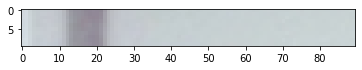

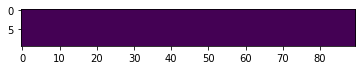

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [8.]


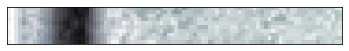

(10, 90, 3)


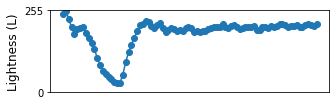

Max [[ 19.  228.3  21. ]]
[True, False, False] [True, nan] 0.0 8.0
path 142 ./Ona KEMRI/patient_images/f7ed80ee-1ad7-41dd-b76c-2c069a6c7205/323208f9-4276-416e-ae3c-234a1286fb7a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


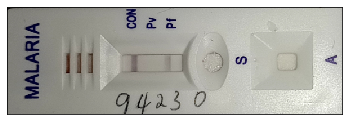

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


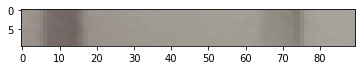

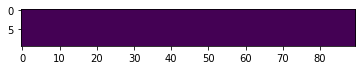

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [26.]


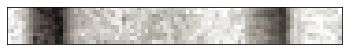

(10, 90, 3)


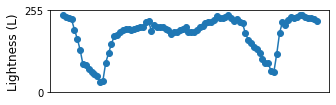

Max [[ 13.  224.5  21. ]
 [ 74.  192.3  15. ]]
[True, False, True] [True, 'pf'] 0.0 26.0
path 143 ./Ona KEMRI/patient_images/f7ed80ee-1ad7-41dd-b76c-2c069a6c7205/6c2eb1e5-8843-464a-a441-23877c9b2ba0.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


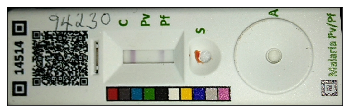

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


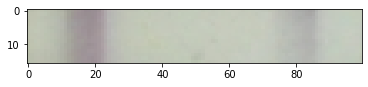

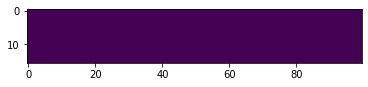

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


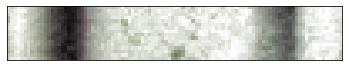

(16, 100, 3)


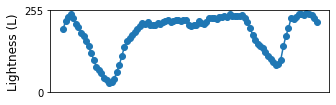

Max [[ 18.     227.25    27.    ]
 [ 83.     170.3125  18.    ]]
[True, False, True] [True, 'pf'] 0.0 46.0
path 144 ./Ona KEMRI/patient_images/a4f382e1-5179-4ead-bf87-f015b1d3bff1/d5ce00f0-338e-4e19-b453-e56826a5a22c.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


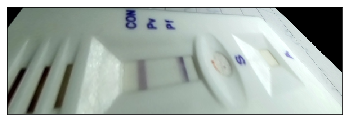

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


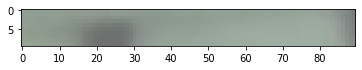

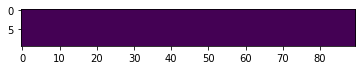

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [33.]


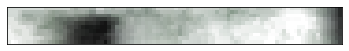

(10, 90, 3)


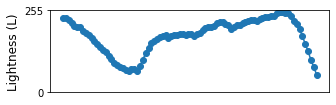

Max [[ 23.  190.5  24. ]]
[True, False, False] [True, 'pf'] 0.0 33.0
path 145 ./Ona KEMRI/patient_images/cd03393f-3360-434a-982c-6a0ea8a7d552/4667b59e-4f58-45f1-9934-33b15157226e.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


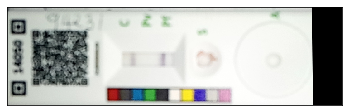

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


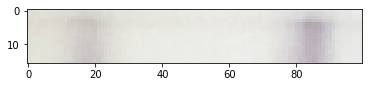

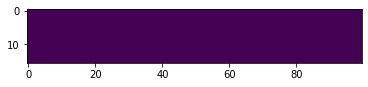

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [34.]


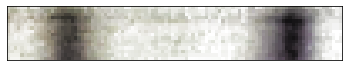

(16, 100, 3)


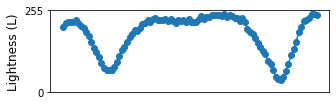

Max [[ 18.     187.625   22.    ]
 [ 85.     216.8125  27.    ]]
[True, False, True] [True, 'pf'] 0.0 34.0
path 146 ./Ona KEMRI/patient_images/cd03393f-3360-434a-982c-6a0ea8a7d552/c5b49fd0-de24-4e89-b28a-85d0bab55abb.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


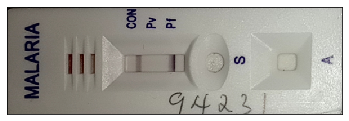

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


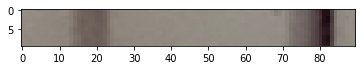

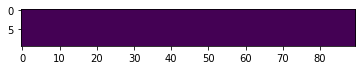

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [36.]


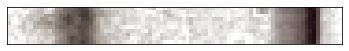

(10, 90, 3)


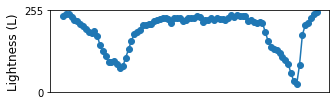

Max [[ 20.  181.3  11. ]
 [ 82.  231.   19. ]]
[True, False, True] [True, 'pf'] 0.0 36.0
path 147 ./Ona KEMRI/patient_images/a4f382e1-5179-4ead-bf87-f015b1d3bff1/c4180ec5-1cdd-48ef-9441-260278ac2364.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


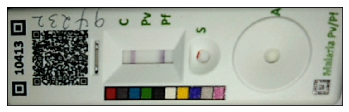

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


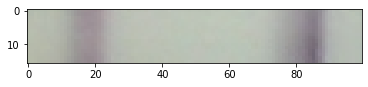

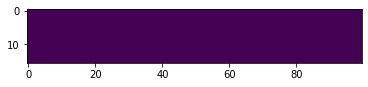

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [48.]


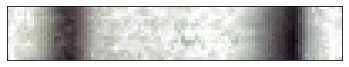

(16, 100, 3)


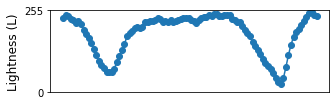

Max [[ 18.    194.625  22.   ]
 [ 85.    231.25   32.   ]]
[True, False, True] [True, 'pf'] 0.0 48.0
path 148 ./Ona KEMRI/patient_images/f9ad343f-8187-4dcb-996e-1210761ae52b/8e65663c-97bd-458e-a1bf-5a819c7c6f86.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


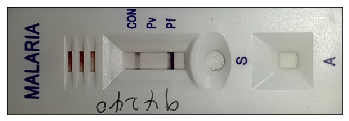

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


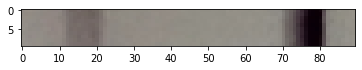

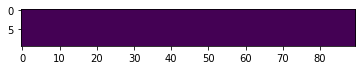

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


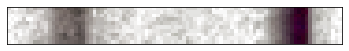

(10, 90, 3)


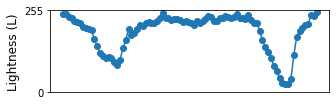

Max [[ 19.  171.1   6. ]
 [ 78.  231.6  18. ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 149 ./Ona KEMRI/patient_images/1c7a69aa-fd3a-4e3f-b9b3-4eff9c130299/1badb9ea-3920-4344-ae74-7ea8d2a0442c.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


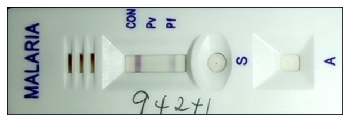

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


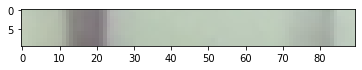

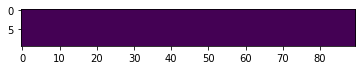

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


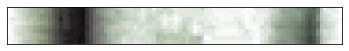

(10, 90, 3)


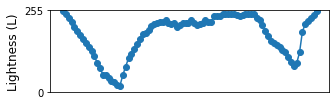

Max [[ 20.  235.4  35. ]
 [ 81.  173.6  21. ]]
[True, False, True] [True, 'pf'] 0.0 20.0
path 150 ./Ona KEMRI/patient_images/03718a93-d5a2-44d5-8bb6-da9a104c85a2/44cec4b5-e831-4b64-b1f5-32887c51ec5d.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


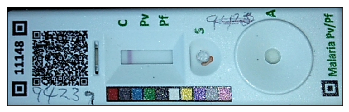

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


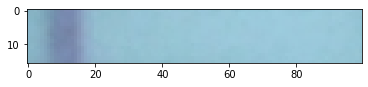

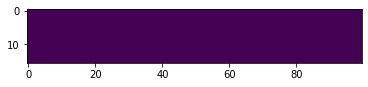

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [33.]


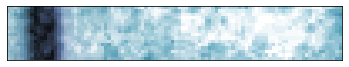

(16, 100, 3)


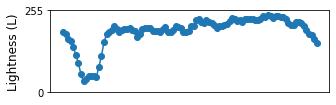

Max [[  8.    222.625  11.   ]]
[True, False, False] [True, nan] 0.0 33.0
path 151 ./Ona KEMRI/patient_images/03718a93-d5a2-44d5-8bb6-da9a104c85a2/ccc0a56a-bea6-4ffb-ab73-005c8d09a6d9.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


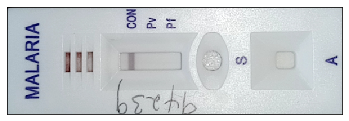

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


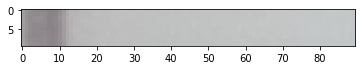

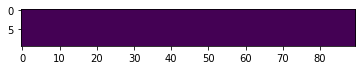

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [12.]


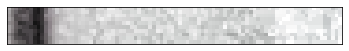

(10, 90, 3)


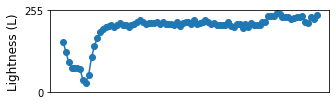

Max [[  8.  226.2  12. ]]
[True, False, False] [True, nan] 0.0 12.0
path 152 ./Ona KEMRI/patient_images/f9ad343f-8187-4dcb-996e-1210761ae52b/5e4d16a4-b5ac-4872-8fa0-6c08a4e0163f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


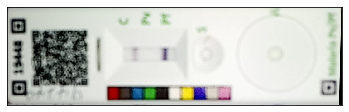

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


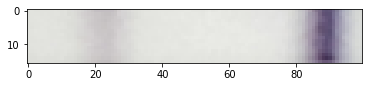

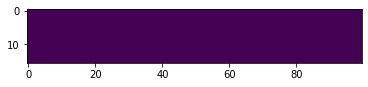

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [57.]


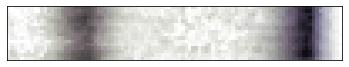

(16, 100, 3)


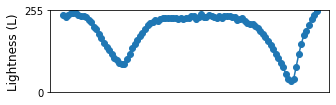

Max [[ 23.     169.3125  32.    ]
 [ 89.     222.6875  28.    ]]
[True, False, True] [True, 'pf'] 0.0 57.0
path 153 ./Ona KEMRI/patient_images/1c7a69aa-fd3a-4e3f-b9b3-4eff9c130299/225ed544-a2bd-43cc-94bc-84c69d59389f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


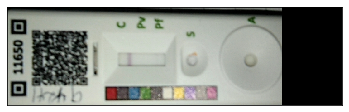

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


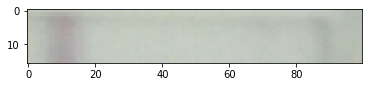

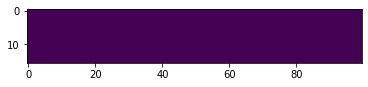

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


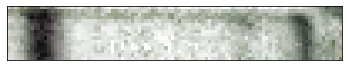

(16, 100, 3)


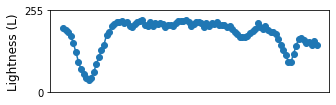

Max [[ 10.     216.5625  20.    ]
 [ 89.     161.3125  10.    ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 154 ./Ona KEMRI/patient_images/21fb82ab-62c0-4567-a033-750a4e2d0068/6d037317-12b1-4fab-a8ed-a6932093ae2a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


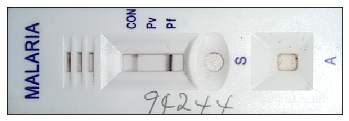

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


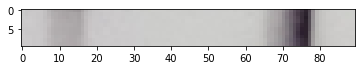

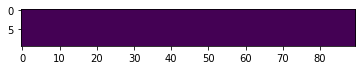

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [62.]


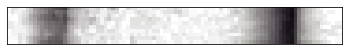

(10, 90, 3)


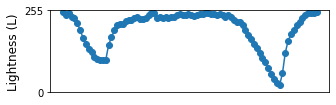

Max [[ 14.  156.7  23. ]
 [ 76.  234.3  28. ]]
[True, False, True] [True, 'pf'] 0.0 62.0
path 155 ./Ona KEMRI/patient_images/21fb82ab-62c0-4567-a033-750a4e2d0068/691f2304-80b2-4817-b8fd-f94fee750f5d.JPEG experimental
Image does not exist
path 156 ./Ona KEMRI/patient_images/a27c593a-69bf-45d8-b27f-7706f52dc63b/48550a12-4068-42ab-900f-e660584fcba2.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


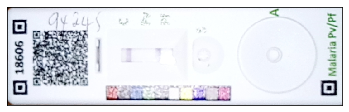

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


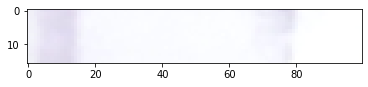

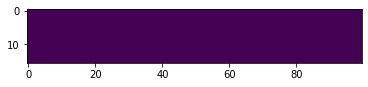

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [375.]


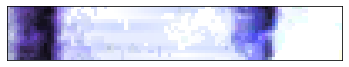

(16, 100, 3)


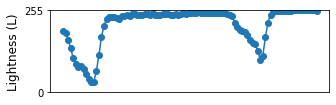

Max [[ 12.     223.625   11.    ]
 [ 77.     154.1875  20.    ]]
[True, False, True] [True, 'pf'] 0.0 375.0
path 157 ./Ona KEMRI/patient_images/a27c593a-69bf-45d8-b27f-7706f52dc63b/c7304257-6c2b-4494-917c-0554a93fe10e.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


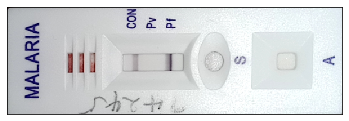

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


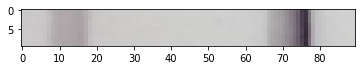

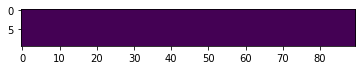

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


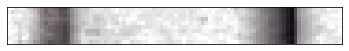

(10, 90, 3)


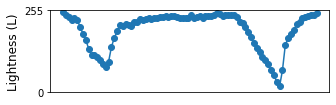

Max [[ 15.  176.7  15. ]
 [ 76.  237.8  27. ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 158 ./Ona KEMRI/patient_images/b4bea4fe-d4c6-4fd8-b6af-d910964b0f4f/f5128bcb-aaba-4685-9e8f-899a6ae34531.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


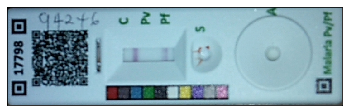

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


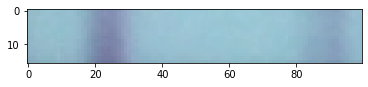

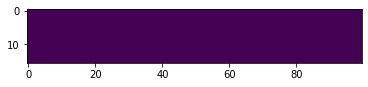

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [25.]


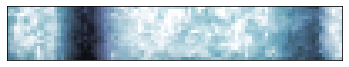

(16, 100, 3)


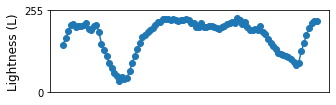

Max [[ 22.     219.6875   9.    ]
 [ 91.     170.1875  20.    ]]
[True, False, True] [True, 'pf'] 0.0 25.0
path 159 ./Ona KEMRI/patient_images/b4bea4fe-d4c6-4fd8-b6af-d910964b0f4f/7fcfb32f-d1af-47e4-9ffa-24c123bd0e51.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


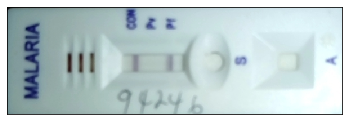

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


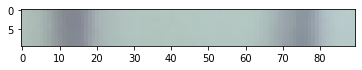

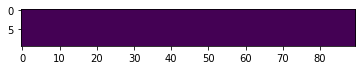

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [25.]


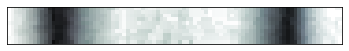

(10, 90, 3)


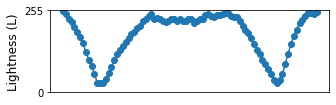

Max [[ 12.  226.7  30. ]
 [ 75.  228.7  29. ]]
[True, False, True] [True, 'pf'] 0.0 25.0
path 160 ./Ona KEMRI/patient_images/30b3ab1f-05e3-4cb1-97ba-32147742eea8/5343cf8a-1c66-47ab-be82-ffb9aaf2fbef.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


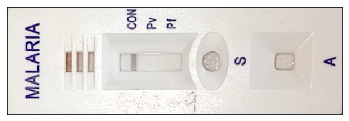

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


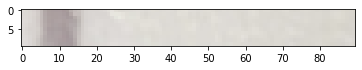

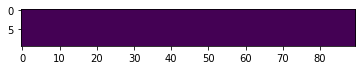

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [17.]


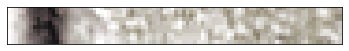

(10, 90, 3)


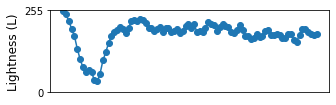

Max [[ 12.  222.7  10. ]]
[True, False, False] [True, nan] 0.0 17.0
path 161 ./Ona KEMRI/patient_images/87816d72-6126-4f6f-a368-f8d6364367a0/c6c57244-67ed-493f-8453-ec4a2182fc9c.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


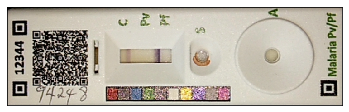

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


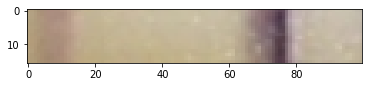

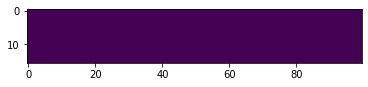

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [14.]


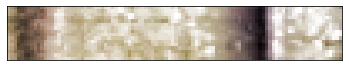

(16, 100, 3)


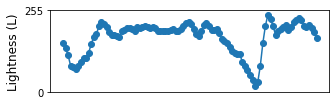

Max [[  5.    183.125  14.   ]
 [ 75.    236.     19.   ]]
[True, False, True] [True, 'pf'] 0.0 14.0
path 162 ./Ona KEMRI/patient_images/87816d72-6126-4f6f-a368-f8d6364367a0/983bf6cf-1dd5-4209-940a-7170f2596259.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


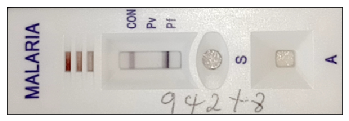

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


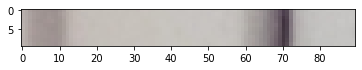

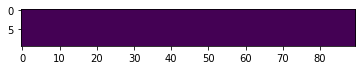

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [25.]


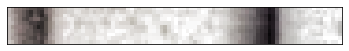

(10, 90, 3)


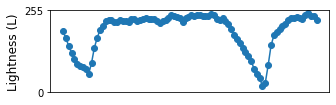

Max [[  9.  199.3  15. ]
 [ 70.  238.   23. ]]
[True, False, True] [True, 'pf'] 0.0 25.0
path 163 ./Ona KEMRI/patient_images/30b3ab1f-05e3-4cb1-97ba-32147742eea8/24ce9b51-cac6-485d-8e5e-705d5c289347.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


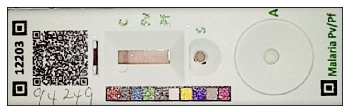

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


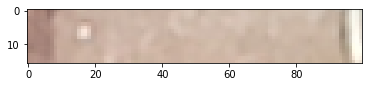

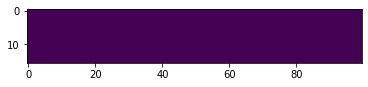

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [14.]


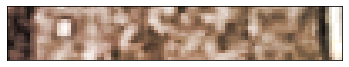

(16, 100, 3)


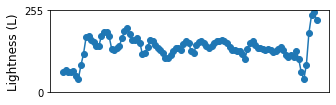

Max [[  6.     213.75     5.    ]
 [ 94.     216.1875   6.    ]]
[True, False, True] [True, nan] 0.0 14.0
path 164 ./Ona KEMRI/patient_images/62ae0fea-b808-4341-9816-9e00f9320aad/9dda0ebe-9bf1-412b-b320-f303f88f55f7.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


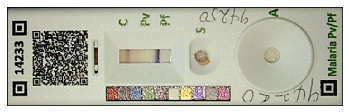

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


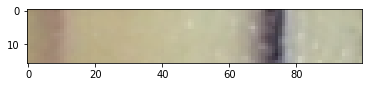

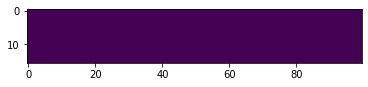

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [10.]


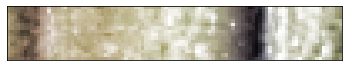

(16, 100, 3)


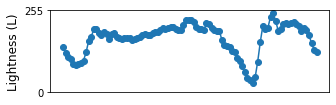

Max [[  5.    170.25   12.   ]
 [ 74.    228.625  16.   ]]
[True, False, True] [True, 'pf'] 0.0 10.0
path 165 ./Ona KEMRI/patient_images/62ae0fea-b808-4341-9816-9e00f9320aad/9dda0ebe-9bf1-412b-b320-f303f88f55f7.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


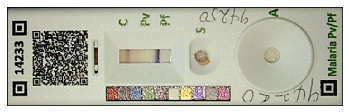

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


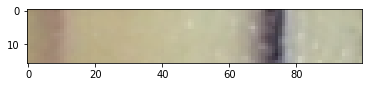

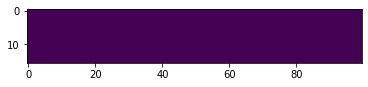

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [10.]


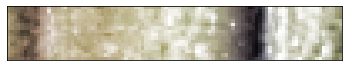

(16, 100, 3)


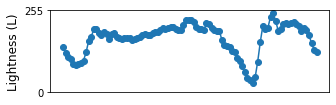

Max [[  5.    170.25   12.   ]
 [ 74.    228.625  16.   ]]
[True, False, True] [True, 'pf'] 0.0 10.0
path 166 ./Ona KEMRI/patient_images/62ae0fea-b808-4341-9816-9e00f9320aad/b255b41b-6e2c-4909-8cb8-50c00d17ae45.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


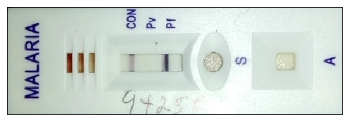

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


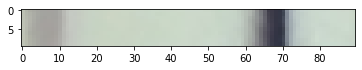

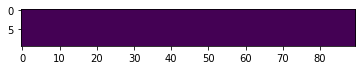

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


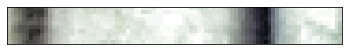

(10, 90, 3)


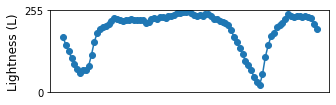

Max [[  6.  196.4   6. ]
 [ 69.  233.7  27. ]]
[True, False, True] [True, 'pf'] 0.0 46.0
path 167 ./Ona KEMRI/patient_images/5e8a25ab-98f7-45ed-b2ad-0db2fa044c1a/nan.JPEG nan
Image does not exist
path 168 ./Ona KEMRI/patient_images/5e8a25ab-98f7-45ed-b2ad-0db2fa044c1a/729ac822-4aa3-46b8-914d-5134e1a3ce78.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


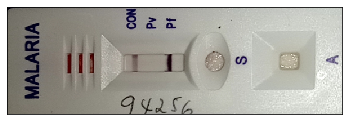

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


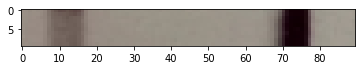

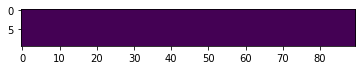

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [34.]


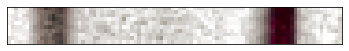

(10, 90, 3)


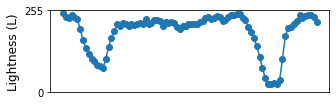

Max [[ 14.  180.7  15. ]
 [ 72.  231.6  11. ]]
[True, False, True] [True, 'pf'] 0.0 34.0
path 169 ./Ona KEMRI/patient_images/f3267237-7a26-4f67-bae1-9ca6339c7845/7cd6a4d0-742d-41ba-abac-86ce53fb8176.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


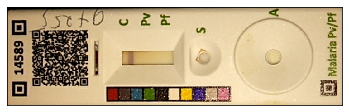

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


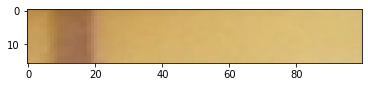

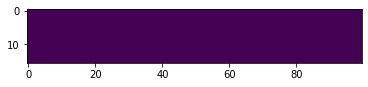

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [17.]


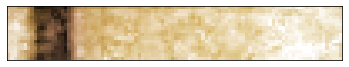

(16, 100, 3)


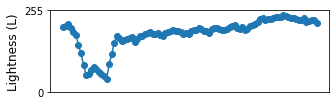

Max [[ 17.     214.8125   8.    ]]
[True, False, False] [True, nan] 0.0 17.0
path 170 ./Ona KEMRI/patient_images/f3267237-7a26-4f67-bae1-9ca6339c7845/af9c35f9-7843-42c8-8afb-90c21098f01d.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


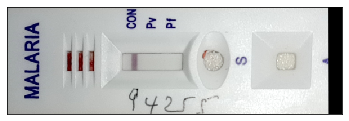

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


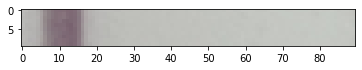

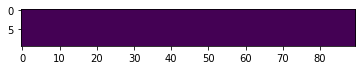

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [25.]


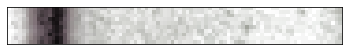

(10, 90, 3)


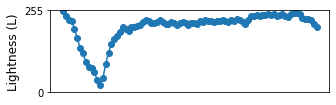

Max [[ 13.  232.5  20. ]]
[True, False, False] [True, nan] 0.0 25.0
path 171 ./Ona KEMRI/patient_images/5e8a25ab-98f7-45ed-b2ad-0db2fa044c1a/22aca986-f876-4f90-b566-b98d9421729f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


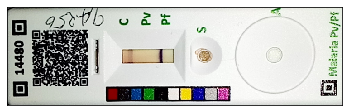

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


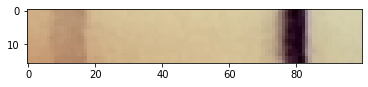

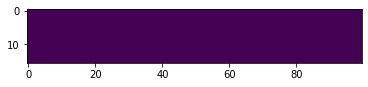

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [32.]


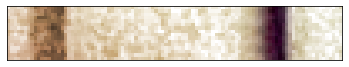

(16, 100, 3)


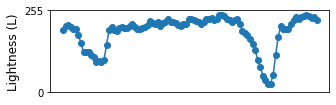

Max [[ 15.     161.8125   4.    ]
 [ 80.     230.3125  16.    ]]
[True, False, True] [True, 'pf'] 0.0 32.0
path 172 ./Ona KEMRI/patient_images/10784618-ee49-4e26-acb4-d359d8442c31/11ea1f32-1201-4bd7-8003-765bc0154dde.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


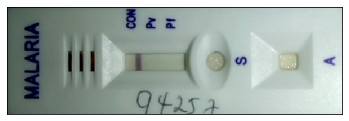

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


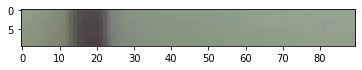

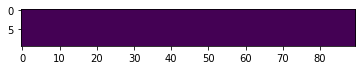

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [8.]


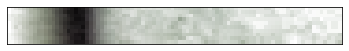

(10, 90, 3)


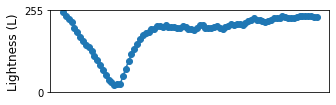

Max [[ 18.  232.6  18. ]]
[True, False, False] [True, nan] 0.0 8.0
path 173 ./Ona KEMRI/patient_images/10784618-ee49-4e26-acb4-d359d8442c31/16e40308-d860-41f4-be6a-032bb84168f1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


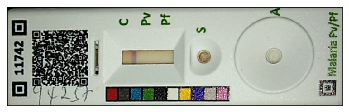

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


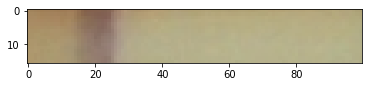

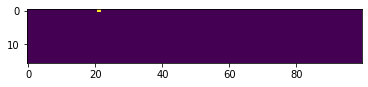

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


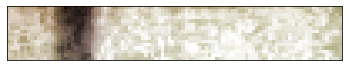

(16, 100, 3)


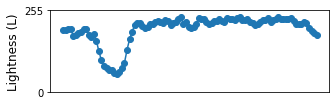

Max [[ 21.     200.4375  10.    ]]
[True, False, False] [True, nan] 0.000625 20.0
path 174 ./Ona KEMRI/patient_images/6fc2f3ed-c506-4368-81f4-0cecaa79fc10/nan.JPEG nan
Image does not exist
path 175 ./Ona KEMRI/patient_images/6fc2f3ed-c506-4368-81f4-0cecaa79fc10/nan.JPEG nan
Image does not exist
path 176 ./Ona KEMRI/patient_images/e9886e07-da1e-49da-a91f-b7f34126b03f/nan.JPEG nan
Image does not exist
path 177 ./Ona KEMRI/patient_images/138d6bcb-2fb9-4805-bde8-7fa1faf56c4c/e7a9d3aa-654a-4618-bcec-a010af71f2fa.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


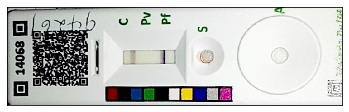

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


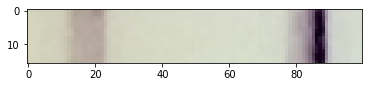

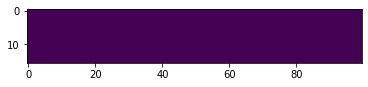

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [60.]


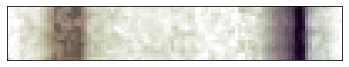

(16, 100, 3)


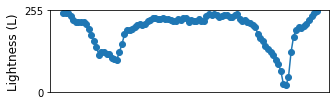

Max [[ 21.     154.3125   8.    ]
 [ 87.     235.125   20.    ]]
[True, False, True] [True, 'pf'] 0.0 60.0
path 178 ./Ona KEMRI/patient_images/138d6bcb-2fb9-4805-bde8-7fa1faf56c4c/95961ade-d834-45fa-9e5e-b16ac619047d.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


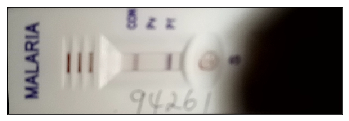

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


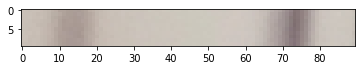

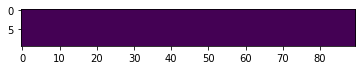

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [26.]


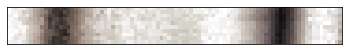

(10, 90, 3)


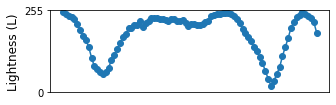

Max [[ 14.  200.2  26. ]
 [ 73.  235.9  26. ]]
[True, False, True] [True, 'pf'] 0.0 26.0
path 179 ./Ona KEMRI/patient_images/e9886e07-da1e-49da-a91f-b7f34126b03f/56ad91a8-439d-4bf4-9b1f-0923a66720f1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


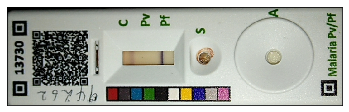

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


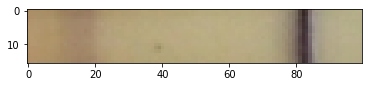

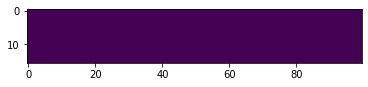

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [33.]


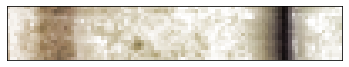

(16, 100, 3)


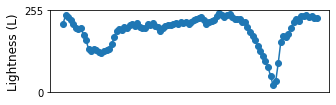

Max [[ 15.     133.375    9.    ]
 [ 82.     234.6875  16.    ]]
[True, False, True] [True, 'pf'] 0.0 33.0
path 180 ./Ona KEMRI/patient_images/6fc2f3ed-c506-4368-81f4-0cecaa79fc10/5341b357-9ed7-46a8-ab3d-dcc6fe76e041.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


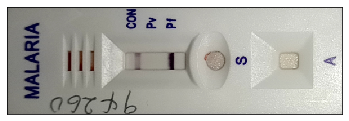

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


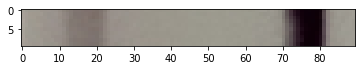

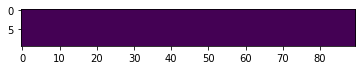

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [29.]


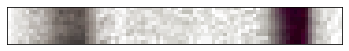

(10, 90, 3)


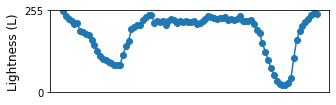

Max [[ 19.  172.3  24. ]
 [ 77.  233.8  21. ]]
[True, False, True] [True, 'pf'] 0.0 29.0
path 181 ./Ona KEMRI/patient_images/e9886e07-da1e-49da-a91f-b7f34126b03f/2573b81c-d37a-44f6-b27f-661ac2aa5279.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


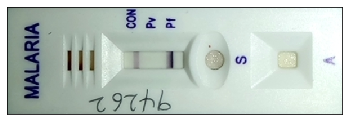

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


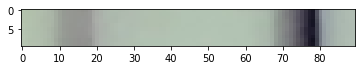

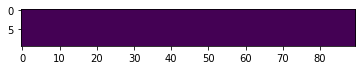

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [64.]


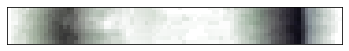

(10, 90, 3)


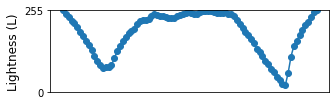

Max [[ 14.  181.4  14. ]
 [ 78.  234.8  31. ]]
[True, False, True] [True, 'pf'] 0.0 64.0
path 182 ./Ona KEMRI/patient_images/6fc2f3ed-c506-4368-81f4-0cecaa79fc10/40ff86d0-32a1-4234-96cf-7e2e214025fb.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


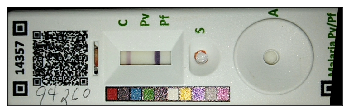

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


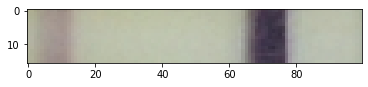

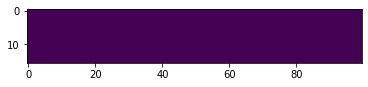

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [52.]


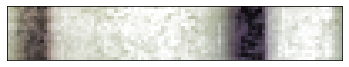

(16, 100, 3)


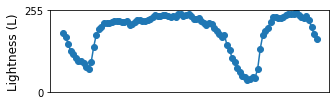

Max [[ 10.     182.8125   9.    ]
 [ 72.     219.0625  10.    ]]
[True, False, True] [True, 'pf'] 0.0 52.0
path 183 ./Ona KEMRI/patient_images/00dcc8a4-9ac5-401a-b190-728010dc977d/nan.JPEG nan
Image does not exist
path 184 ./Ona KEMRI/patient_images/00dcc8a4-9ac5-401a-b190-728010dc977d/fa621d36-ed7a-4eb7-bd35-087af01946a2.JPEG experimental
Image does not exist
path 185 ./Ona KEMRI/patient_images/08b857a4-9f13-4099-abbc-dd524d6e1922/93d764fd-80c1-43e5-a843-7089ef43e5ac.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


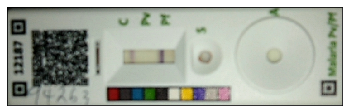

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


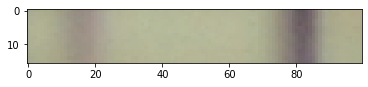

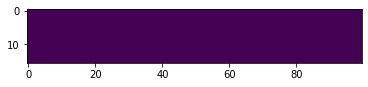

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [23.]


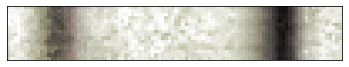

(16, 100, 3)


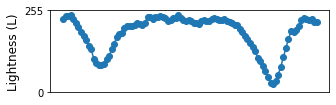

Max [[ 14.   171.25  22.  ]
 [ 82.   229.5   20.  ]]
[True, False, True] [True, 'pf'] 0.0 23.0
path 186 ./Ona KEMRI/patient_images/08b857a4-9f13-4099-abbc-dd524d6e1922/83015f16-8252-4d2d-9f75-a00d9f7b26d1.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


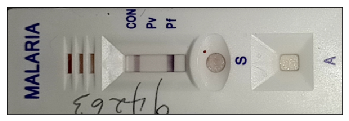

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


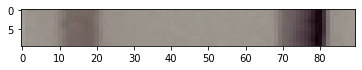

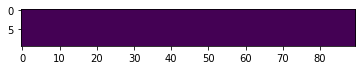

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [27.]


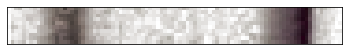

(10, 90, 3)


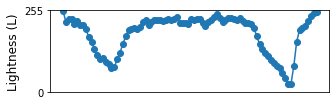

Max [[ 17.  179.4  10. ]
 [ 79.  232.   26. ]]
[True, False, True] [True, 'pf'] 0.0 27.0
path 187 ./Ona KEMRI/patient_images/00dcc8a4-9ac5-401a-b190-728010dc977d/3b688430-6f89-4934-aa73-f622d4cc4933.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


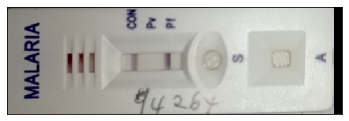

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


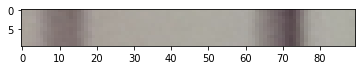

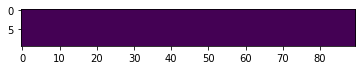

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [40.]


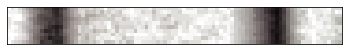

(10, 90, 3)


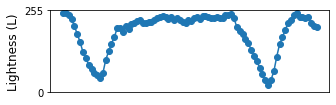

Max [[ 13.  212.8  18. ]
 [ 72.  234.6  22. ]]
[True, False, True] [True, 'pf'] 0.0 40.0
path 188 ./Ona KEMRI/patient_images/e546024d-ab8a-4810-b033-ea66944db931/fdef9ce8-a7fc-4b1d-9514-47aaf44a54d6.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


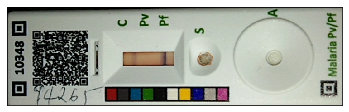

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


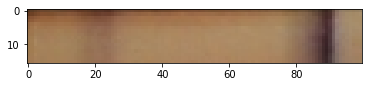

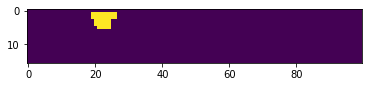

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


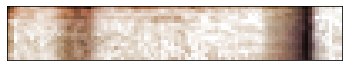

(16, 100, 3)


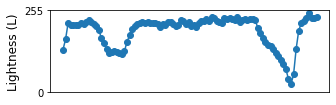

Max [[ 23.     136.1875  10.    ]
 [ 89.     231.5625  21.    ]]
[True, False, True] [True, 'pf'] 0.01875 30.0
path 189 ./Ona KEMRI/patient_images/e546024d-ab8a-4810-b033-ea66944db931/ab32487c-70c1-4f0d-a002-120a215405d0.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


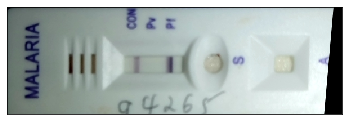

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


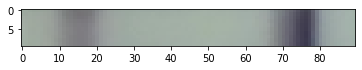

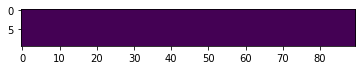

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


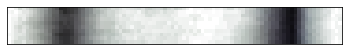

(10, 90, 3)


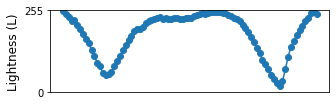

Max [[ 15.  201.4  29. ]
 [ 76.  237.   32. ]]
[True, False, True] [True, 'pf'] 0.0 46.0
path 190 ./Ona KEMRI/patient_images/e42fd1d0-f80c-4768-9632-37f6c57c0e45/f5325fb4-c9a1-41bb-b51d-345668d22780.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


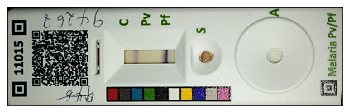

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


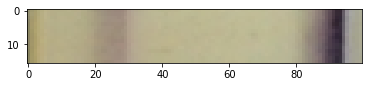

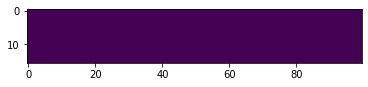

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


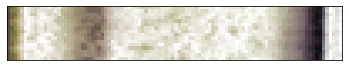

(16, 100, 3)


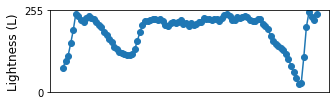

Max [[ 26.   140.25  21.  ]
 [ 92.   230.    18.  ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 191 ./Ona KEMRI/patient_images/e42fd1d0-f80c-4768-9632-37f6c57c0e45/9f09a099-81ca-42e6-891a-d75de7d50de0.JPEG carestart
Image does not exist
path 192 ./Ona KEMRI/patient_images/18981f47-8d8c-4fa2-9748-9feafcf16189/2e2b0aa9-80e8-4e1c-8202-6f919ae3d465.JPEG experimental
Image does not exist
path 193 ./Ona KEMRI/patient_images/8b23a2e6-938b-4d1f-a1cf-40419d553b54/3bbbc883-34f6-4c40-a3a8-0a24b7d88ae9.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


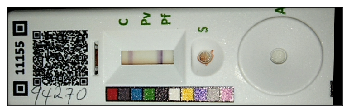

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


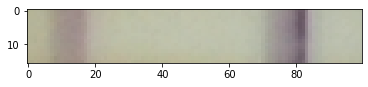

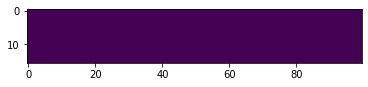

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [37.]


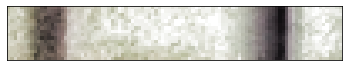

(16, 100, 3)


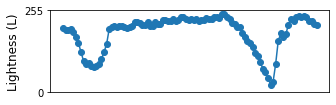

Max [[ 12.     176.1875   9.    ]
 [ 81.     232.75    15.    ]]
[True, False, True] [True, 'pf'] 0.0 37.0
path 194 ./Ona KEMRI/patient_images/8b23a2e6-938b-4d1f-a1cf-40419d553b54/294211d6-7a9a-40cf-b18c-3537c8004b1b.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


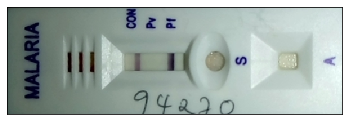

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


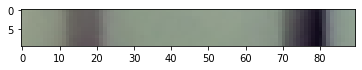

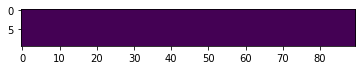

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [27.]


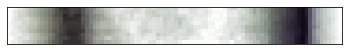

(10, 90, 3)


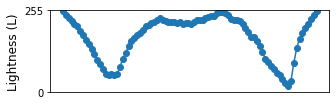

Max [[ 16.  202.3  16. ]
 [ 79.  235.8  32. ]]
[True, False, True] [True, 'pf'] 0.0 27.0
path 195 ./Ona KEMRI/patient_images/18981f47-8d8c-4fa2-9748-9feafcf16189/8ad71890-a70e-46ea-a557-0bdf99b673c9.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


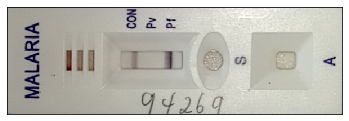

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


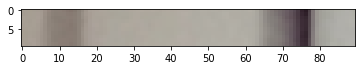

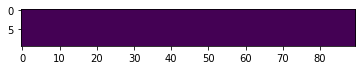

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


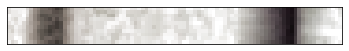

(10, 90, 3)


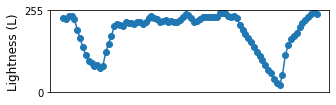

Max [[ 13.  181.7   6. ]
 [ 76.  235.   27. ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 196 ./Ona KEMRI/patient_images/073ec9ca-56d3-4b0a-bb23-31321a4c0716/3f07fb47-4cc5-4efe-ab0f-bee77751ea3f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


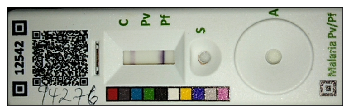

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


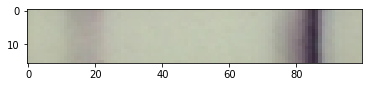

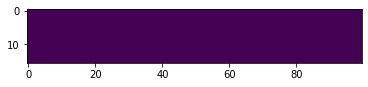

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [65.]


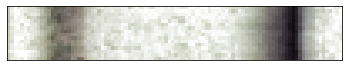

(16, 100, 3)


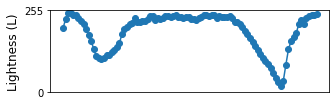

Max [[ 15.     153.9375  14.    ]
 [ 85.     237.5     24.    ]]
[True, False, True] [True, 'pf'] 0.0 65.0
path 197 ./Ona KEMRI/patient_images/073ec9ca-56d3-4b0a-bb23-31321a4c0716/8611e3c5-c855-4c21-b6fc-fd83b9cb7d1c.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


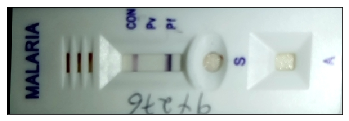

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


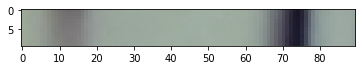

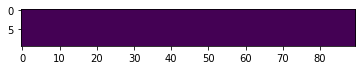

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


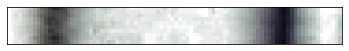

(10, 90, 3)


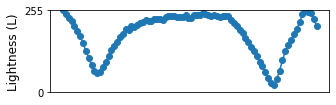

Max [[ 12.  197.4  21. ]
 [ 74.  234.4  28. ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 198 ./Ona KEMRI/patient_images/3aa937ea-32a5-483a-8e1e-bb79a6787bef/ce93f356-1145-4259-9784-25d68ddde349.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


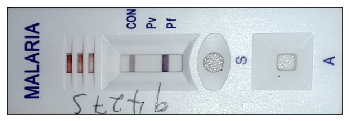

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


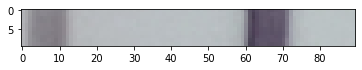

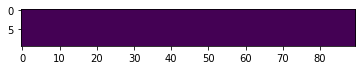

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [23.]


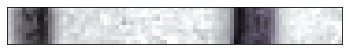

(10, 90, 3)


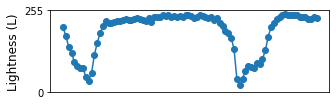

Max [[  9.  220.   14. ]
 [ 62.  232.9  10. ]]
[True, True, False] [True, 'pf'] 0.0 23.0
path 199 ./Ona KEMRI/patient_images/3aa937ea-32a5-483a-8e1e-bb79a6787bef/911d18d1-5dcc-4479-8edb-cb868843cd3d.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


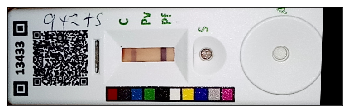

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


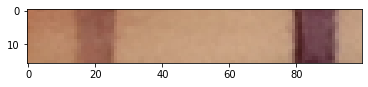

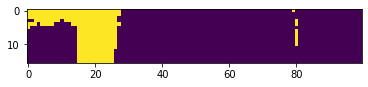

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


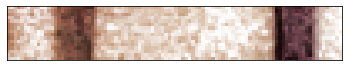

(16, 100, 3)


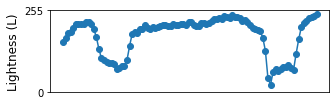

Max [[ 21.   183.5    3.  ]
 [ 81.   232.25  11.  ]]
[True, False, True] [True, 'pf'] 0.16625 28.0
path 200 ./Ona KEMRI/patient_images/a9cc2d8e-9ee6-4d12-ac7b-9a1f10b8cec7/abf062f7-d8c7-4db0-8ce5-5d99cd2c3ae7.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


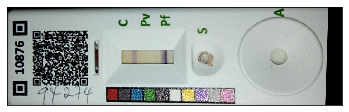

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


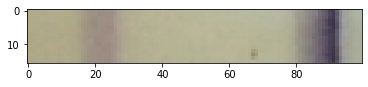

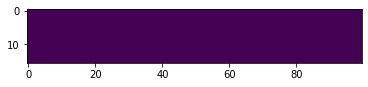

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


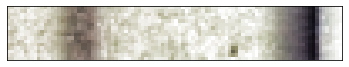

(16, 100, 3)


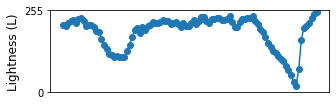

Max [[ 24.     146.0625   7.    ]
 [ 91.     235.4375  24.    ]]
[True, False, True] [True, 'pf'] 0.0 28.0
path 201 ./Ona KEMRI/patient_images/a9cc2d8e-9ee6-4d12-ac7b-9a1f10b8cec7/03d12d5c-3456-4247-be4f-57b9414a87d8.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


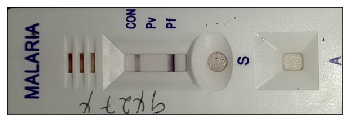

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


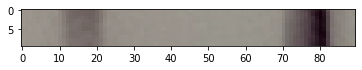

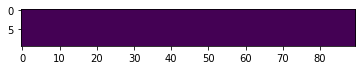

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [23.]


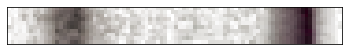

(10, 90, 3)


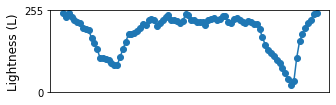

Max [[ 18.  172.7   8. ]
 [ 80.  232.5  20. ]]
[True, False, True] [True, 'pf'] 0.0 23.0
path 202 ./Ona KEMRI/patient_images/13bb975b-428d-4708-9948-c4f41b41deda/592fedd9-0a5b-411a-afdf-94624dc1d75f.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


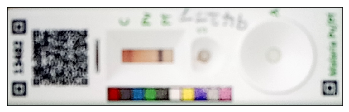

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


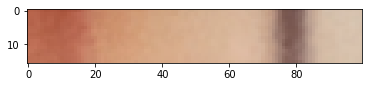

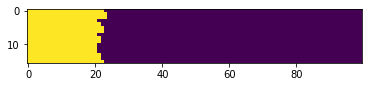

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [47.]


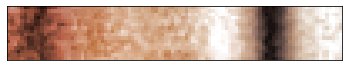

(16, 100, 3)


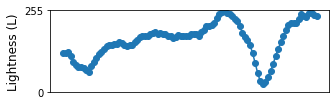

Max [[ 10.     193.4375  15.    ]
 [ 78.     229.4375  29.    ]]
[True, False, True] [True, 'pf'] 0.221875 47.0
path 203 ./Ona KEMRI/patient_images/de00e188-80ce-480b-ab97-a4be415668b8/65480a56-3556-470c-9eed-1c7b35940263.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


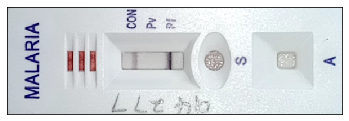

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


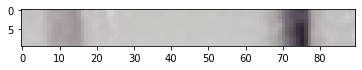

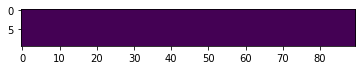

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [29.]


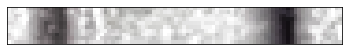

(10, 90, 3)


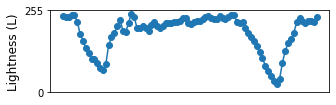

Max [[ 14.  188.2  15. ]
 [ 75.  230.7  19. ]]
[True, False, True] [True, 'pf'] 0.0 29.0
path 204 ./Ona KEMRI/patient_images/afc056d2-30b1-4e1f-bc5a-6df6e520bb1d/b5c4222b-c718-432b-863a-4279b9369ad0.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


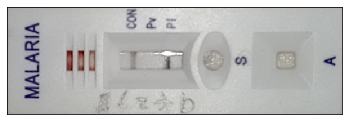

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


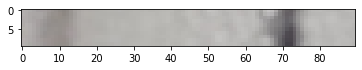

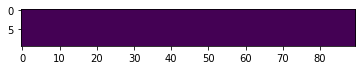

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [20.]


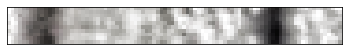

(10, 90, 3)


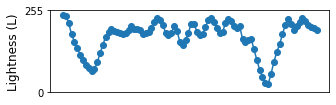

Max [[ 10.  190.7  16. ]
 [ 42.  108.3   5. ]
 [ 72.  230.8  12. ]]
[True, True, True] [True, 'pf'] 0.0 20.0
path 205 ./Ona KEMRI/patient_images/000650dd-cb0d-4223-8065-22f0213f031c/f210b850-e20e-4398-801e-4530ef8d9a54.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


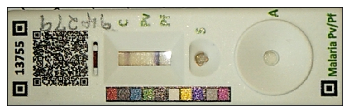

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


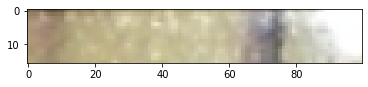

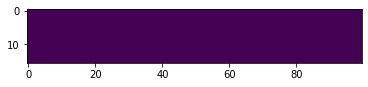

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [44.]


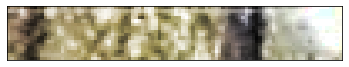

(16, 100, 3)


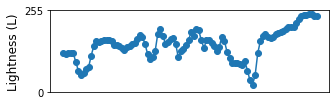

Max [[  7.     202.0625   9.    ]
 [ 34.     153.       7.    ]
 [ 45.     147.5625   6.    ]
 [ 74.     232.3125   7.    ]]
[True, True, True] [True, 'pf'] 0.0 44.0
path 206 ./Ona KEMRI/patient_images/000650dd-cb0d-4223-8065-22f0213f031c/2717bfae-029d-4f44-8bbe-244b9bf2991d.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


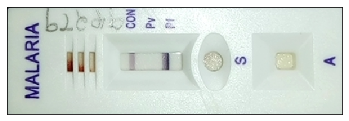

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


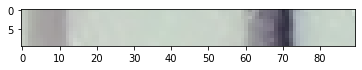

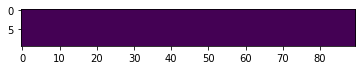

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [18.]


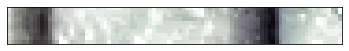

(10, 90, 3)


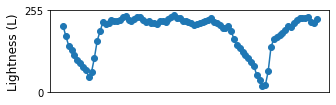

Max [[  9.  207.4  13. ]
 [ 70.  235.6  20. ]]
[True, False, True] [True, 'pf'] 0.0 18.0
path 207 ./Ona KEMRI/patient_images/dc5a23b0-83b8-4ceb-9ad2-604fd97e64aa/c59fa66b-4547-421b-805b-9d278f55e65a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


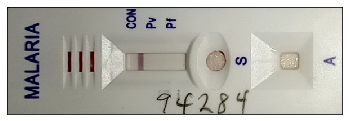

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


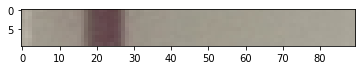

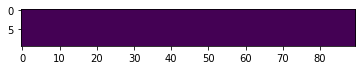

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [8.]


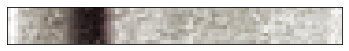

(10, 90, 3)


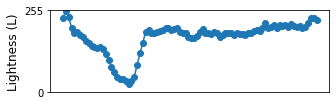

Max [[ 23.  229.1  16. ]]
[True, False, False] [True, nan] 0.0 8.0
path 208 ./Ona KEMRI/patient_images/3750eef6-6ac8-43b8-9436-113a2951a0dc/9eb14562-49e4-4489-95f8-b53a35dde496.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


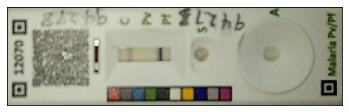

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


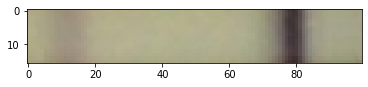

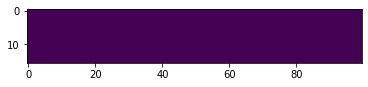

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


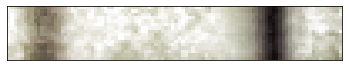

(16, 100, 3)


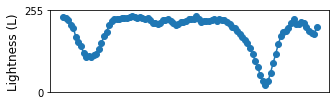

Max [[ 11.    147.625  13.   ]
 [ 79.    234.25   28.   ]]
[True, False, True] [True, 'pf'] 0.0 28.0
path 209 ./Ona KEMRI/patient_images/6982f34b-1dd9-4918-a3b0-84b2572f0a6c/92ace07d-bc1d-41b9-8906-1af4b85c84dd.JPEG experimental
Image does not exist
path 210 ./Ona KEMRI/patient_images/ed4916dd-6e42-4dd3-a950-3626f28191a6/807f72a0-c478-4bf9-9bc0-9d2fcad0c653.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


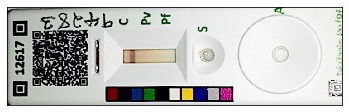

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


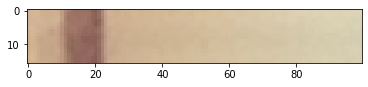

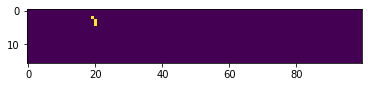

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


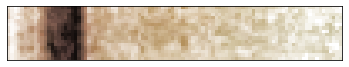

(16, 100, 3)


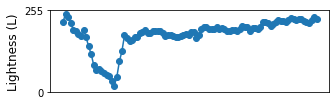

Max [[ 20.   235.75   9.  ]]
[True, False, False] [True, nan] 0.001875 15.0
path 211 ./Ona KEMRI/patient_images/ed4916dd-6e42-4dd3-a950-3626f28191a6/bf5e8217-447d-4dc5-a084-1897002d6f12.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


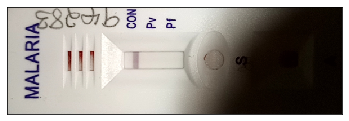

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


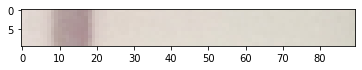

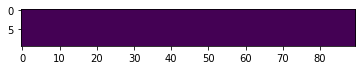

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [27.]


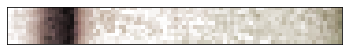

(10, 90, 3)


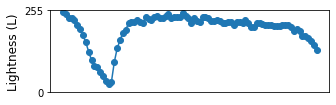

Max [[ 16.  229.4  25. ]]
[True, False, False] [True, nan] 0.0 27.0
path 212 ./Ona KEMRI/patient_images/8dd43e3c-8b1d-4c6b-aa1c-e1de39b2b59d/bdb668c2-5028-4d84-a71e-6b55fba0e188.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


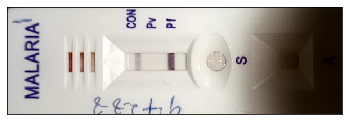

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


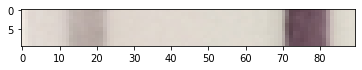

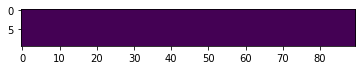

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [16.]


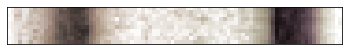

(10, 90, 3)


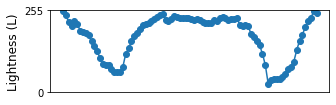

Max [[ 19.  193.4  18. ]
 [ 72.  229.9  10. ]]
[True, False, True] [True, 'pf'] 0.0 16.0
path 213 ./Ona KEMRI/patient_images/e5a5c57c-1234-43ae-a553-393e2e900da6/95362a66-1232-4793-9e94-7c88ad8b1fb2.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


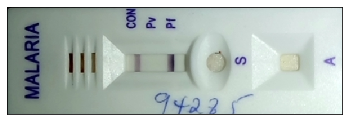

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


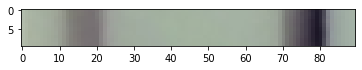

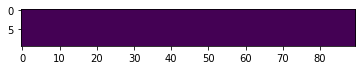

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [39.]


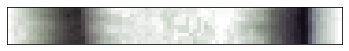

(10, 90, 3)


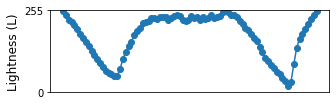

Max [[ 18.  205.3  30. ]
 [ 79.  235.4  31. ]]
[True, False, True] [True, 'pf'] 0.0 39.0
path 214 ./Ona KEMRI/patient_images/e5a5c57c-1234-43ae-a553-393e2e900da6/245a32f1-362c-481b-b433-1b8b6d1152ac.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


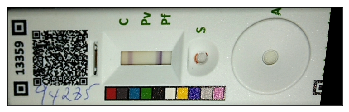

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


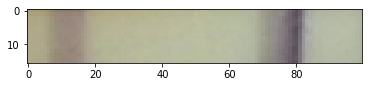

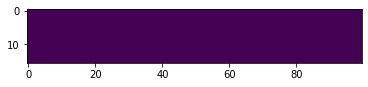

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [43.]


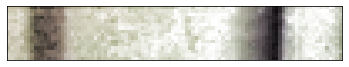

(16, 100, 3)


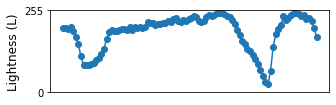

Max [[ 10.     172.125    9.    ]
 [ 80.     232.0625  24.    ]]
[True, False, True] [True, 'pf'] 0.0 43.0
path 215 ./Ona KEMRI/patient_images/a6e7513f-bc96-4f1c-b008-61d6e6e53bf4/92215a06-4fc0-4e1e-8106-76eb6980fab6.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


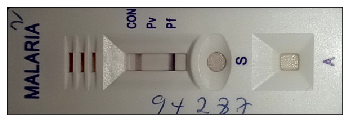

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


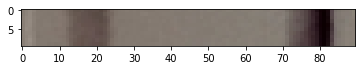

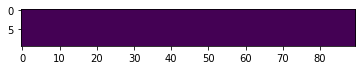

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [19.]


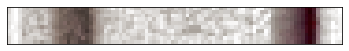

(10, 90, 3)


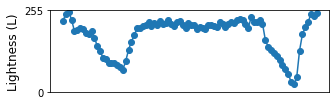

Max [[ 21.  186.1   8. ]
 [ 81.  231.6  17. ]]
[True, False, True] [True, 'pf'] 0.0 19.0
path 216 ./Ona KEMRI/patient_images/a6e7513f-bc96-4f1c-b008-61d6e6e53bf4/f692d8d7-8ee1-49a1-aecd-60c4133420b0.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


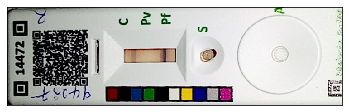

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


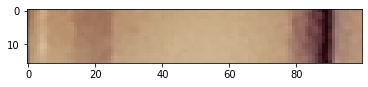

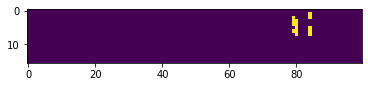

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [28.]


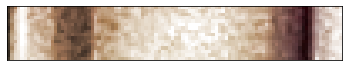

(16, 100, 3)


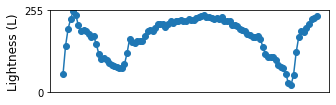

Max [[ 23.   181.5    9.  ]
 [ 89.   234.75  16.  ]]
[True, False, True] [True, 'pf'] 0.00875 28.0
path 217 ./Ona KEMRI/patient_images/8dd43e3c-8b1d-4c6b-aa1c-e1de39b2b59d/3af5a9c7-82be-43fe-9c62-e9ffbc30368d.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


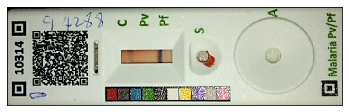

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


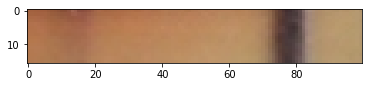

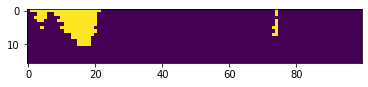

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [40.]


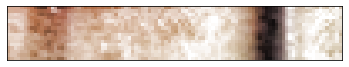

(16, 100, 3)


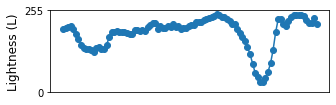

Max [[ 12.     130.5625  10.    ]
 [ 78.     224.8125  20.    ]]
[True, False, True] [True, 'pf'] 0.079375 40.0
path 218 ./Ona KEMRI/patient_images/5ad7df06-1876-4758-bd60-795282076d63/nan.JPEG nan
Image does not exist
path 219 ./Ona KEMRI/patient_images/5ad7df06-1876-4758-bd60-795282076d63/f78ea55c-f456-4cd9-a07e-72be43e71e6a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


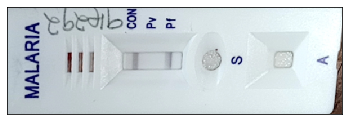

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


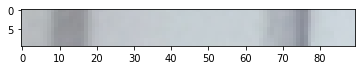

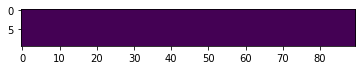

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


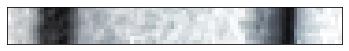

(10, 90, 3)


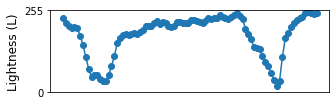

Max [[ 15.  221.7   9. ]
 [ 75.  235.6  24. ]]
[True, False, True] [True, 'pf'] 0.0 15.0
path 220 ./Ona KEMRI/patient_images/93077b30-b1be-4e84-bca2-9d2f40ef5122/e5e96f92-4ff4-4efc-accc-98389b68265a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


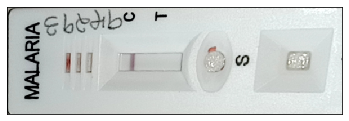

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


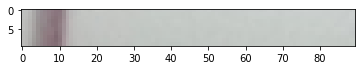

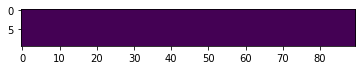

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [21.]


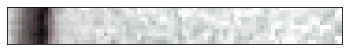

(10, 90, 3)


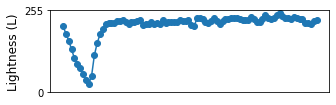

Max [[  9.  230.8  15. ]]
[True, False, False] [True, nan] 0.0 21.0
path 221 ./Ona KEMRI/patient_images/e2891898-2cb7-4db5-b6f6-293c11c2cc6f/6062dfc8-02c0-47db-9dcb-5399787cc544.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


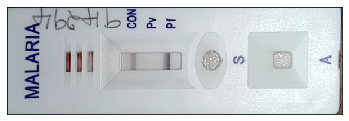

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


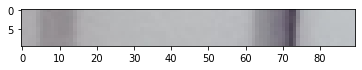

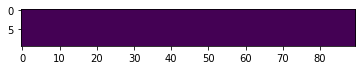

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [23.]


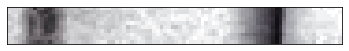

(10, 90, 3)


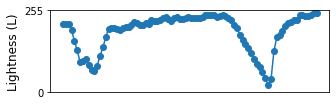

Max [[ 11.  189.1   8. ]
 [ 72.  235.   26. ]]
[True, False, True] [True, 'pf'] 0.0 23.0
path 222 ./Ona KEMRI/patient_images/93077b30-b1be-4e84-bca2-9d2f40ef5122/efb35584-7ed4-47f3-ace6-d75682451eeb.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


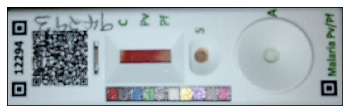

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


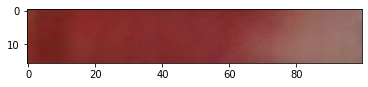

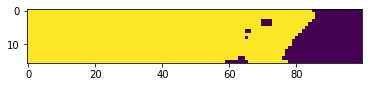

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [10.]


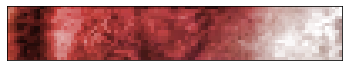

(16, 100, 3)


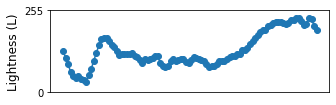

Max [[  9.  223.   10. ]
 [ 57.  177.5   6. ]]
[True, True, False] [True, nan] 0.79875 10.0
path 223 ./Ona KEMRI/patient_images/e2891898-2cb7-4db5-b6f6-293c11c2cc6f/nan.JPEG experimental
Image does not exist
path 224 ./Ona KEMRI/patient_images/e42329c6-786a-4449-980c-751891e17c6d/0a2f81eb-227c-4b94-9175-1a72bb18e0fe.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


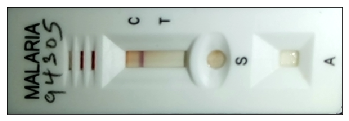

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


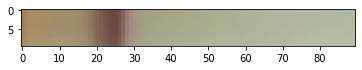

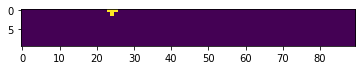

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [16.]


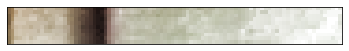

(10, 90, 3)


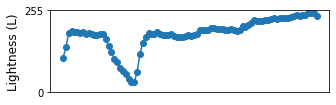

Max [[ 24. 225.  16.]]
[True, False, False] [True, nan] 0.0044444444444444444 16.0
path 225 ./Ona KEMRI/patient_images/cb7fc8cf-076c-4629-9a69-12d45d7faf51/0173eb0d-a1c2-4201-8527-4ef818bdbbcc.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


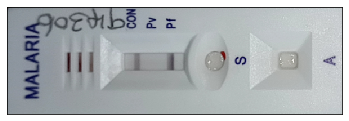

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


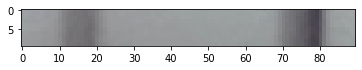

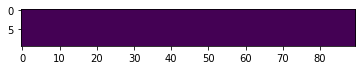

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [22.]


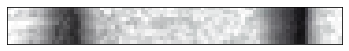

(10, 90, 3)


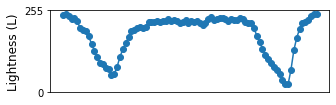

Max [[ 17.  201.3  22. ]
 [ 79.  230.9  25. ]]
[True, False, True] [True, 'pf'] 0.0 22.0
path 226 ./Ona KEMRI/patient_images/e42329c6-786a-4449-980c-751891e17c6d/nan.JPEG nan
Image does not exist
path 227 ./Ona KEMRI/patient_images/e42329c6-786a-4449-980c-751891e17c6d/6132cbbf-8916-4e92-81ee-7947a406e6ce.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


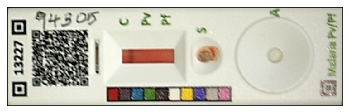

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


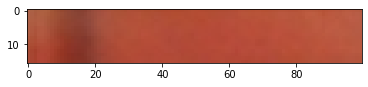

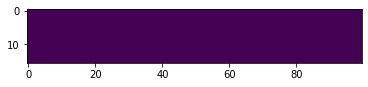

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [23.]


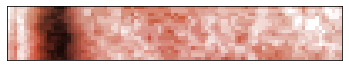

(16, 100, 3)


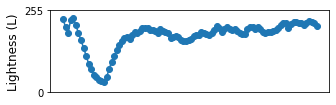

Max [[ 16.    222.875  20.   ]]
[True, False, False] [True, nan] 1.0 23.0
path 228 ./Ona KEMRI/patient_images/cb7fc8cf-076c-4629-9a69-12d45d7faf51/07e49b5c-5063-4d75-ac99-4b3478634a18.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


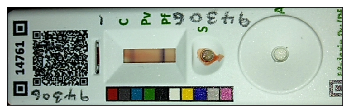

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


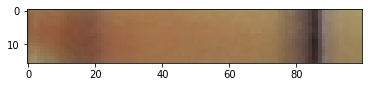

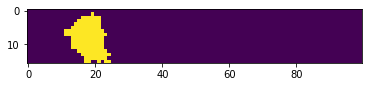

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


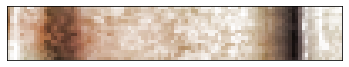

(16, 100, 3)


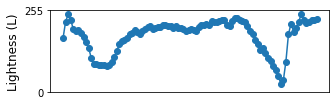

Max [[ 17.     174.125   11.    ]
 [ 85.     230.1875  10.    ]]
[True, False, True] [True, 'pf'] 0.07875 15.0
path 229 ./Ona KEMRI/patient_images/f118294f-2b47-419e-bcef-26de3277132c/f4fae303-2024-41a3-8fdc-35ed868f75d1.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


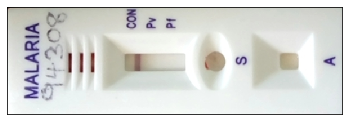

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


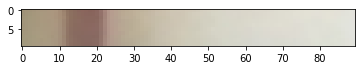

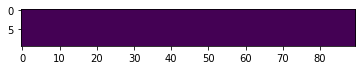

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


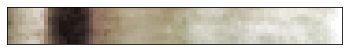

(10, 90, 3)


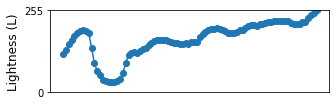

Max [[ 16.  224.7  17. ]]
[True, False, False] [True, nan] 0.0 15.0
path 230 ./Ona KEMRI/patient_images/f118294f-2b47-419e-bcef-26de3277132c/c8b31936-8e14-4de8-944a-cb54ae66b766.JPEG experimental
Image does not exist
path 231 ./Ona KEMRI/patient_images/28268ae8-658e-406c-acb3-5b9d92d0fafb/2d67ec11-0c8e-4aa2-bf30-79167089f8e5.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


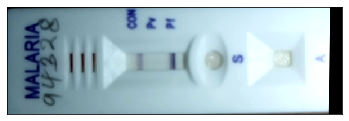

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


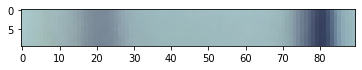

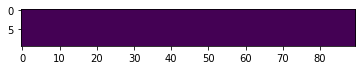

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [17.]


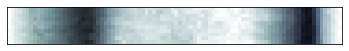

(10, 90, 3)


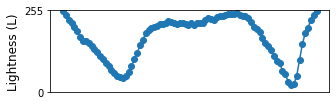

Max [[ 21.  212.2  36. ]
 [ 80.  233.   24. ]]
[True, False, True] [True, 'pf'] 0.0 17.0
path 232 ./Ona KEMRI/patient_images/28268ae8-658e-406c-acb3-5b9d92d0fafb/nan.JPEG nan
Image does not exist
path 233 ./Ona KEMRI/patient_images/28268ae8-658e-406c-acb3-5b9d92d0fafb/eef2db37-5233-4696-9cd5-6fa91a347404.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


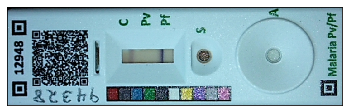

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


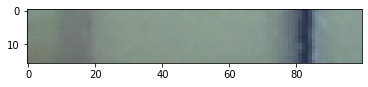

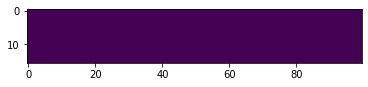

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [24.]


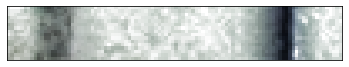

(16, 100, 3)


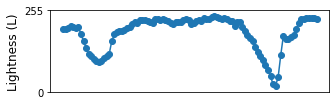

Max [[ 14.     161.9375  15.    ]
 [ 83.     236.25    16.    ]]
[True, False, True] [True, 'pf'] 0.0 24.0
path 234 ./Ona KEMRI/patient_images/9f0b6f55-941a-4f11-b83a-cbacb7a3b6c3/44f52e40-a968-436b-b11f-7c9f59d99e16.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


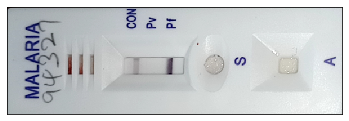

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


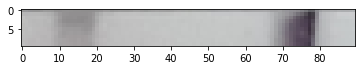

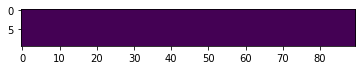

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [34.]


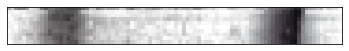

(10, 90, 3)


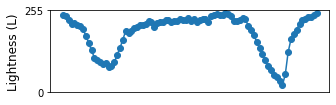

Max [[ 16.  176.8   6. ]
 [ 77.  234.4  25. ]]
[True, False, True] [True, 'pf'] 0.0 34.0
path 235 ./Ona KEMRI/patient_images/9f0b6f55-941a-4f11-b83a-cbacb7a3b6c3/7c68bf7a-29b2-4264-9f63-21f6eacfce07.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


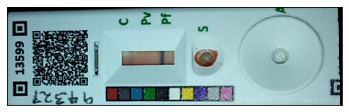

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


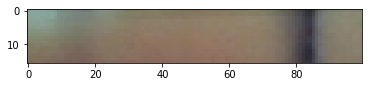

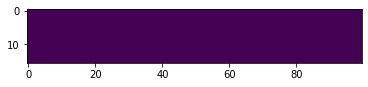

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [13.]


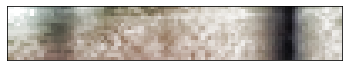

(16, 100, 3)


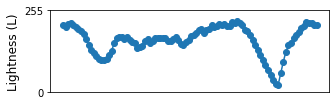

Max [[ 15.    157.     19.   ]
 [ 84.    232.875  26.   ]]
[True, False, True] [True, 'pf'] 0.0 13.0
path 236 ./Ona KEMRI/patient_images/84afb8bc-ed80-4389-b1da-2786a6d708e7/d35a281d-26f1-48bc-831c-d16f36f16b18.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


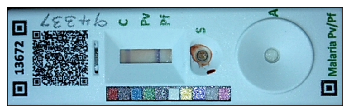

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


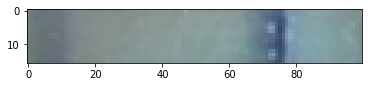

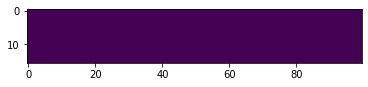

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [4.]


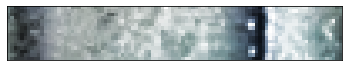

(16, 100, 3)


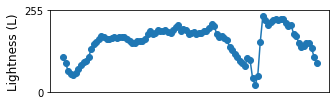

Max [[  4.     202.625   14.    ]
 [ 75.     233.4375   5.    ]]
[True, False, True] [True, 'pf'] 0.0 4.0
path 237 ./Ona KEMRI/patient_images/84afb8bc-ed80-4389-b1da-2786a6d708e7/02b2a5ca-66f8-4d2e-a7cd-2a14952c6528.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


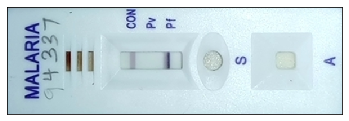

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


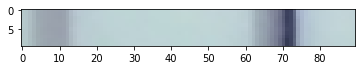

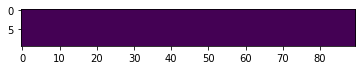

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [57.]


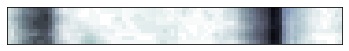

(10, 90, 3)


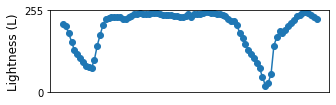

Max [[ 10.  179.9  18. ]
 [ 71.  235.3  25. ]]
[True, False, True] [True, 'pf'] 0.0 57.0
path 238 ./Ona KEMRI/patient_images/4a2923b8-d815-49ec-bfc6-12bb98e30ebc/74c6037c-6149-414c-9722-aa4cb78c1b65.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


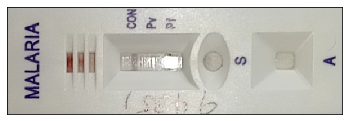

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


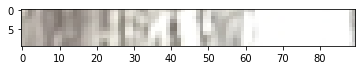

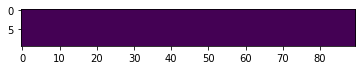

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [227.]


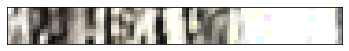

(10, 90, 3)


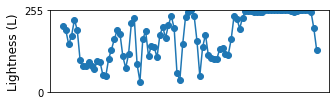

Max [[  2.  106.8   3. ]
 [ 15.  206.4   6. ]
 [ 22.  180.7   5. ]
 [ 27.  222.8   3. ]
 [ 33.  146.7   3. ]
 [ 41.  218.1   6. ]
 [ 48.  205.5   4. ]
 [ 53.  152.3   5. ]]
[True, True, False] [True, 'pf'] 0.0 227.0
path 239 ./Ona KEMRI/patient_images/4a2923b8-d815-49ec-bfc6-12bb98e30ebc/cc794cc8-7a6c-4ff5-b6c8-477ccf2b5066.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


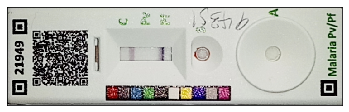

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


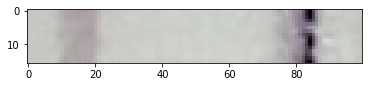

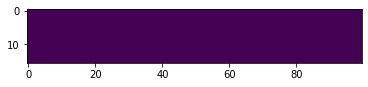

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


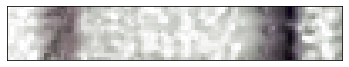

(16, 100, 3)


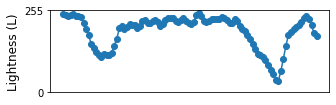

Max [[ 15.     146.125   11.    ]
 [ 84.     222.5625  27.    ]]
[True, False, True] [True, 'pf'] 0.0 46.0
path 240 ./Ona KEMRI/patient_images/d2751d68-27ae-4ac3-b07b-17d7656cdc17/4f385d4c-b0d4-41eb-874f-10676b82eac1.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


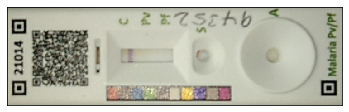

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


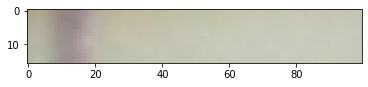

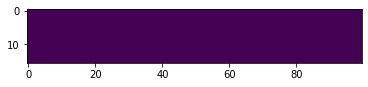

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [11.]


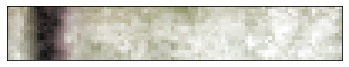

(16, 100, 3)


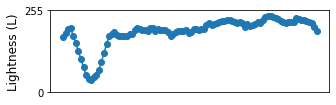

Max [[ 11.    216.625  16.   ]]
[True, False, False] [True, nan] 0.0 11.0
path 241 ./Ona KEMRI/patient_images/d2751d68-27ae-4ac3-b07b-17d7656cdc17/85051ecb-5637-471e-a640-c1dbab10462c.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


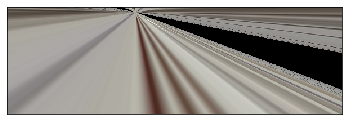

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


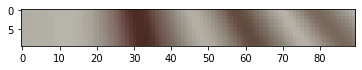

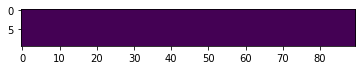

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [44.]


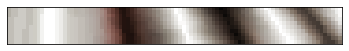

(10, 90, 3)


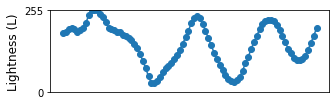

Max [[ 32.  228.6  26. ]
 [ 60.  223.   25. ]
 [ 83.  157.1  15. ]]
[False, True, True] [True, nan] 0.0 44.0
path 242 ./Ona KEMRI/patient_images/f8d358a0-aa2e-474e-84c2-1004951fb398/2b1f5170-e17f-444c-842b-4c1c989ac2df.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


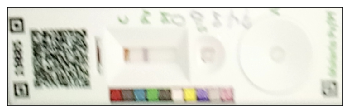

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


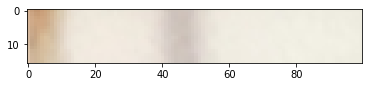

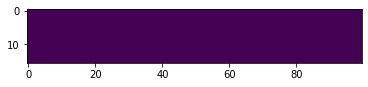

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [85.]


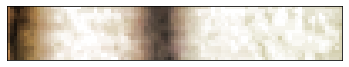

(16, 100, 3)


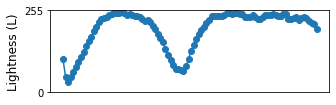

Max [[  2.     224.25    22.    ]
 [ 47.     190.4375  25.    ]]
[True, True, False] [True, nan] 0.0 85.0
path 243 ./Ona KEMRI/patient_images/f8d358a0-aa2e-474e-84c2-1004951fb398/ddc4e2c6-733b-4ac4-ae83-6effd5c506d9.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


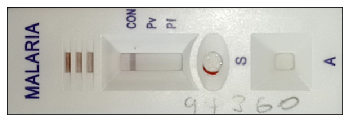

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


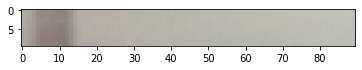

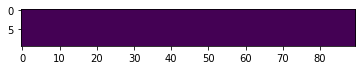

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [7.]


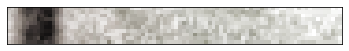

(10, 90, 3)


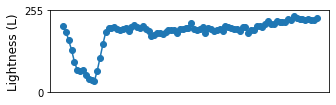

Max [[ 11.  221.6   8. ]]
[True, False, False] [True, nan] 0.0 7.0
path 244 ./Ona KEMRI/patient_images/a2228135-84e4-4815-8146-26bccd657d1a/cad25f16-544d-4123-9a9d-1ef8ab9b1956.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


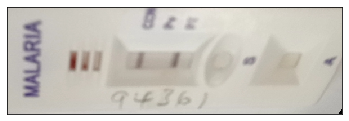

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


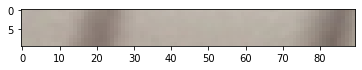

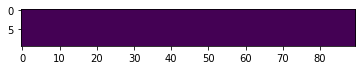

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [17.]


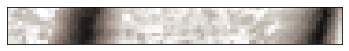

(10, 90, 3)


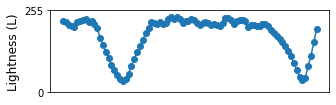

Max [[ 21.  220.7  20. ]
 [ 84.  219.3  17. ]]
[True, False, True] [True, 'pf'] 0.0 17.0
path 245 ./Ona KEMRI/patient_images/a2228135-84e4-4815-8146-26bccd657d1a/af238f83-8fca-4760-9fec-3ce8bf3e1551.JPEG experimental
Image does not exist
path 246 ./Ona KEMRI/patient_images/eb250173-48c0-47cf-b765-f0ff450b60c8/92f45281-f0ab-4c23-862c-1854b4c5294c.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


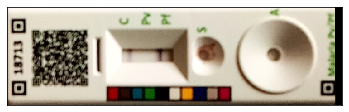

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


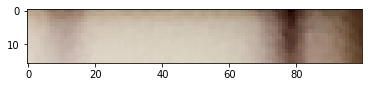

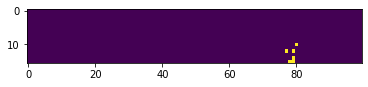

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [22.]


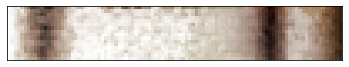

(16, 100, 3)


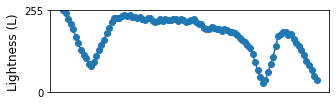

Max [[ 11.     174.1875  20.    ]
 [ 78.     227.375   19.    ]]
[True, False, True] [True, 'pf'] 0.00375 22.0
path 247 ./Ona KEMRI/patient_images/eb250173-48c0-47cf-b765-f0ff450b60c8/10c276de-2dca-416c-aa50-abb7ebeae931.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


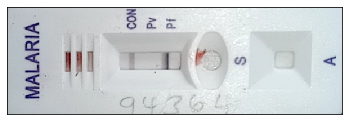

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


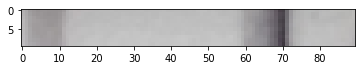

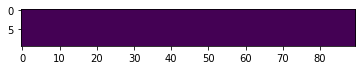

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


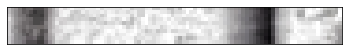

(10, 90, 3)


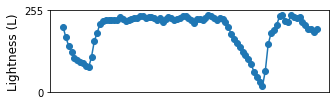

Max [[  9.  179.   14. ]
 [ 70.  237.4  21. ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 248 ./Ona KEMRI/patient_images/2a70c2fd-c0ef-4751-805e-a29cda3a7b8d/de54f134-3217-423c-9e94-099a0c103376.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


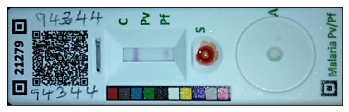

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


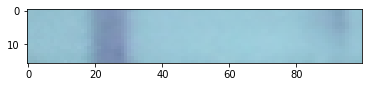

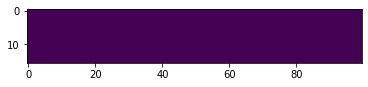

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [17.]


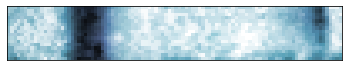

(16, 100, 3)


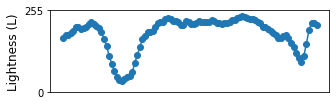

Max [[ 23.    221.625  21.   ]
 [ 93.    160.5    10.   ]]
[True, False, True] [True, 'pf'] 0.0 17.0
path 249 ./Ona KEMRI/patient_images/2a70c2fd-c0ef-4751-805e-a29cda3a7b8d/ccace21e-5a2f-4788-bd47-ea6d16634e0f.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


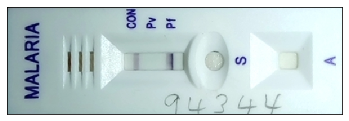

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


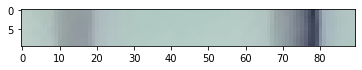

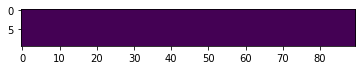

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [52.]


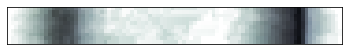

(10, 90, 3)


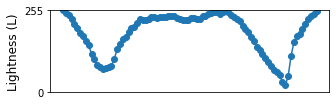

Max [[ 14.  182.5  26. ]
 [ 78.  235.2  31. ]]
[True, False, True] [True, 'pf'] 0.0 52.0
path 250 ./Ona KEMRI/patient_images/d6fec2c2-ca73-45cc-8d64-1ac7655efda4/3c44beb0-0dd7-4bda-8bd3-dc7daa666a9a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


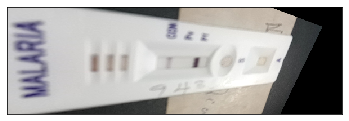

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


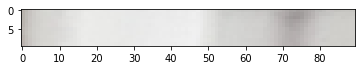

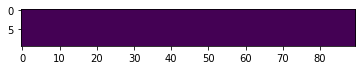

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [9.]


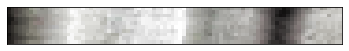

(10, 90, 3)


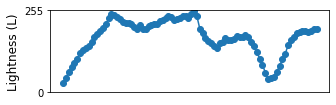

Max [[ 72.  214.6  20. ]]
[False, False, True] [True, 'pf'] 0.0 9.0
path 251 ./Ona KEMRI/patient_images/d6fec2c2-ca73-45cc-8d64-1ac7655efda4/9d6dc54e-7819-44e1-a273-ce96cdeb9884.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


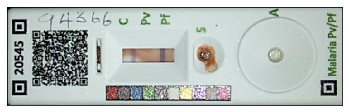

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


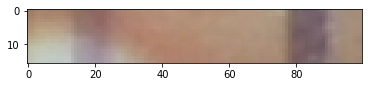

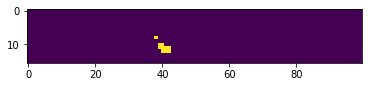

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [10.]


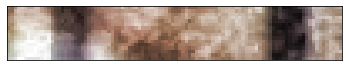

(16, 100, 3)


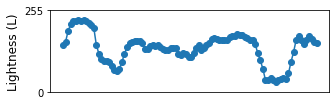

Max [[ 21.     189.875   20.    ]
 [ 83.     225.4375   4.    ]]
[True, False, True] [True, 'pf'] 0.00625 10.0
path 252 ./Ona KEMRI/patient_images/9641739f-a7db-4ee9-a35d-4da2e5665485/nan.JPEG nan
Image does not exist
path 253 ./Ona KEMRI/patient_images/c9db6505-3929-402f-a982-e093f3909b4e/52569521-b214-4722-9470-abcf4c5f9d25.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


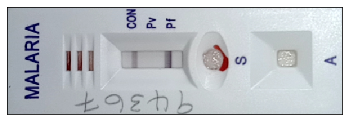

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


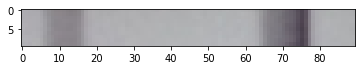

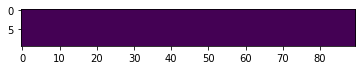

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [37.]


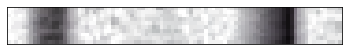

(10, 90, 3)


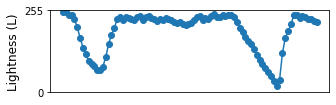

Max [[ 13.  187.6  19. ]
 [ 75.  236.8  22. ]]
[True, False, True] [True, 'pf'] 0.0 37.0
path 254 ./Ona KEMRI/patient_images/93ef55b1-54d4-49b7-a4cb-379dfe0f8c50/c6c45b80-0fea-4cc5-b43d-70596e6f018a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


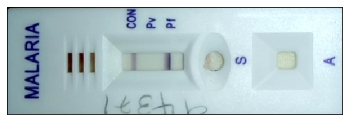

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


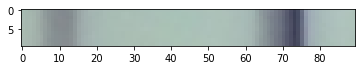

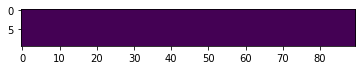

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [35.]


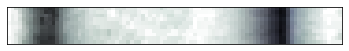

(10, 90, 3)


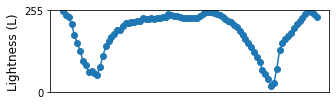

Max [[ 12.  202.4  17. ]
 [ 73.  236.4  34. ]]
[True, False, True] [True, 'pf'] 0.0 35.0
path 255 ./Ona KEMRI/patient_images/9641739f-a7db-4ee9-a35d-4da2e5665485/ff106f84-b259-46a3-9ca7-f8dd68e2dd37.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


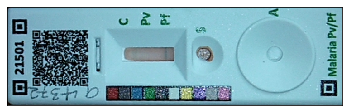

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


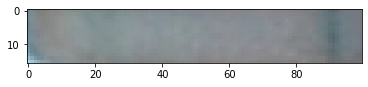

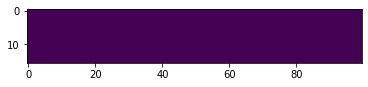

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [1.]


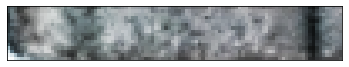

(16, 100, 3)


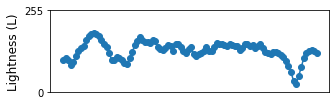

Max [[  3.    170.375  10.   ]
 [ 25.    166.5     8.   ]
 [ 91.    230.375  14.   ]]
[True, False, True] [True, 'pf'] 0.0 1.0
path 256 ./Ona KEMRI/patient_images/9641739f-a7db-4ee9-a35d-4da2e5665485/2d6bb5b9-395c-4130-82a3-e8ece3c5c649.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


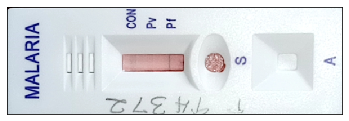

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


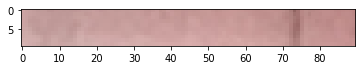

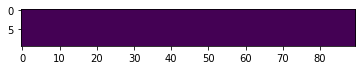

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [9.]


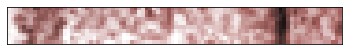

(10, 90, 3)


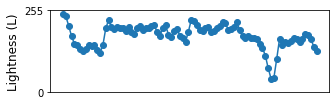

Max [[ 13.  132.3   4. ]
 [ 43.   98.7   4. ]
 [ 73.  213.8  10. ]]
[True, True, True] [True, 'pf'] 0.0 9.0
path 257 ./Ona KEMRI/patient_images/c9db6505-3929-402f-a982-e093f3909b4e/453cf870-031c-49f9-8c9a-34068653ee8a.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


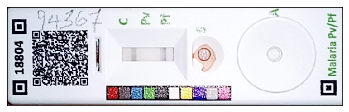

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


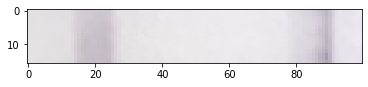

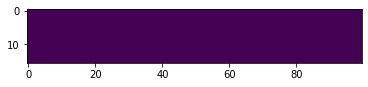

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [30.]


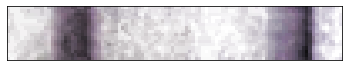

(16, 100, 3)


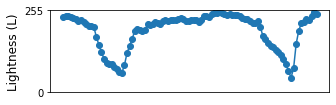

Max [[ 23.     195.4375  21.    ]
 [ 89.     211.1875  18.    ]]
[True, False, True] [True, 'pf'] 0.0 30.0
path 258 ./Ona KEMRI/patient_images/93ef55b1-54d4-49b7-a4cb-379dfe0f8c50/723c615b-3290-460f-a422-8a130bd48361.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


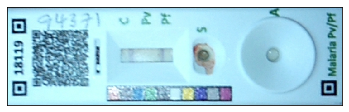

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


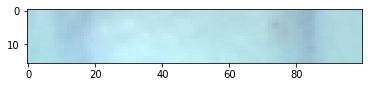

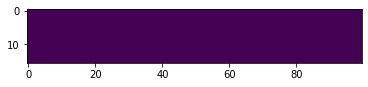

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [15.]


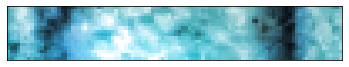

(16, 100, 3)


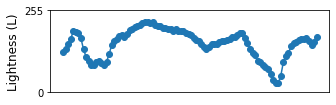

Max [[ 12.   172.25   9.  ]
 [ 84.   227.75  24.  ]]
[True, False, True] [True, 'pf'] 0.0 15.0
path 259 ./Ona KEMRI/patient_images/ee273191-f6ee-4169-870c-cfc83f544901/6d661fcb-68cd-498b-a3af-e5f25c93650a.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


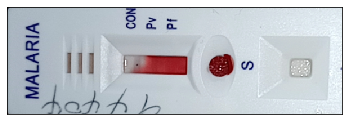

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


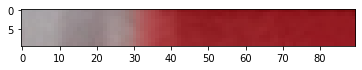

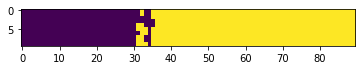

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [16.]


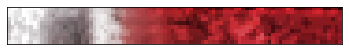

(10, 90, 3)


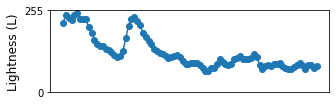

Max [[ 19.  145.8  17. ]]
[True, False, False] [True, nan] 0.6266666666666667 16.0
path 260 ./Ona KEMRI/patient_images/2468c7df-aa37-4fb5-bac7-118093ef8a18/ce1a8132-5ad5-490b-a669-0117cf47e6cd.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


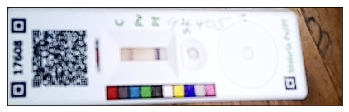

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


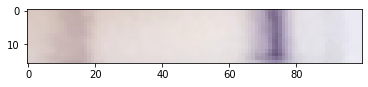

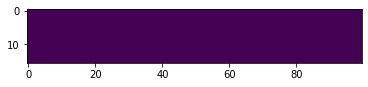

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [46.]


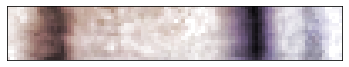

(16, 100, 3)


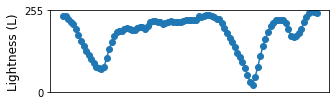

Max [[ 15.     184.625   24.    ]
 [ 74.     232.4375  26.    ]]
[True, False, True] [True, 'pf'] 0.0 46.0
path 261 ./Ona KEMRI/patient_images/2468c7df-aa37-4fb5-bac7-118093ef8a18/caf6e8fc-9229-4a2a-a3a2-dfbe2e0abc53.JPEG carestart
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


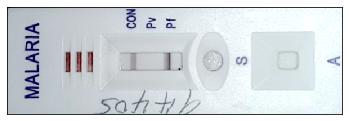

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


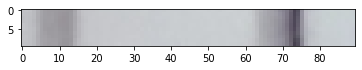

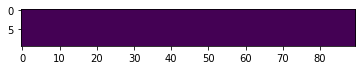

[INFO] enhanceImage (10, 90, 3)
[INFO] check glare
maxWhite 255 clipCount [41.]


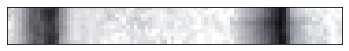

(10, 90, 3)


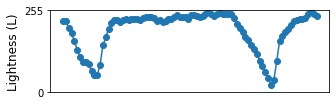

Max [[ 11.  203.3  17. ]
 [ 73.  234.6  27. ]]
[True, False, True] [True, 'pf'] 0.0 41.0
path 262 ./Ona KEMRI/patient_images/ee273191-f6ee-4169-870c-cfc83f544901/677b0a6b-5b2b-491c-a646-7c089e875935.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


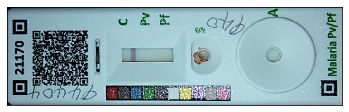

offset 0
[INFO] cropResultWindow
[INFO] detectRedColor()


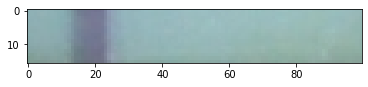

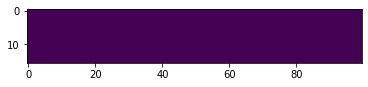

[INFO] enhanceImage (16, 100, 3)
[INFO] check glare
maxWhite 255 clipCount [2.]


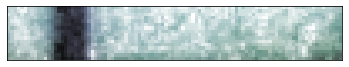

(16, 100, 3)


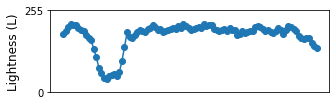

Max [[ 17.     215.0625  16.    ]]
[True, False, False] [True, nan] 0.0 2.0
path 263 ./Ona KEMRI/patient_images/a9cfcb4c-fdef-40f4-8af3-9a9e8acb3f96/efb2bf0d-d112-46ca-befd-73b61aec2012.JPEG experimental
[INFO] Finish matching
[INFO] matches
[INFO] Finish finding Homography


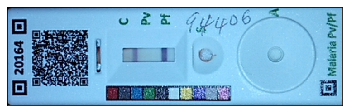

In [ ]:
results = eval(60)

In [67]:
df.to_csv('result_blood1.csv')